In [1]:
import numpy as np

%matplotlib inline
import matplotlib.pyplot as plt

In [2]:
from keras.datasets import mnist
from keras.models import Sequential, Model
from keras.layers import Dense, LeakyReLU, BatchNormalization
from keras.layers import Input, Flatten, Embedding, multiply, Dropout
from tensorflow.keras.optimizers import Adam
from keras import initializers
from keras_contrib.layers.normalization.instancenormalization import InstanceNormalization
#from keras_contrib.layers.normalization import InstanceNormalization
from keras.layers import Concatenate, GaussianNoise
from keras.layers.convolutional import UpSampling2D, Conv2D
from keras import losses
from keras.utils import to_categorical
import keras.backend as K

# from scipy.misc import imresize
from skimage.transform import resize

Using TensorFlow backend.


# 데이터 전처리

In [3]:
import os
import cv2
import re
file_lst = os.listdir('../FINAL/transformed/')
file_list_jpg = [f for f in file_lst if f.endswith(".jpg")]
X_train = []
y_train = []
for file in file_list_jpg :
    Img = cv2.imread('../FINAL/transformed/{0}'.format(file))
    Img = cv2.resize(Img, dsize=(32,32), interpolation=cv2.INTER_AREA)
    person = file.split('-')[0]
    person = int(re.findall('\d+', person)[0])
    y_train.append(person)
    X_train.append(Img)

In [4]:
X_train = np.array(X_train)
y_train = np.array(y_train)
print(X_train.shape, y_train.shape)

(300, 32, 32, 3) (300,)


In [5]:
X_train = np.float32(X_train)
X_train = (X_train / 255 - 0.5) * 2
X_train = np.clip(X_train, -1, 1)

# y to categorical
num_classes = 10
y_train = to_categorical(y_train, num_classes=num_classes+1)

print('X_train reshape:', X_train.shape)
print('y_train reshape:', y_train.shape)

X_train reshape: (300, 32, 32, 3)
y_train reshape: (300, 11)


In [6]:
X_train = resize(X_train, [X_train.shape[0], 32, 32, 3])
print('X_train reshape:', X_train.shape)

X_train reshape: (300, 32, 32, 3)


In [7]:
# Number of filters in first layer of generator
gf = 32
k = 4
s = 2

# imagem shape 28x28x1
img_shape = X_train[0].shape

# Generator input
img_g = Input(shape=(img_shape))

# Downsampling
d1 = Conv2D(gf, kernel_size=k, strides=s, padding='same')(img_g)
d1 = LeakyReLU(alpha=0.2)(d1)

d2 = Conv2D(gf*2, kernel_size=k, strides=s, padding='same')(d1)
d2 = LeakyReLU(alpha=0.2)(d2)
d2 = BatchNormalization(momentum=0.8)(d2)

d3 = Conv2D(gf*4, kernel_size=k, strides=s, padding='same')(d2)
d3 = LeakyReLU(alpha=0.2)(d3)
d3 = BatchNormalization(momentum=0.8)(d3)

d4 = Conv2D(gf*8, kernel_size=k, strides=s, padding='same')(d3)
d4 = LeakyReLU(alpha=0.2)(d4)
d4 = BatchNormalization(momentum=0.8)(d4)

# Upsampling
u1 = UpSampling2D(size=2)(d4)
u1 = Conv2D(gf*4, kernel_size=k, strides=1, padding='same', activation='relu')(u1)
u1 = BatchNormalization(momentum=0.8)(u1)

u2 = Concatenate()([u1, d3])
u2 = UpSampling2D(size=2)(u2)
u2 = Conv2D(gf*2, kernel_size=k, strides=1, padding='same', activation='relu')(u2)
u2 = BatchNormalization(momentum=0.8)(u2)

u3 = Concatenate()([u2, d2])
u3 = UpSampling2D(size=2)(u3)
u3 = Conv2D(gf, kernel_size=k, strides=1, padding='same', activation='relu')(u3)
u3 = BatchNormalization(momentum=0.8)(u3)

u4 = Concatenate()([u3, d1])
u4 = UpSampling2D(size=2)(u4)
u4 = Conv2D(3, kernel_size=4, strides=1, padding='same', activation='tanh')(u4)

generator = Model(img_g, u4)

In [8]:
# prints a summary representation of your model
generator.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 32, 32, 3)    0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 16, 16, 32)   1568        input_1[0][0]                    
__________________________________________________________________________________________________
leaky_re_lu_1 (LeakyReLU)       (None, 16, 16, 32)   0           conv2d_1[0][0]                   
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 8, 8, 64)     32832       leaky_re_lu_1[0][0]              
____________________________________________________________________________________________

In [9]:
optimizer = Adam(0.0002, 0.5)
generator.compile(loss='binary_crossentropy', optimizer=optimizer)

In [10]:
# Discriminator network
k = 4

discriminator = Sequential()
discriminator.add(Conv2D(64, kernel_size=k, strides=2, padding='same', input_shape=img_shape))
discriminator.add(LeakyReLU(alpha=0.8))
discriminator.add(Conv2D(128, kernel_size=k, strides=2, padding='same'))
discriminator.add(LeakyReLU(alpha=0.2))
discriminator.add(InstanceNormalization())
discriminator.add(Conv2D(256, kernel_size=k, strides=2, padding='same'))
discriminator.add(LeakyReLU(alpha=0.2))
discriminator.add(InstanceNormalization())

img_d = Input(shape=img_shape)
features = discriminator(img_d)

validity = Conv2D(1, kernel_size=k, strides=1, padding='same')(features)
# validity = Flatten()(validity)
# validity = Dense(1, activation='sigmoid')(validity)

label = Flatten()(features)
label = Dense(num_classes+1, activation="softmax")(label)

discriminator = Model(img_d, [validity, label])

In [11]:
# prints a summary representation of your model
discriminator.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, 32, 32, 3)    0                                            
__________________________________________________________________________________________________
sequential_1 (Sequential)       (None, 4, 4, 256)    658884      input_2[0][0]                    
__________________________________________________________________________________________________
flatten_1 (Flatten)             (None, 4096)         0           sequential_1[1][0]               
__________________________________________________________________________________________________
conv2d_12 (Conv2D)              (None, 4, 4, 1)      4097        sequential_1[1][0]               
____________________________________________________________________________________________

In [12]:
discriminator.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])

In [13]:
# Optimizer
optimizer = Adam(lr=0.0002, beta_1=0.5)

discriminator.compile(optimizer=optimizer, loss=['mse', 'categorical_crossentropy'],
                      loss_weights=[0.5, 0.5], metrics=['accuracy'])

In [14]:
# The generator takes noise as input and generates imgs
masked_img = Input(shape=(img_shape))
gen_img = generator(masked_img)

# For the combined model we will only train the generator
discriminator.trainable = False

validity, _ = discriminator(gen_img)

d_g = Model(masked_img, validity)

d_g.compile(optimizer=optimizer, loss='mse', metrics=['accuracy'])

In [15]:
# prints a summary representation of your model
d_g.summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         (None, 32, 32, 3)         0         
_________________________________________________________________
model_1 (Model)              (None, 32, 32, 3)         1548099   
_________________________________________________________________
model_2 (Model)              [(None, 4, 4, 1), (None,  708048    
Total params: 2,256,147
Trainable params: 1,546,755
Non-trainable params: 709,392
_________________________________________________________________


In [61]:
'''
def mask_randomly(imgs, mask_width=10, mask_height=10):
    y1 = np.random.randint(0, imgs.shape[1] - mask_height, imgs.shape[0])
    y2 = y1 + mask_height
    x1 = np.random.randint(0, imgs.shape[2] - mask_width, imgs.shape[0])
    x2 = x1 + mask_width

    masked_imgs = np.empty_like(imgs)
    for i, img in enumerate(imgs):
        masked_img = img.copy()
        _y1, _y2, _x1, _x2 = y1[i], y2[i], x1[i], x2[i],
        masked_img[_y1:_y2, _x1:_x2, :] = 0
        masked_imgs[i] = masked_img

    return masked_imgs
'''

'\ndef mask_randomly(imgs, mask_width=10, mask_height=10):\n    y1 = np.random.randint(0, imgs.shape[1] - mask_height, imgs.shape[0])\n    y2 = y1 + mask_height\n    x1 = np.random.randint(0, imgs.shape[2] - mask_width, imgs.shape[0])\n    x2 = x1 + mask_width\n\n    masked_imgs = np.empty_like(imgs)\n    for i, img in enumerate(imgs):\n        masked_img = img.copy()\n        _y1, _y2, _x1, _x2 = y1[i], y2[i], x1[i], x2[i],\n        masked_img[_y1:_y2, _x1:_x2, :] = 0\n        masked_imgs[i] = masked_img\n\n    return masked_imgs\n'

In [16]:
def mask_randomly(imgs, real_labels):
    masked_imgs = np.empty_like(imgs)
    for i, label in enumerate(real_labels):
        masked_img = cv2.imread('../FINAL/transformed/test/mask{0}_test_result.jpg'.format(np.argmax(label)))
        masked_img = cv2.cvtColor(masked_img, cv2.COLOR_BGR2RGB)
        masked_img = resize(masked_img, (32, 32, 3))
        #masked_img = cv2.resize(masked_img, dsize=(32,32), interpolation=cv2.INTER_AREA)
        masked_imgs[i] = masked_img

    return masked_imgs

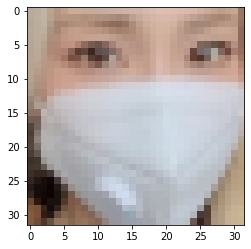

In [17]:
plt.imshow(mask_randomly(X_train[0:1], y_train[0:1])[0].reshape(32, 32, 3))
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1/5000, d_loss=0.003, g_loss=0.012                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


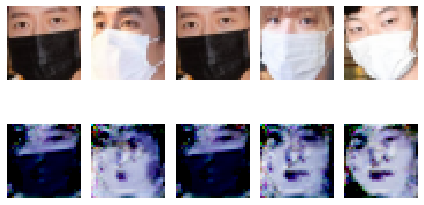

epoch = 2/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 3/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 4/5000, d_loss=0.002, g_loss=0.006                                                                                                                   
epoch = 5/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 6/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 7/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 8/5000, d_loss=0.001, g_loss=0.005          

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 11/5000, d_loss=0.001, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


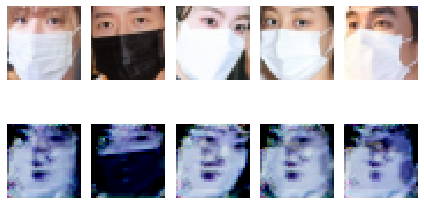

epoch = 12/5000, d_loss=0.002, g_loss=0.011                                                                                                                   
epoch = 13/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 14/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 15/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 16/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 17/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 18/5000, d_loss=0.000, g_loss=0.002   

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 21/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


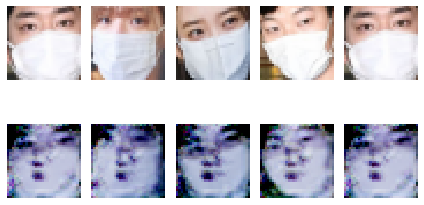

epoch = 22/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 23/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 24/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 25/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 26/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 27/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 28/5000, d_loss=0.000, g_loss=0.002   

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 31/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


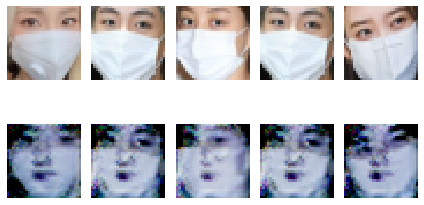

epoch = 32/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 33/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 34/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 35/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 36/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 37/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 38/5000, d_loss=0.001, g_loss=0.002   

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 41/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


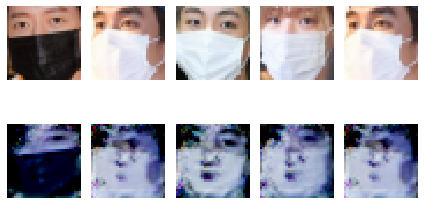

epoch = 42/5000, d_loss=0.002, g_loss=0.006                                                                                                                   
epoch = 43/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 44/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 45/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 46/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 47/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 48/5000, d_loss=0.002, g_loss=0.009   

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 51/5000, d_loss=0.002, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


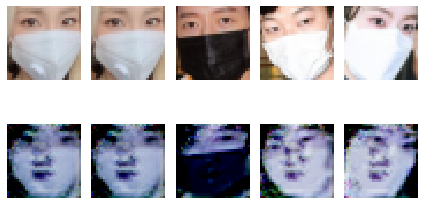

epoch = 52/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 53/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 54/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 55/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 56/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 57/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 58/5000, d_loss=0.001, g_loss=0.004   

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 61/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


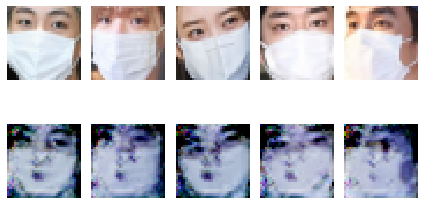

epoch = 62/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 63/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 64/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 65/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 66/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 67/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 68/5000, d_loss=0.001, g_loss=0.002   

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 71/5000, d_loss=0.002, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


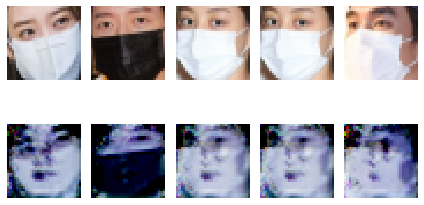

epoch = 72/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 73/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 74/5000, d_loss=0.003, g_loss=0.006                                                                                                                   
epoch = 75/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 76/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 77/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 78/5000, d_loss=0.003, g_loss=0.028   

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 81/5000, d_loss=0.002, g_loss=0.011                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


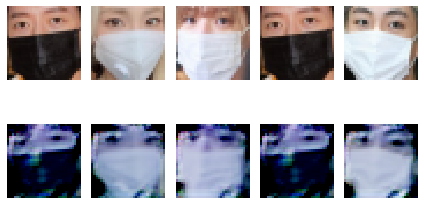

epoch = 82/5000, d_loss=0.002, g_loss=0.010                                                                                                                   
epoch = 83/5000, d_loss=0.004, g_loss=0.013                                                                                                                   
epoch = 84/5000, d_loss=0.002, g_loss=0.008                                                                                                                   
epoch = 85/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 86/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 87/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 88/5000, d_loss=0.001, g_loss=0.006   

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 91/5000, d_loss=0.000, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


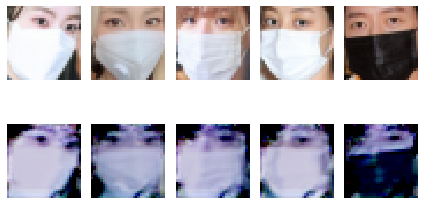

epoch = 92/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 93/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 94/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 95/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 96/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 97/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 98/5000, d_loss=0.001, g_loss=0.004   

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 101/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


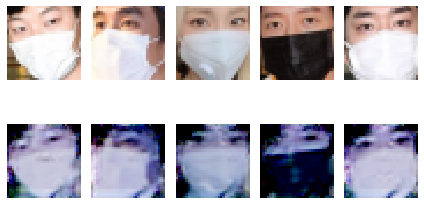

epoch = 102/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 103/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 104/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 105/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 106/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 107/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 108/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 111/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


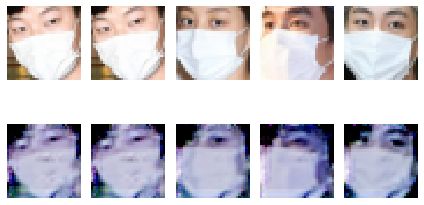

epoch = 112/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 113/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 114/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 115/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 116/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 117/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 118/5000, d_loss=0.002, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 121/5000, d_loss=0.000, g_loss=0.002                                                                                                     


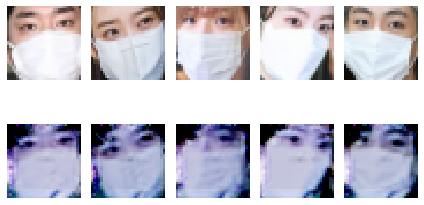

epoch = 122/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 123/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 124/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 125/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 126/5000, d_loss=0.002, g_loss=0.006                                                                                                                   
epoch = 127/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 128/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 131/5000, d_loss=0.002, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


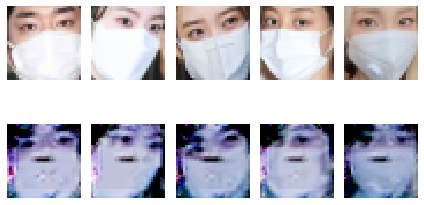

epoch = 132/5000, d_loss=0.003, g_loss=0.006                                                                                                                   
epoch = 133/5000, d_loss=0.003, g_loss=0.010                                                                                                                   
epoch = 134/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 135/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 136/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 137/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 138/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 141/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


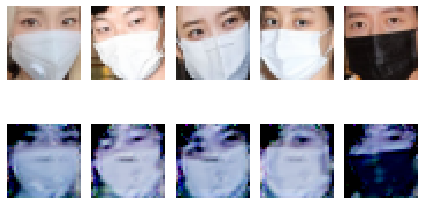

epoch = 142/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 143/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 144/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 145/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 146/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 147/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 148/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 151/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


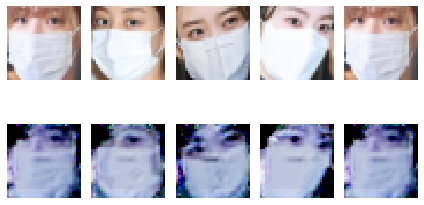

epoch = 152/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 153/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 154/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 155/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 156/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 157/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 158/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 161/5000, d_loss=0.002, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


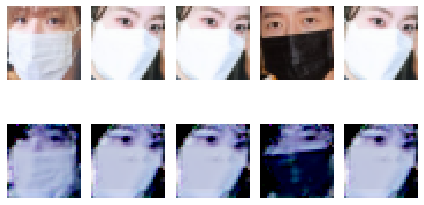

epoch = 162/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 163/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 164/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 165/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 166/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 167/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 168/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 171/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


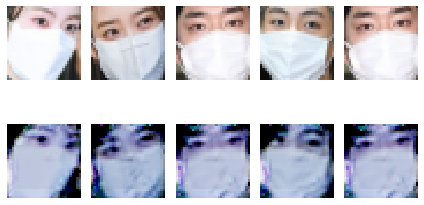

epoch = 172/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 173/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 174/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 175/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 176/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 177/5000, d_loss=0.003, g_loss=0.008                                                                                                                   
epoch = 178/5000, d_loss=0.011, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 181/5000, d_loss=0.002, g_loss=0.006                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


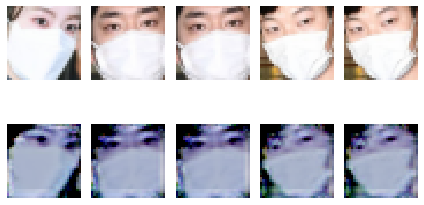

epoch = 182/5000, d_loss=0.004, g_loss=0.012                                                                                                                   
epoch = 183/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 184/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 185/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 186/5000, d_loss=0.002, g_loss=0.006                                                                                                                   
epoch = 187/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 188/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 191/5000, d_loss=0.009, g_loss=0.015                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


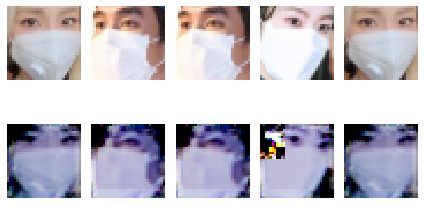

epoch = 192/5000, d_loss=0.002, g_loss=0.006                                                                                                                   
epoch = 193/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 194/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 195/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 196/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 197/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 198/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 201/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


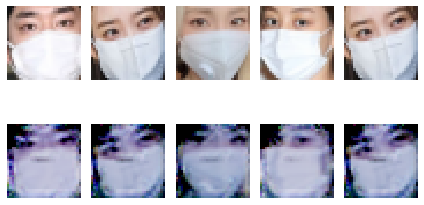

epoch = 202/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 203/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 204/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 205/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 206/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 207/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 208/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 211/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


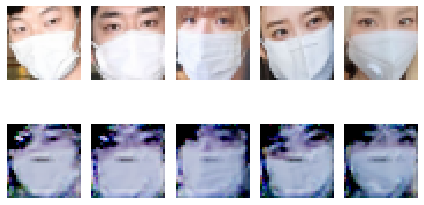

epoch = 212/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 213/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 214/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 215/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 216/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 217/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 218/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 221/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


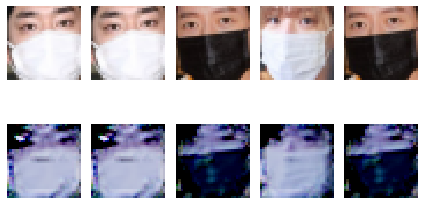

epoch = 222/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 223/5000, d_loss=0.002, g_loss=0.008                                                                                                                   
epoch = 224/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 225/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 226/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 227/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 228/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 231/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


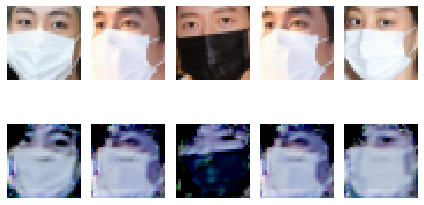

epoch = 232/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 233/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 234/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 235/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 236/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 237/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 238/5000, d_loss=0.004, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 241/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


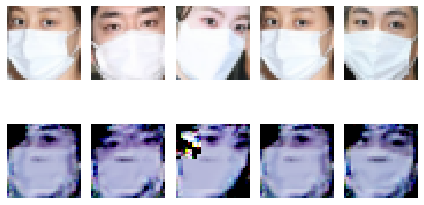

epoch = 242/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 243/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 244/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 245/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 246/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 247/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 248/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 251/5000, d_loss=0.000, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


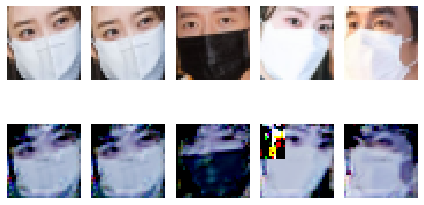

epoch = 252/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 253/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 254/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 255/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 256/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 257/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 258/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 261/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


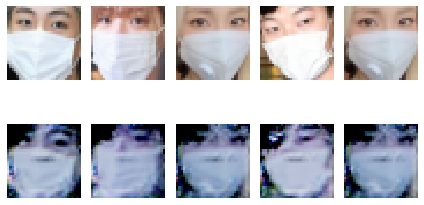

epoch = 262/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 263/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 264/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 265/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 266/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 267/5000, d_loss=0.003, g_loss=0.006                                                                                                                   
epoch = 268/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 271/5000, d_loss=0.002, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


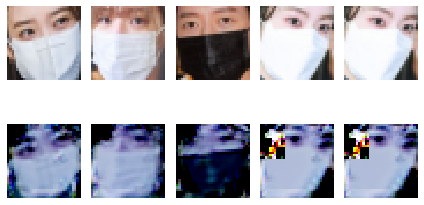

epoch = 272/5000, d_loss=0.002, g_loss=0.009                                                                                                                   
epoch = 273/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 274/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 275/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 276/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 277/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 278/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 281/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


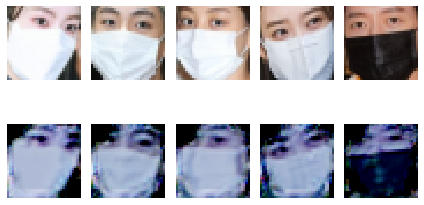

epoch = 282/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 283/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 284/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 285/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 286/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 287/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 288/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 291/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


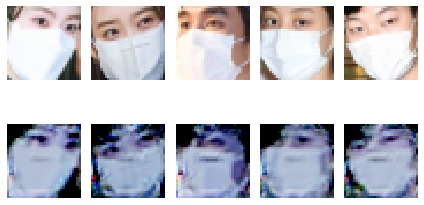

epoch = 292/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 293/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 294/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 295/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 296/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 297/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 298/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 301/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


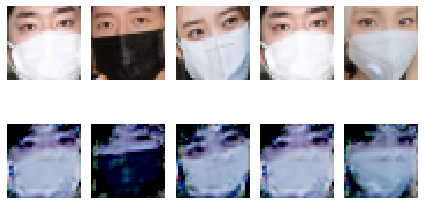

epoch = 302/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 303/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 304/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 305/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 306/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 307/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 308/5000, d_loss=0.002, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 311/5000, d_loss=0.002, g_loss=0.008                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


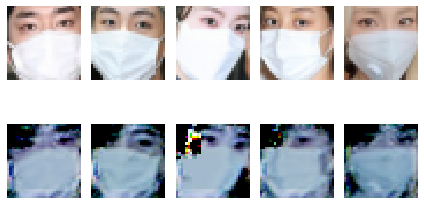

epoch = 312/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 313/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 314/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 315/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 316/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 317/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 318/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 321/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


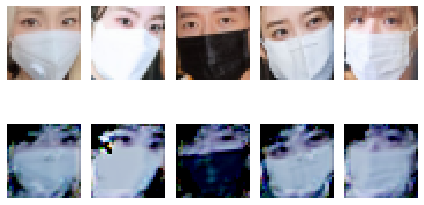

epoch = 322/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 323/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 324/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 325/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 326/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 327/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 328/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 331/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


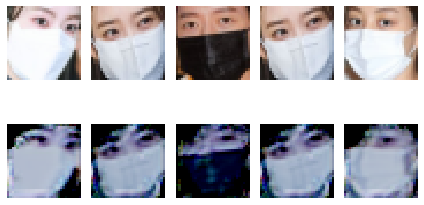

epoch = 332/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 333/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 334/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 335/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 336/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 337/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 338/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 341/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


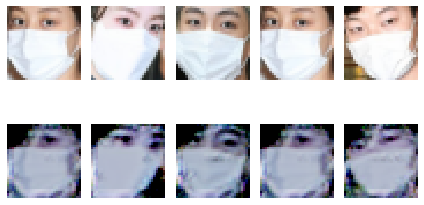

epoch = 342/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 343/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 344/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 345/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 346/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 347/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 348/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 351/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


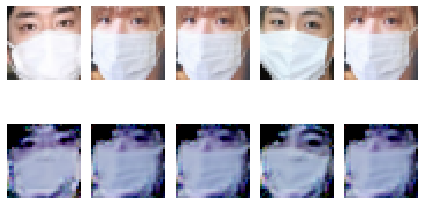

epoch = 352/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 353/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 354/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 355/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 356/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 357/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 358/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 361/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


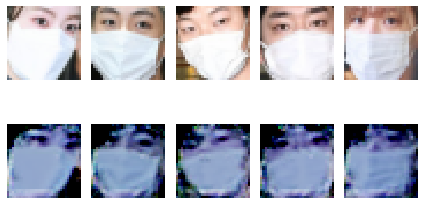

epoch = 362/5000, d_loss=0.046, g_loss=0.038                                                                                                                   
epoch = 363/5000, d_loss=0.043, g_loss=0.139                                                                                                                   
epoch = 364/5000, d_loss=0.044, g_loss=0.026                                                                                                                   
epoch = 365/5000, d_loss=0.013, g_loss=0.028                                                                                                                   
epoch = 366/5000, d_loss=0.010, g_loss=0.022                                                                                                                   
epoch = 367/5000, d_loss=0.049, g_loss=0.030                                                                                                                   
epoch = 368/5000, d_loss=0.200, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 371/5000, d_loss=0.050, g_loss=0.038                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


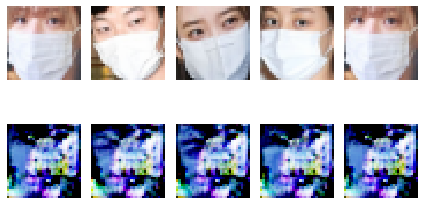

epoch = 372/5000, d_loss=0.143, g_loss=0.033                                                                                                                   
epoch = 373/5000, d_loss=0.067, g_loss=0.110                                                                                                                   
epoch = 374/5000, d_loss=0.608, g_loss=0.080                                                                                                                   
epoch = 375/5000, d_loss=0.070, g_loss=0.150                                                                                                                   
epoch = 376/5000, d_loss=0.168, g_loss=0.174                                                                                                                   
epoch = 377/5000, d_loss=0.055, g_loss=0.168                                                                                                                   
epoch = 378/5000, d_loss=0.097, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 381/5000, d_loss=0.056, g_loss=0.223                                                                                                     


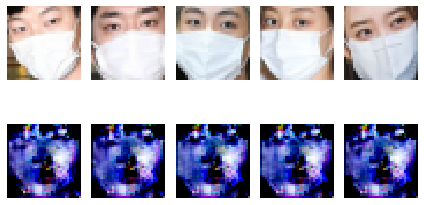

epoch = 382/5000, d_loss=0.070, g_loss=0.256                                                                                                                   
epoch = 383/5000, d_loss=0.080, g_loss=0.322                                                                                                                   
epoch = 384/5000, d_loss=0.085, g_loss=0.362                                                                                                                   
epoch = 385/5000, d_loss=0.066, g_loss=0.199                                                                                                                   
epoch = 386/5000, d_loss=0.056, g_loss=0.395                                                                                                                   
epoch = 387/5000, d_loss=0.056, g_loss=0.402                                                                                                                   
epoch = 388/5000, d_loss=0.059, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 391/5000, d_loss=0.081, g_loss=0.456                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


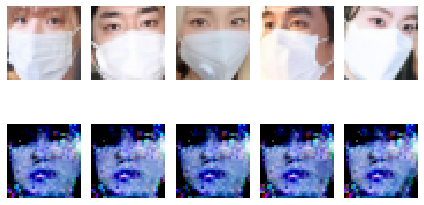

epoch = 392/5000, d_loss=0.064, g_loss=0.395                                                                                                                   
epoch = 393/5000, d_loss=0.150, g_loss=0.219                                                                                                                   
epoch = 394/5000, d_loss=0.070, g_loss=0.353                                                                                                                   
epoch = 395/5000, d_loss=0.056, g_loss=0.367                                                                                                                   
epoch = 396/5000, d_loss=0.065, g_loss=0.390                                                                                                                   
epoch = 397/5000, d_loss=0.056, g_loss=0.356                                                                                                                   
epoch = 398/5000, d_loss=0.060, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 401/5000, d_loss=0.035, g_loss=0.310                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


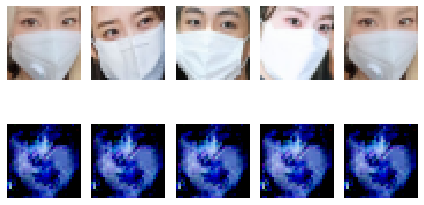

epoch = 402/5000, d_loss=0.048, g_loss=0.391                                                                                                                   
epoch = 403/5000, d_loss=0.060, g_loss=0.260                                                                                                                   
epoch = 404/5000, d_loss=0.028, g_loss=0.398                                                                                                                   
epoch = 405/5000, d_loss=0.031, g_loss=0.364                                                                                                                   
epoch = 406/5000, d_loss=0.054, g_loss=0.361                                                                                                                   
epoch = 407/5000, d_loss=0.045, g_loss=0.433                                                                                                                   
epoch = 408/5000, d_loss=0.062, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 411/5000, d_loss=0.033, g_loss=0.558                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


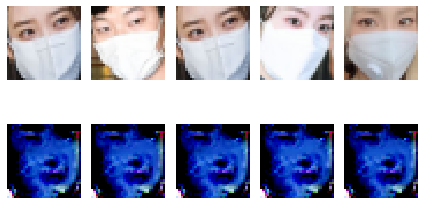

epoch = 412/5000, d_loss=0.056, g_loss=0.433                                                                                                                   
epoch = 413/5000, d_loss=0.045, g_loss=0.404                                                                                                                   
epoch = 414/5000, d_loss=0.023, g_loss=0.350                                                                                                                   
epoch = 415/5000, d_loss=0.039, g_loss=0.548                                                                                                                   
epoch = 416/5000, d_loss=0.031, g_loss=0.225                                                                                                                   
epoch = 417/5000, d_loss=0.023, g_loss=0.270                                                                                                                   
epoch = 418/5000, d_loss=0.018, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 421/5000, d_loss=0.019, g_loss=0.232                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


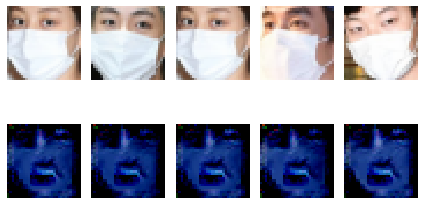

epoch = 422/5000, d_loss=0.019, g_loss=0.328                                                                                                                   
epoch = 423/5000, d_loss=0.023, g_loss=0.415                                                                                                                   
epoch = 424/5000, d_loss=0.016, g_loss=0.122                                                                                                                   
epoch = 425/5000, d_loss=0.016, g_loss=0.331                                                                                                                   
epoch = 426/5000, d_loss=0.018, g_loss=0.118                                                                                                                   
epoch = 427/5000, d_loss=0.019, g_loss=0.196                                                                                                                   
epoch = 428/5000, d_loss=0.014, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 431/5000, d_loss=0.010, g_loss=0.272                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


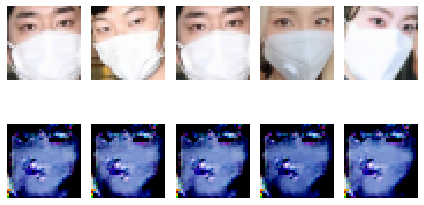

epoch = 432/5000, d_loss=0.009, g_loss=0.284                                                                                                                   
epoch = 433/5000, d_loss=0.011, g_loss=0.326                                                                                                                   
epoch = 434/5000, d_loss=0.009, g_loss=0.202                                                                                                                   
epoch = 435/5000, d_loss=0.013, g_loss=0.207                                                                                                                   
epoch = 436/5000, d_loss=0.015, g_loss=0.373                                                                                                                   
epoch = 437/5000, d_loss=0.039, g_loss=0.323                                                                                                                   
epoch = 438/5000, d_loss=0.013, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 441/5000, d_loss=0.023, g_loss=0.290                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


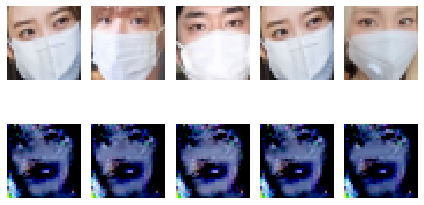

epoch = 442/5000, d_loss=0.017, g_loss=0.219                                                                                                                   
epoch = 443/5000, d_loss=0.012, g_loss=0.129                                                                                                                   
epoch = 444/5000, d_loss=0.016, g_loss=0.367                                                                                                                   
epoch = 445/5000, d_loss=0.013, g_loss=0.498                                                                                                                   
epoch = 446/5000, d_loss=0.018, g_loss=0.460                                                                                                                   
epoch = 447/5000, d_loss=0.010, g_loss=0.726                                                                                                                   
epoch = 448/5000, d_loss=0.015, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 451/5000, d_loss=0.021, g_loss=0.406                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


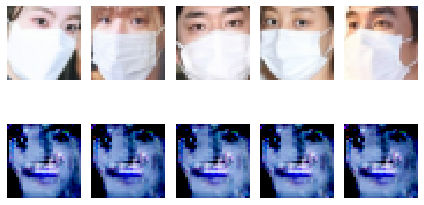

epoch = 452/5000, d_loss=0.023, g_loss=0.197                                                                                                                   
epoch = 453/5000, d_loss=0.012, g_loss=0.270                                                                                                                   
epoch = 454/5000, d_loss=0.033, g_loss=0.148                                                                                                                   
epoch = 455/5000, d_loss=0.010, g_loss=0.292                                                                                                                   
epoch = 456/5000, d_loss=0.008, g_loss=0.243                                                                                                                   
epoch = 457/5000, d_loss=0.013, g_loss=0.322                                                                                                                   
epoch = 458/5000, d_loss=0.009, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 461/5000, d_loss=0.007, g_loss=0.118                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


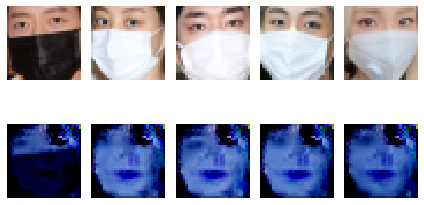

epoch = 462/5000, d_loss=0.005, g_loss=0.141                                                                                                                   
epoch = 463/5000, d_loss=0.005, g_loss=0.098                                                                                                                   
epoch = 464/5000, d_loss=0.005, g_loss=0.097                                                                                                                   
epoch = 465/5000, d_loss=0.005, g_loss=0.086                                                                                                                   
epoch = 466/5000, d_loss=0.005, g_loss=0.069                                                                                                                   
epoch = 467/5000, d_loss=0.004, g_loss=0.062                                                                                                                   
epoch = 468/5000, d_loss=0.005, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 471/5000, d_loss=0.005, g_loss=0.074                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


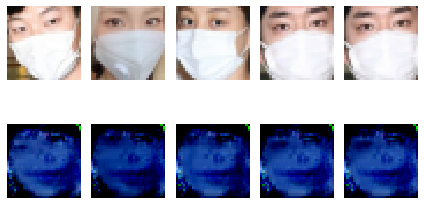

epoch = 472/5000, d_loss=0.005, g_loss=0.075                                                                                                                   
epoch = 473/5000, d_loss=0.004, g_loss=0.076                                                                                                                   
epoch = 474/5000, d_loss=0.003, g_loss=0.076                                                                                                                   
epoch = 475/5000, d_loss=0.003, g_loss=0.076                                                                                                                   
epoch = 476/5000, d_loss=0.003, g_loss=0.074                                                                                                                   
epoch = 477/5000, d_loss=0.003, g_loss=0.076                                                                                                                   
epoch = 478/5000, d_loss=0.003, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 481/5000, d_loss=0.003, g_loss=0.032                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


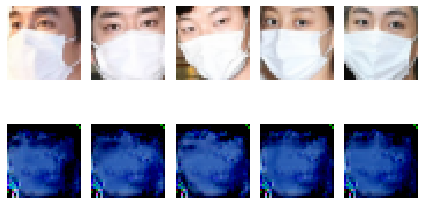

epoch = 482/5000, d_loss=0.002, g_loss=0.041                                                                                                                   
epoch = 483/5000, d_loss=0.002, g_loss=0.031                                                                                                                   
epoch = 484/5000, d_loss=0.003, g_loss=0.037                                                                                                                   
epoch = 485/5000, d_loss=0.004, g_loss=0.027                                                                                                                   
epoch = 486/5000, d_loss=0.003, g_loss=0.028                                                                                                                   
epoch = 487/5000, d_loss=0.003, g_loss=0.028                                                                                                                   
epoch = 488/5000, d_loss=0.002, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 491/5000, d_loss=0.002, g_loss=0.023                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


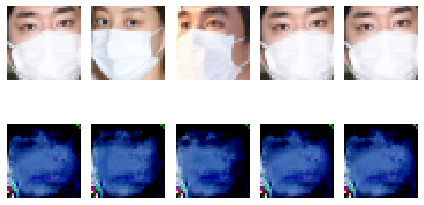

epoch = 492/5000, d_loss=0.002, g_loss=0.019                                                                                                                   
epoch = 493/5000, d_loss=0.002, g_loss=0.019                                                                                                                   
epoch = 494/5000, d_loss=0.002, g_loss=0.024                                                                                                                   
epoch = 495/5000, d_loss=0.002, g_loss=0.019                                                                                                                   
epoch = 496/5000, d_loss=0.003, g_loss=0.018                                                                                                                   
epoch = 497/5000, d_loss=0.002, g_loss=0.023                                                                                                                   
epoch = 498/5000, d_loss=0.002, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 501/5000, d_loss=0.001, g_loss=0.018                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


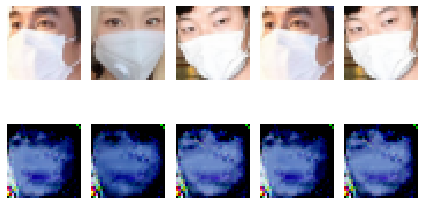

epoch = 502/5000, d_loss=0.001, g_loss=0.017                                                                                                                   
epoch = 503/5000, d_loss=0.002, g_loss=0.019                                                                                                                   
epoch = 504/5000, d_loss=0.002, g_loss=0.016                                                                                                                   
epoch = 505/5000, d_loss=0.001, g_loss=0.016                                                                                                                   
epoch = 506/5000, d_loss=0.001, g_loss=0.015                                                                                                                   
epoch = 507/5000, d_loss=0.001, g_loss=0.016                                                                                                                   
epoch = 508/5000, d_loss=0.002, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 511/5000, d_loss=0.002, g_loss=0.014                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


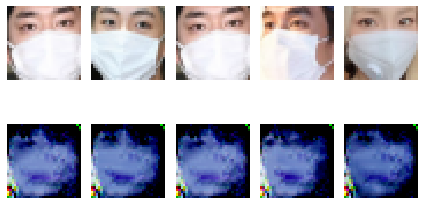

epoch = 512/5000, d_loss=0.002, g_loss=0.012                                                                                                                   
epoch = 513/5000, d_loss=0.002, g_loss=0.017                                                                                                                   
epoch = 514/5000, d_loss=0.002, g_loss=0.013                                                                                                                   
epoch = 515/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 516/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 517/5000, d_loss=0.002, g_loss=0.015                                                                                                                   
epoch = 518/5000, d_loss=0.003, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 521/5000, d_loss=0.001, g_loss=0.013                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


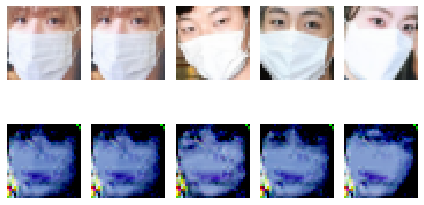

epoch = 522/5000, d_loss=0.002, g_loss=0.012                                                                                                                   
epoch = 523/5000, d_loss=0.008, g_loss=0.015                                                                                                                   
epoch = 524/5000, d_loss=0.002, g_loss=0.012                                                                                                                   
epoch = 525/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 526/5000, d_loss=0.004, g_loss=0.015                                                                                                                   
epoch = 527/5000, d_loss=0.002, g_loss=0.012                                                                                                                   
epoch = 528/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 531/5000, d_loss=0.001, g_loss=0.018                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


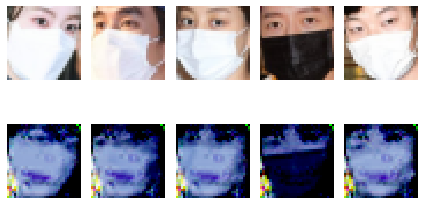

epoch = 532/5000, d_loss=0.001, g_loss=0.011                                                                                                                   
epoch = 533/5000, d_loss=0.001, g_loss=0.015                                                                                                                   
epoch = 534/5000, d_loss=0.002, g_loss=0.012                                                                                                                   
epoch = 535/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 536/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 537/5000, d_loss=0.001, g_loss=0.011                                                                                                                   
epoch = 538/5000, d_loss=0.002, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 541/5000, d_loss=0.001, g_loss=0.013                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


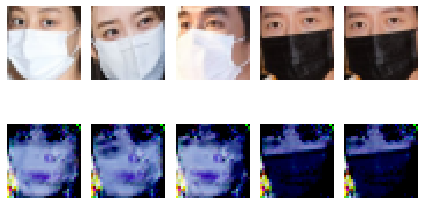

epoch = 542/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 543/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 544/5000, d_loss=0.002, g_loss=0.010                                                                                                                   
epoch = 545/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 546/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 547/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 548/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 551/5000, d_loss=0.001, g_loss=0.009                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


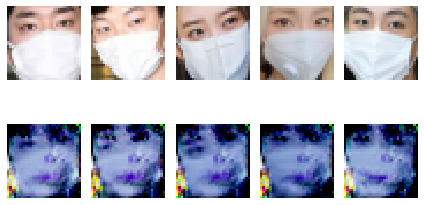

epoch = 552/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 553/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 554/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 555/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 556/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 557/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 558/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 561/5000, d_loss=0.001, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


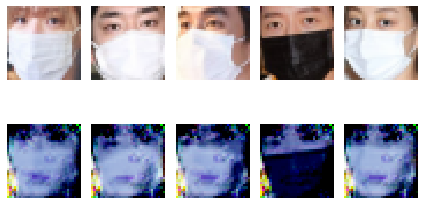

epoch = 562/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 563/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 564/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 565/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 566/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 567/5000, d_loss=0.005, g_loss=0.009                                                                                                                   
epoch = 568/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 571/5000, d_loss=0.001, g_loss=0.007                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


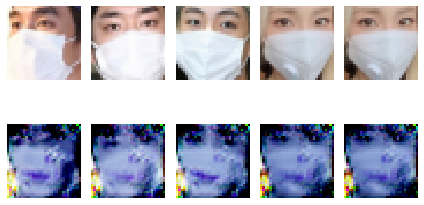

epoch = 572/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 573/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 574/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 575/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 576/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 577/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 578/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 581/5000, d_loss=0.000, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


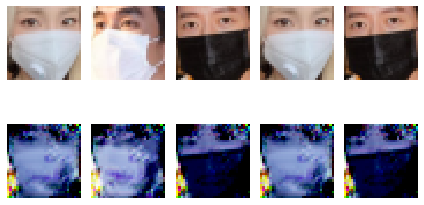

epoch = 582/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 583/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 584/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 585/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 586/5000, d_loss=0.003, g_loss=0.006                                                                                                                   
epoch = 587/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 588/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 591/5000, d_loss=0.001, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


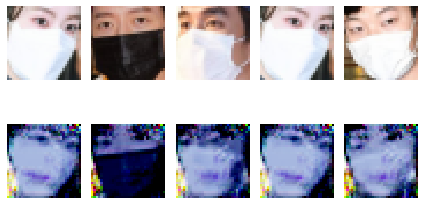

epoch = 592/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 593/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 594/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 595/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 596/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 597/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 598/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 601/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


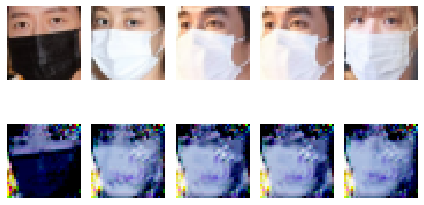

epoch = 602/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 603/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 604/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 605/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 606/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 607/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 608/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 611/5000, d_loss=0.002, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


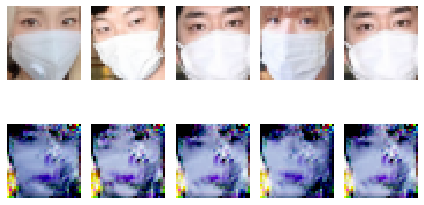

epoch = 612/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 613/5000, d_loss=0.002, g_loss=0.006                                                                                                                   
epoch = 614/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 615/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 616/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 617/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 618/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 621/5000, d_loss=0.001, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


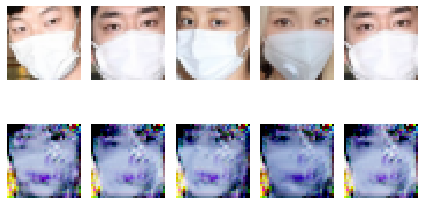

epoch = 622/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 623/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 624/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 625/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 626/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 627/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 628/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 631/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


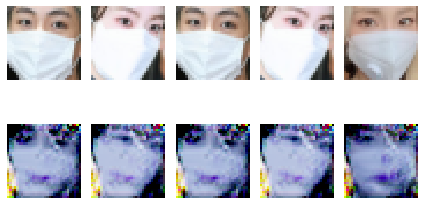

epoch = 632/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 633/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 634/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 635/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 636/5000, d_loss=0.002, g_loss=0.011                                                                                                                   
epoch = 637/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 638/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 641/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


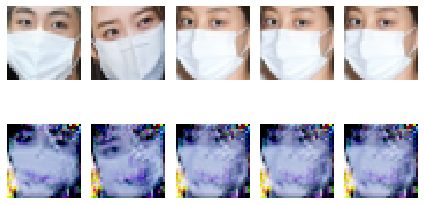

epoch = 642/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 643/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 644/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 645/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 646/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 647/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 648/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 651/5000, d_loss=0.002, g_loss=0.006                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


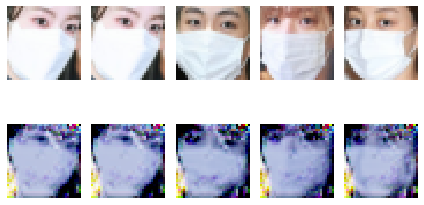

epoch = 652/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 653/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 654/5000, d_loss=0.002, g_loss=0.019                                                                                                                   
epoch = 655/5000, d_loss=0.002, g_loss=0.006                                                                                                                   
epoch = 656/5000, d_loss=0.002, g_loss=0.013                                                                                                                   
epoch = 657/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 658/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


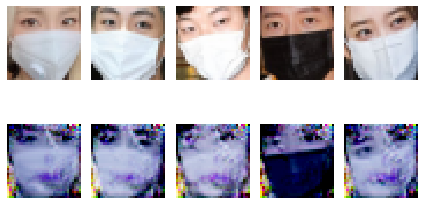

epoch = 662/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 663/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 664/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 665/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 666/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 667/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 668/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 671/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


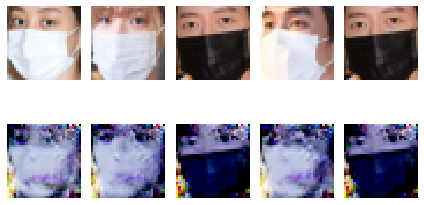

epoch = 672/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 673/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 674/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 675/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 676/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 677/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 678/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 681/5000, d_loss=0.000, g_loss=0.002                                                                                                     


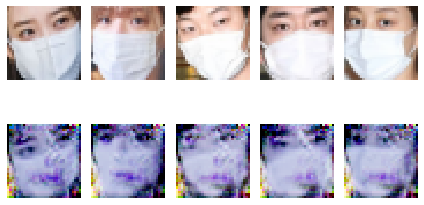

epoch = 682/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 683/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 684/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 685/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 686/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 687/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 688/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 691/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


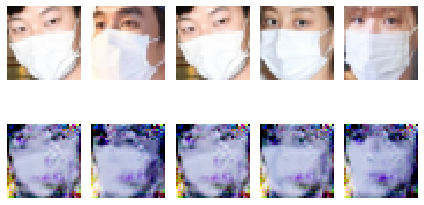

epoch = 692/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 693/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 694/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 695/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 696/5000, d_loss=0.005, g_loss=0.012                                                                                                                   
epoch = 697/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 698/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 701/5000, d_loss=0.006, g_loss=0.018                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


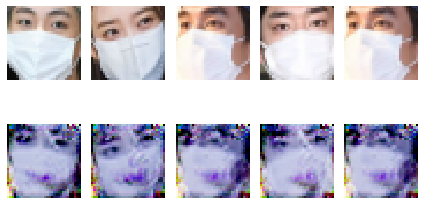

epoch = 702/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 703/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 704/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 705/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 706/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 707/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 708/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 711/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


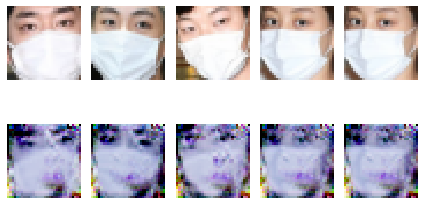

epoch = 712/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 713/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 714/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 715/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 716/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 717/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 718/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 721/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


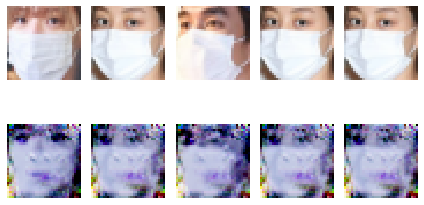

epoch = 722/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 723/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 724/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 725/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 726/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 727/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 728/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 731/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


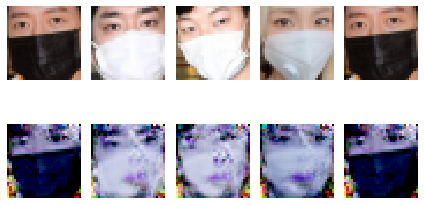

epoch = 732/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 733/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 734/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 735/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 736/5000, d_loss=0.051, g_loss=0.171                                                                                                                   
epoch = 737/5000, d_loss=0.065, g_loss=0.056                                                                                                                   
epoch = 738/5000, d_loss=0.017, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 741/5000, d_loss=0.007, g_loss=0.014                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


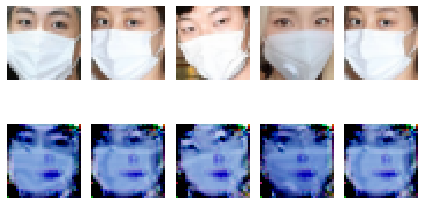

epoch = 742/5000, d_loss=0.004, g_loss=0.013                                                                                                                   
epoch = 743/5000, d_loss=0.012, g_loss=0.018                                                                                                                   
epoch = 744/5000, d_loss=0.002, g_loss=0.011                                                                                                                   
epoch = 745/5000, d_loss=0.004, g_loss=0.010                                                                                                                   
epoch = 746/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 747/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 748/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 751/5000, d_loss=0.001, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


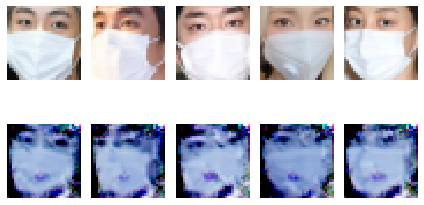

epoch = 752/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 753/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 754/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 755/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 756/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 757/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 758/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 761/5000, d_loss=0.001, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


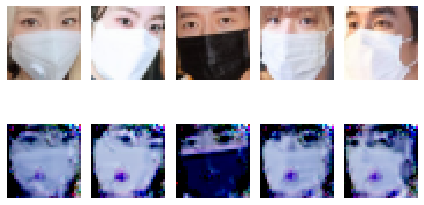

epoch = 762/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 763/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 764/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 765/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 766/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 767/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 768/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 771/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


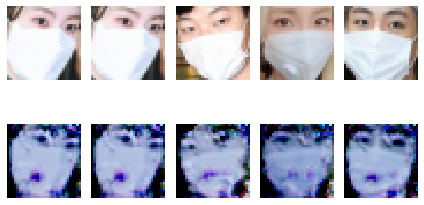

epoch = 772/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 773/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 774/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 775/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 776/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 777/5000, d_loss=0.003, g_loss=0.005                                                                                                                   
epoch = 778/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 781/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


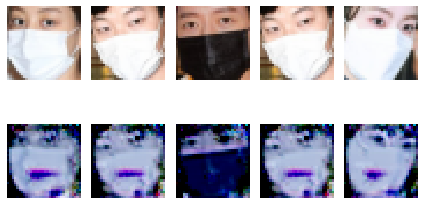

epoch = 782/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 783/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 784/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 785/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 786/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 787/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 788/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 791/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


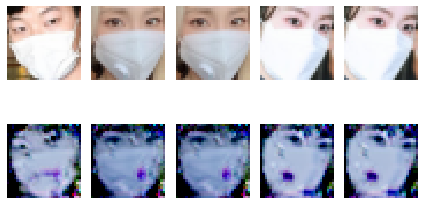

epoch = 792/5000, d_loss=0.006, g_loss=0.004                                                                                                                   
epoch = 793/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 794/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 795/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 796/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 797/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 798/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 801/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


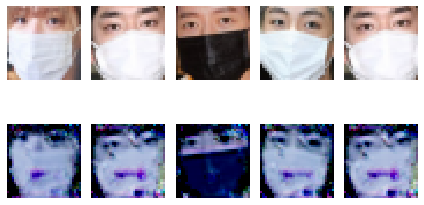

epoch = 802/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 803/5000, d_loss=0.003, g_loss=0.004                                                                                                                   
epoch = 804/5000, d_loss=0.009, g_loss=0.008                                                                                                                   
epoch = 805/5000, d_loss=0.005, g_loss=0.003                                                                                                                   
epoch = 806/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 807/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 808/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 811/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


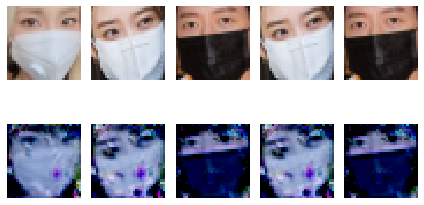

epoch = 812/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 813/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 814/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 815/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 816/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 817/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 818/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 821/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


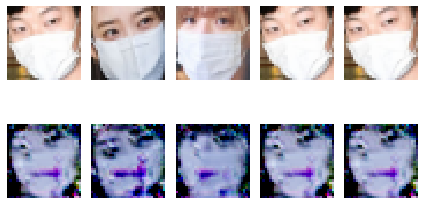

epoch = 822/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 823/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 824/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 825/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 826/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 827/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 828/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 831/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


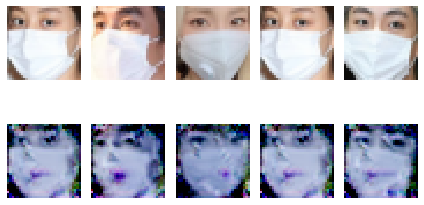

epoch = 832/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 833/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 834/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 835/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 836/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 837/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 838/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 841/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


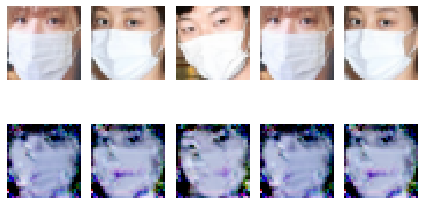

epoch = 842/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 843/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 844/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 845/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 846/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 847/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 848/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 851/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


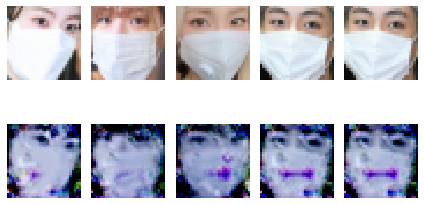

epoch = 852/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 853/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 854/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 855/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 856/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 857/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 858/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 861/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


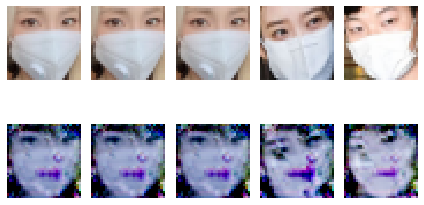

epoch = 862/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 863/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 864/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 865/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 866/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 867/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 868/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 871/5000, d_loss=0.002, g_loss=0.004                                                                                                     


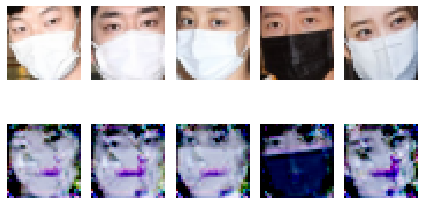

epoch = 872/5000, d_loss=0.003, g_loss=0.008                                                                                                                   
epoch = 873/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 874/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 875/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 876/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 877/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 878/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 881/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


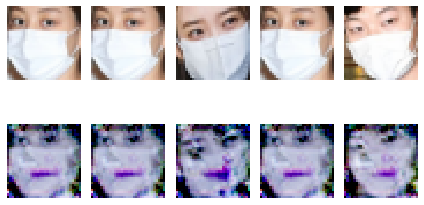

epoch = 882/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 883/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 884/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 885/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 886/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 887/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 888/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 891/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


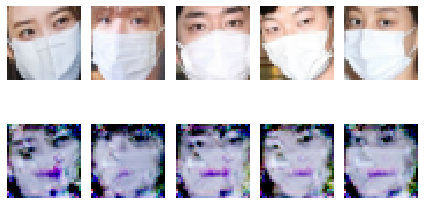

epoch = 892/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 893/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 894/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 895/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 896/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 897/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 898/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 901/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


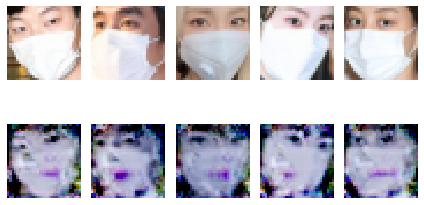

epoch = 902/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 903/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 904/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 905/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 906/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 907/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 908/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 911/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


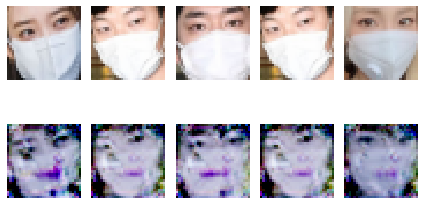

epoch = 912/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 913/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 914/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 915/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 916/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 917/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 918/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 921/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


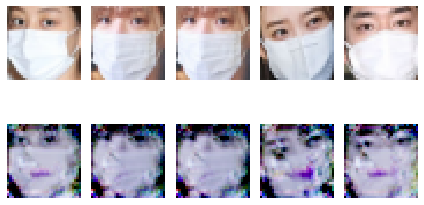

epoch = 922/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 923/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 924/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 925/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 926/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 927/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 928/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 931/5000, d_loss=0.049, g_loss=0.103                                                                                                     


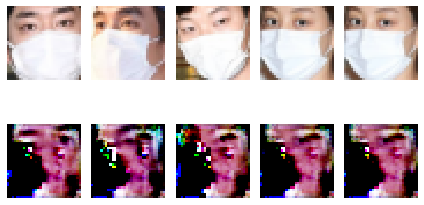

epoch = 932/5000, d_loss=0.056, g_loss=0.025                                                                                                                   
epoch = 933/5000, d_loss=0.018, g_loss=0.018                                                                                                                   
epoch = 934/5000, d_loss=0.017, g_loss=0.014                                                                                                                   
epoch = 935/5000, d_loss=0.006, g_loss=0.008                                                                                                                   
epoch = 936/5000, d_loss=0.005, g_loss=0.007                                                                                                                   
epoch = 937/5000, d_loss=0.004, g_loss=0.006                                                                                                                   
epoch = 938/5000, d_loss=0.003, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 941/5000, d_loss=0.002, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


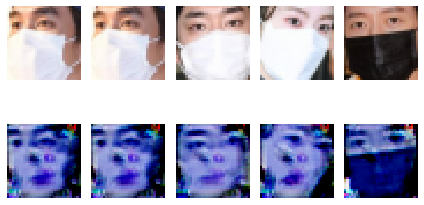

epoch = 942/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 943/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 944/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 945/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 946/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 947/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 948/5000, d_loss=0.002, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 951/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


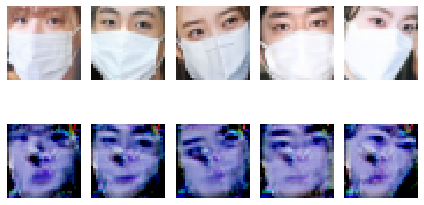

epoch = 952/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 953/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 954/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 955/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 956/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 957/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 958/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 961/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


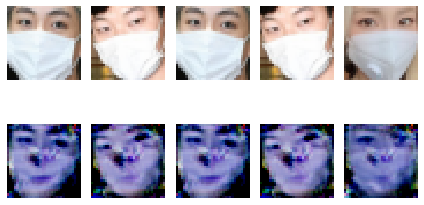

epoch = 962/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 963/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 964/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 965/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 966/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 967/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 968/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 971/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


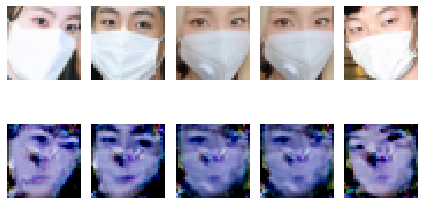

epoch = 972/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 973/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 974/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 975/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 976/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 977/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 978/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 981/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


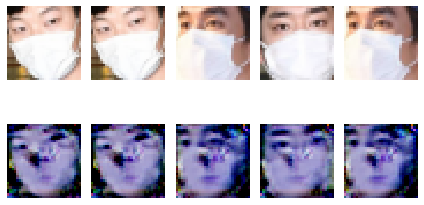

epoch = 982/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 983/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 984/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 985/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 986/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 987/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 988/5000, d_loss=0.001, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 991/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


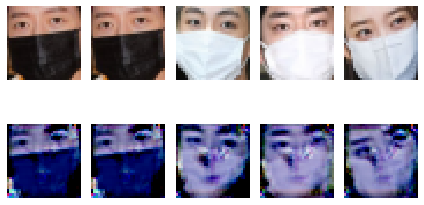

epoch = 992/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 993/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 994/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 995/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 996/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 997/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 998/5000, d_loss=0.000, g_loss=0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1001/5000, d_loss=0.004, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


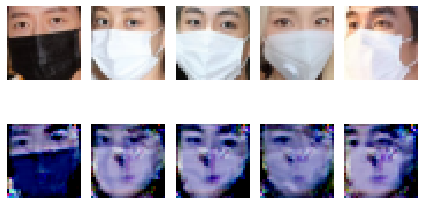

epoch = 1002/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1003/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1004/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1005/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1006/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1007/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1008/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1011/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


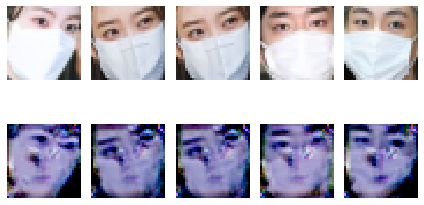

epoch = 1012/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1013/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1014/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1015/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1016/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1017/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1018/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1021/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


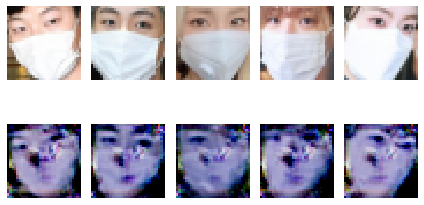

epoch = 1022/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1023/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1024/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1025/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1026/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 1027/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1028/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1031/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


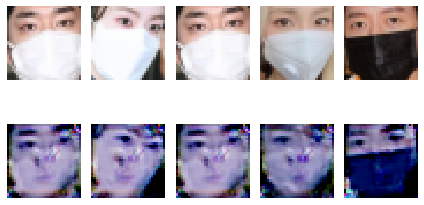

epoch = 1032/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1033/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1034/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1035/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1036/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1037/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1038/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1041/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


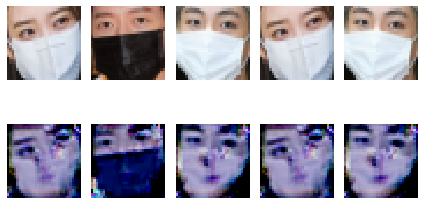

epoch = 1042/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1043/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1044/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1045/5000, d_loss=0.003, g_loss=0.002                                                                                                                   
epoch = 1046/5000, d_loss=0.004, g_loss=0.006                                                                                                                   
epoch = 1047/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1048/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1051/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


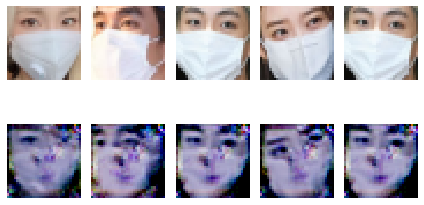

epoch = 1052/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1053/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1054/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1055/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1056/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1057/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1058/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1061/5000, d_loss=0.000, g_loss=0.000                                                                                                     


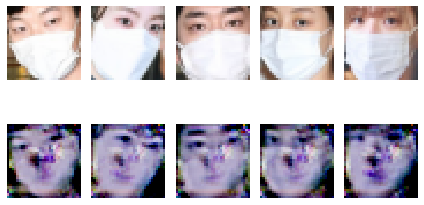

epoch = 1062/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1063/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1064/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1065/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1066/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1067/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1068/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1071/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


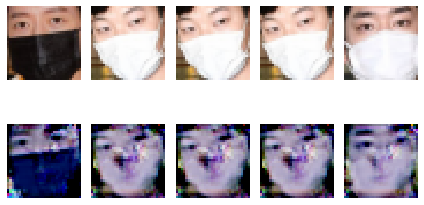

epoch = 1072/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1073/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1074/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1075/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1076/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1077/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1078/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1081/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


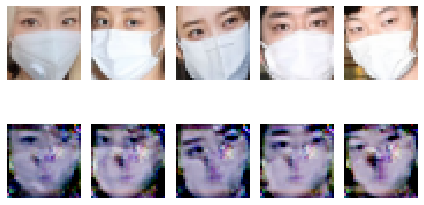

epoch = 1082/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1083/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1084/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1085/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1086/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1087/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1088/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1091/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


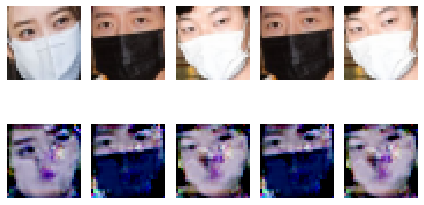

epoch = 1092/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1093/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 1094/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1095/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1096/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1097/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1098/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1101/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


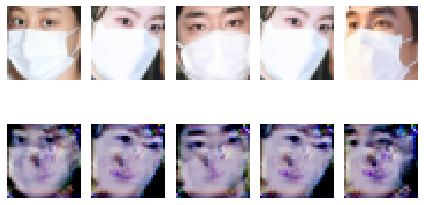

epoch = 1102/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1103/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1104/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1105/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1106/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1107/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1108/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1111/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


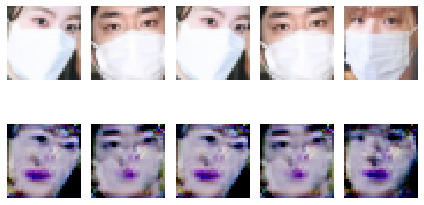

epoch = 1112/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1113/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1114/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1115/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1116/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1117/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1118/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1121/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


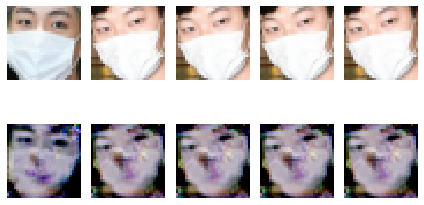

epoch = 1122/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1123/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1124/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1125/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1126/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1127/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1128/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1131/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


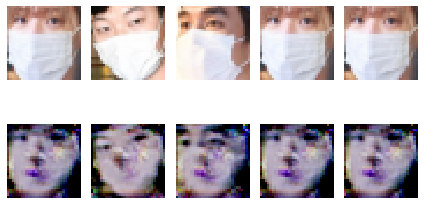

epoch = 1132/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1133/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1134/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1135/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1136/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1137/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1138/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1141/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


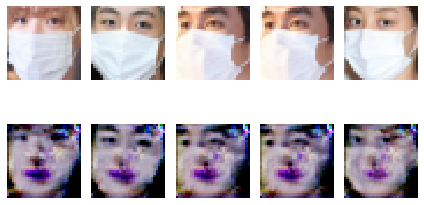

epoch = 1142/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 1143/5000, d_loss=0.005, g_loss=0.005                                                                                                                   
epoch = 1144/5000, d_loss=0.005, g_loss=0.002                                                                                                                   
epoch = 1145/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 1146/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1147/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1148/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1151/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


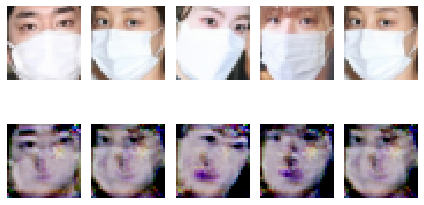

epoch = 1152/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1153/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1154/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1155/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1156/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1157/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1158/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1161/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


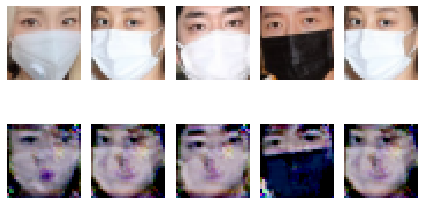

epoch = 1162/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1163/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1164/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1165/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1166/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1167/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1168/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1171/5000, d_loss=0.001, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


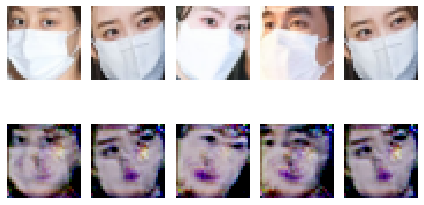

epoch = 1172/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1173/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1174/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1175/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1176/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1177/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 1178/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


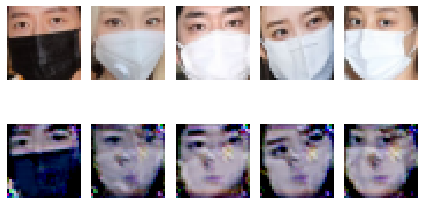

epoch = 1182/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 1183/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1184/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 1185/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1186/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1187/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 1188/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1191/5000, d_loss=0.001, g_loss=0.001                                                                                                     


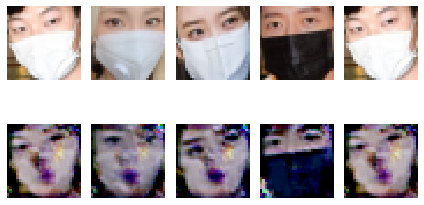

epoch = 1192/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1193/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1194/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 1195/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1196/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1197/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1198/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1201/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


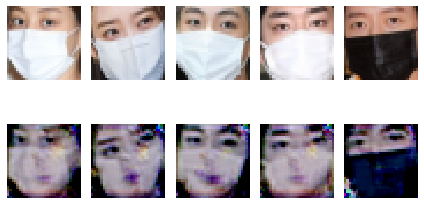

epoch = 1202/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1203/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1204/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1205/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 1206/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1207/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1208/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1211/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


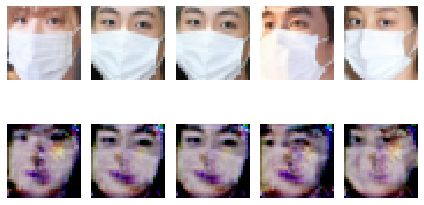

epoch = 1212/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1213/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1214/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1215/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1216/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1217/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1218/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1221/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


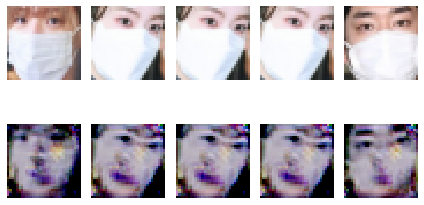

epoch = 1222/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1223/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1224/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1225/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1226/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1227/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1228/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1231/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


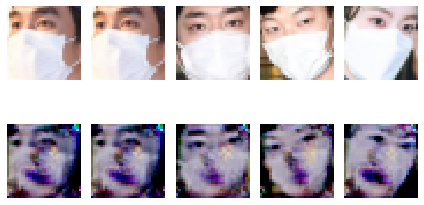

epoch = 1232/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1233/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1234/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1235/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1236/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 1237/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1238/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1241/5000, d_loss=0.001, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


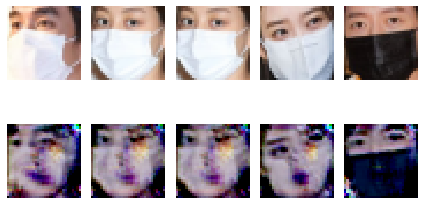

epoch = 1242/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 1243/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1244/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1245/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1246/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1247/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1248/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1251/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


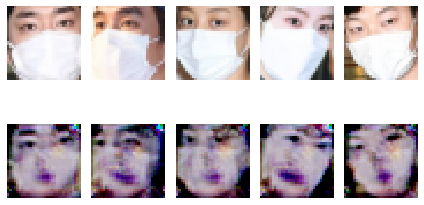

epoch = 1252/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1253/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1254/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1255/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1256/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1257/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1258/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1261/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


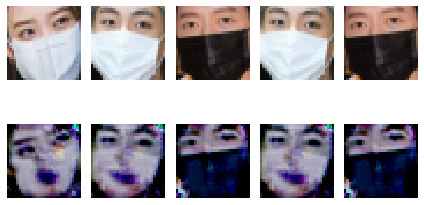

epoch = 1262/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1263/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 1264/5000, d_loss=0.003, g_loss=0.007                                                                                                                   
epoch = 1265/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 1266/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1267/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 1268/5000, d_loss=0.005, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1271/5000, d_loss=0.003, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


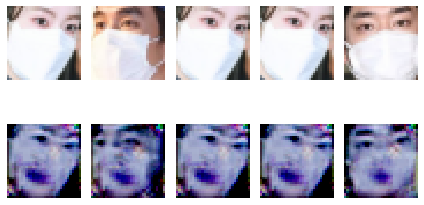

epoch = 1272/5000, d_loss=0.003, g_loss=0.011                                                                                                                   
epoch = 1273/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 1274/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1275/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1276/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1277/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1278/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1281/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


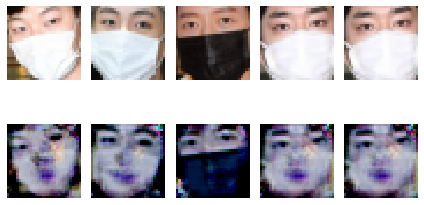

epoch = 1282/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1283/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1284/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1285/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1286/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1287/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1288/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1291/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


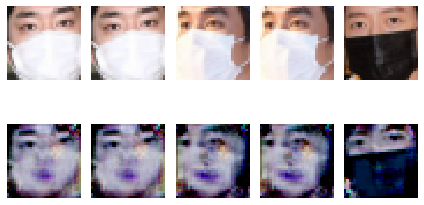

epoch = 1292/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1293/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1294/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1295/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1296/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1297/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1298/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1301/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


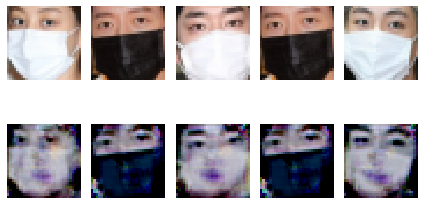

epoch = 1302/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1303/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1304/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1305/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1306/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1307/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1308/5000, d_loss=0.004, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1311/5000, d_loss=0.008, g_loss=0.018                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


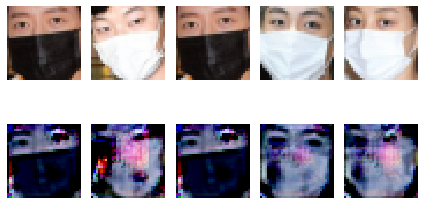

epoch = 1312/5000, d_loss=0.051, g_loss=0.042                                                                                                                   
epoch = 1313/5000, d_loss=0.024, g_loss=0.057                                                                                                                   
epoch = 1314/5000, d_loss=0.012, g_loss=0.040                                                                                                                   
epoch = 1315/5000, d_loss=0.011, g_loss=0.016                                                                                                                   
epoch = 1316/5000, d_loss=0.085, g_loss=0.056                                                                                                                   
epoch = 1317/5000, d_loss=0.008, g_loss=0.019                                                                                                                   
epoch = 1318/5000, d_loss=0.007, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1321/5000, d_loss=0.007, g_loss=0.007                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


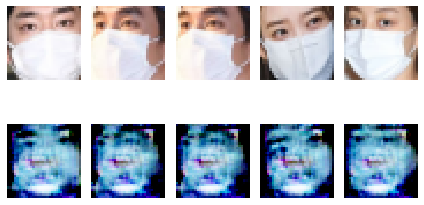

epoch = 1322/5000, d_loss=0.005, g_loss=0.006                                                                                                                   
epoch = 1323/5000, d_loss=0.005, g_loss=0.006                                                                                                                   
epoch = 1324/5000, d_loss=0.005, g_loss=0.005                                                                                                                   
epoch = 1325/5000, d_loss=0.005, g_loss=0.005                                                                                                                   
epoch = 1326/5000, d_loss=0.005, g_loss=0.005                                                                                                                   
epoch = 1327/5000, d_loss=0.004, g_loss=0.004                                                                                                                   
epoch = 1328/5000, d_loss=0.005, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1331/5000, d_loss=0.004, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


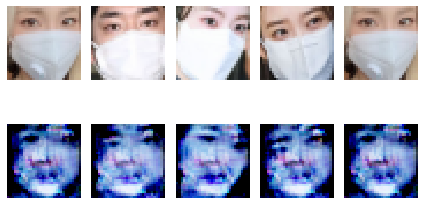

epoch = 1332/5000, d_loss=0.003, g_loss=0.005                                                                                                                   
epoch = 1333/5000, d_loss=0.003, g_loss=0.004                                                                                                                   
epoch = 1334/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 1335/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 1336/5000, d_loss=0.004, g_loss=0.003                                                                                                                   
epoch = 1337/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 1338/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


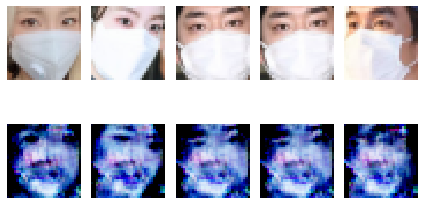

epoch = 1342/5000, d_loss=0.003, g_loss=0.002                                                                                                                   
epoch = 1343/5000, d_loss=0.003, g_loss=0.002                                                                                                                   
epoch = 1344/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 1345/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1346/5000, d_loss=0.003, g_loss=0.002                                                                                                                   
epoch = 1347/5000, d_loss=0.010, g_loss=0.003                                                                                                                   
epoch = 1348/5000, d_loss=0.005, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1351/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


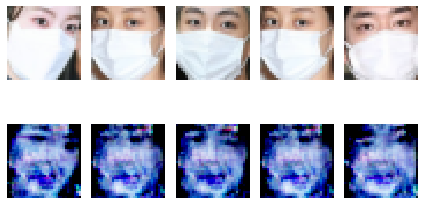

epoch = 1352/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1353/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1354/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 1355/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1356/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1357/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1358/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1361/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


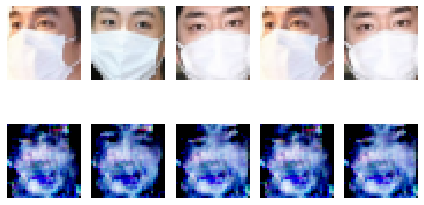

epoch = 1362/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1363/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1364/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1365/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1366/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1367/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1368/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1371/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


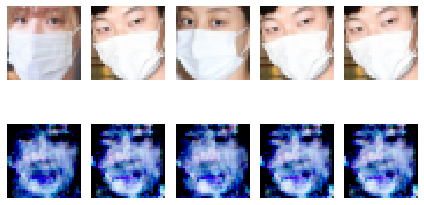

epoch = 1372/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1373/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1374/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1375/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1376/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 1377/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1378/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1381/5000, d_loss=0.002, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


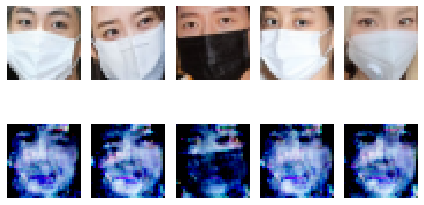

epoch = 1382/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1383/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1384/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1385/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1386/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1387/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1388/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1391/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


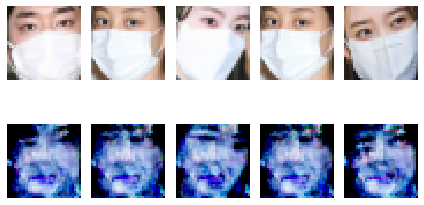

epoch = 1392/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 1393/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1394/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1395/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1396/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 1397/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1398/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1401/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


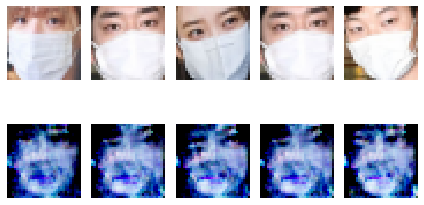

epoch = 1402/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1403/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1404/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1405/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1406/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1407/5000, d_loss=0.005, g_loss=0.002                                                                                                                   
epoch = 1408/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1411/5000, d_loss=0.002, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


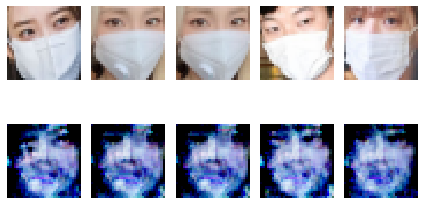

epoch = 1412/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 1413/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1414/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1415/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1416/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1417/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1418/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1421/5000, d_loss=0.000, g_loss=0.000                                                                                                     


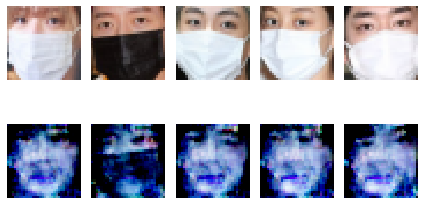

epoch = 1422/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1423/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 1424/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1425/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1426/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1427/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1428/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1431/5000, d_loss=0.003, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


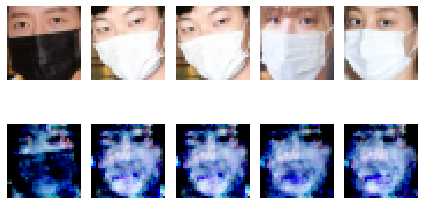

epoch = 1432/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1433/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1434/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1435/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1436/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1437/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1438/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1441/5000, d_loss=0.002, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


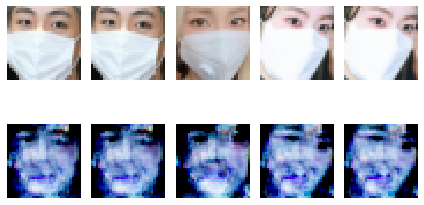

epoch = 1442/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 1443/5000, d_loss=0.003, g_loss=0.002                                                                                                                   
epoch = 1444/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 1445/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1446/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1447/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1448/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1451/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


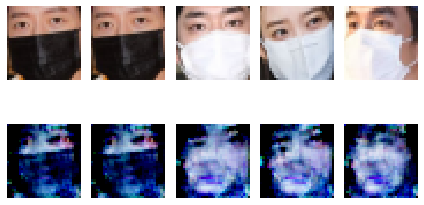

epoch = 1452/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1453/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1454/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1455/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1456/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1457/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1458/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1461/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


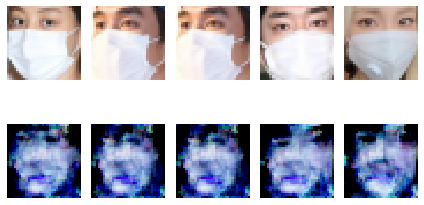

epoch = 1462/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1463/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1464/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1465/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1466/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1467/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1468/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1471/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


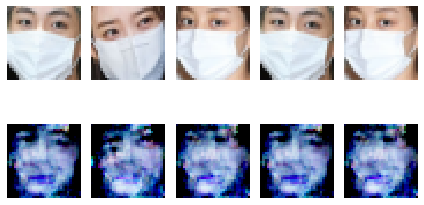

epoch = 1472/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1473/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1474/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1475/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1476/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1477/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1478/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1481/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


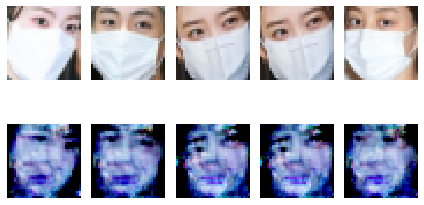

epoch = 1482/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1483/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1484/5000, d_loss=0.002, g_loss=0.008                                                                                                                   
epoch = 1485/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 1486/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1487/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 1488/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1491/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


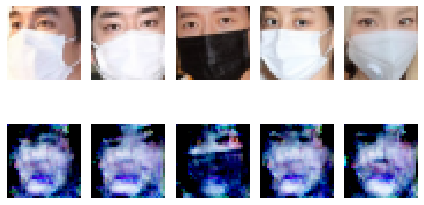

epoch = 1492/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1493/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1494/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1495/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1496/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1497/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1498/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1501/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


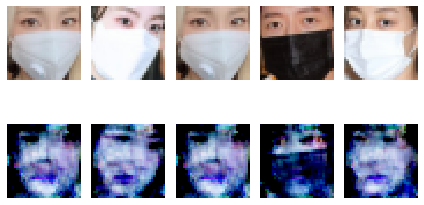

epoch = 1502/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1503/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1504/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1505/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1506/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1507/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1508/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1511/5000, d_loss=0.001, g_loss=0.002                                                                                                     


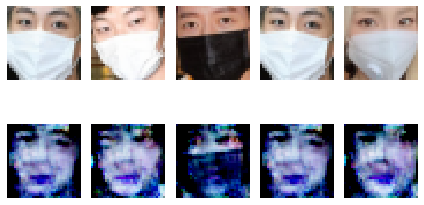

epoch = 1512/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1513/5000, d_loss=0.002, g_loss=0.006                                                                                                                   
epoch = 1514/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1515/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1516/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1517/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1518/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1521/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


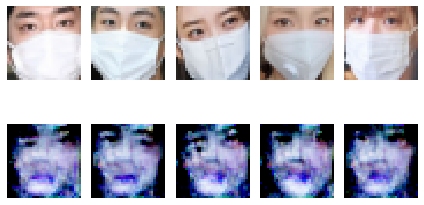

epoch = 1522/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1523/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1524/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1525/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1526/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1527/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1528/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1531/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


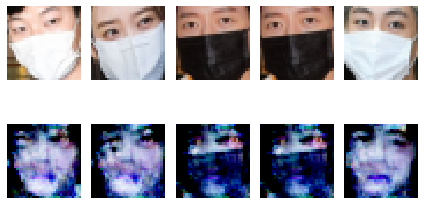

epoch = 1532/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1533/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1534/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1535/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1536/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1537/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1538/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1541/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


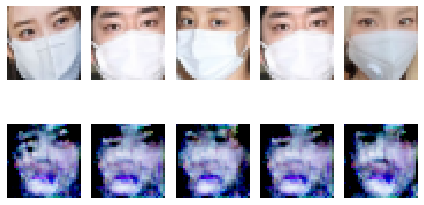

epoch = 1542/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1543/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1544/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1545/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1546/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1547/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1548/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1551/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


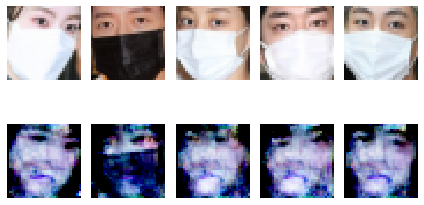

epoch = 1552/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1553/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1554/5000, d_loss=0.003, g_loss=0.005                                                                                                                   
epoch = 1555/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 1556/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 1557/5000, d_loss=0.006, g_loss=0.012                                                                                                                   
epoch = 1558/5000, d_loss=0.012, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1561/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


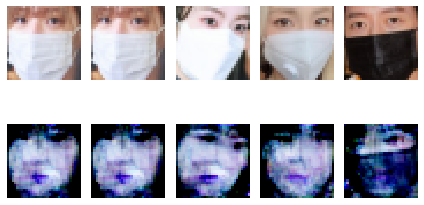

epoch = 1562/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1563/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1564/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1565/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1566/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1567/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1568/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1571/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


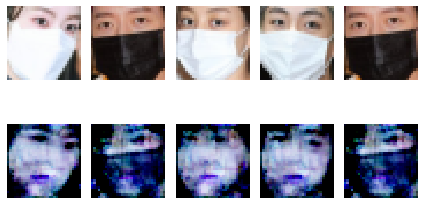

epoch = 1572/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1573/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1574/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1575/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1576/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1577/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1578/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1581/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


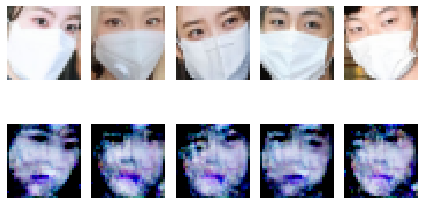

epoch = 1582/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1583/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1584/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 1585/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1586/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1587/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 1588/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1591/5000, d_loss=0.000, g_loss=0.001                                                                                                     


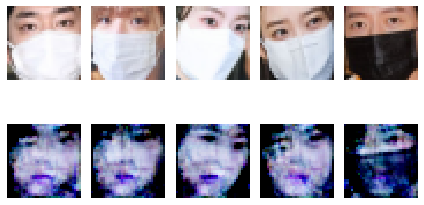

epoch = 1592/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1593/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1594/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1595/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1596/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1597/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1598/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1601/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


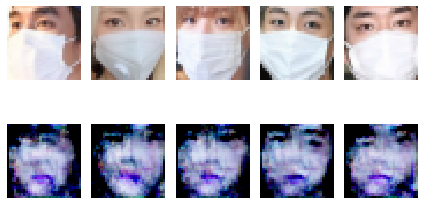

epoch = 1602/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1603/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1604/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1605/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1606/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1607/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1608/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1611/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


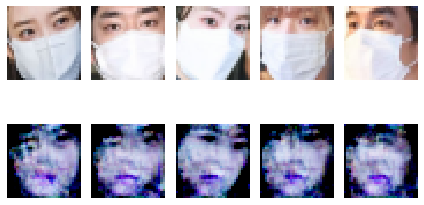

epoch = 1612/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1613/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1614/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1615/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1616/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1617/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1618/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1621/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


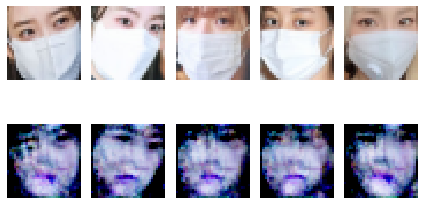

epoch = 1622/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1623/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1624/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1625/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1626/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1627/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1628/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1631/5000, d_loss=0.000, g_loss=0.001                                                                                                     


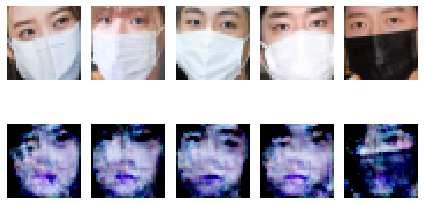

epoch = 1632/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1633/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1634/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1635/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1636/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1637/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1638/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1641/5000, d_loss=0.002, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


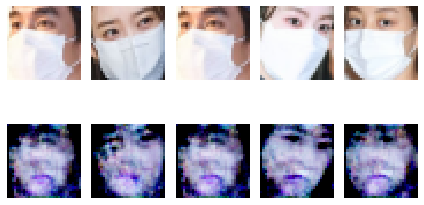

epoch = 1642/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1643/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1644/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1645/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1646/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1647/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1648/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1651/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


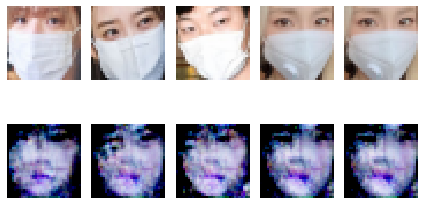

epoch = 1652/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1653/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1654/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1655/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1656/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1657/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1658/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1661/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


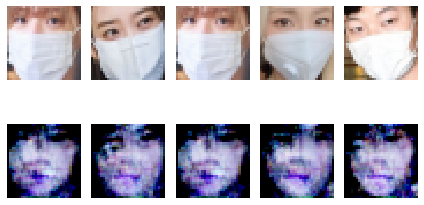

epoch = 1662/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1663/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1664/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1665/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1666/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1667/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 1668/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1671/5000, d_loss=0.006, g_loss=0.013                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


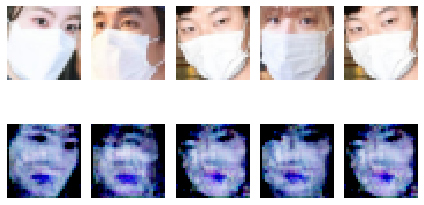

epoch = 1672/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 1673/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 1674/5000, d_loss=0.010, g_loss=0.009                                                                                                                   
epoch = 1675/5000, d_loss=0.004, g_loss=0.007                                                                                                                   
epoch = 1676/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 1677/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 1678/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1681/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


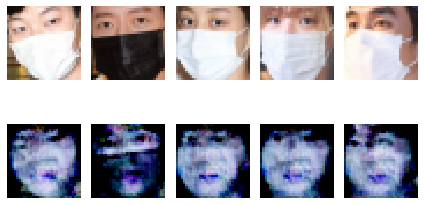

epoch = 1682/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1683/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1684/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1685/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1686/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1687/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 1688/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1691/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


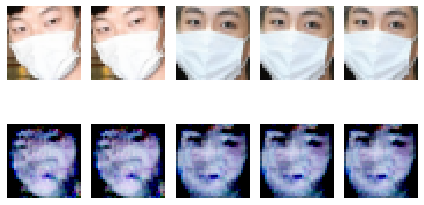

epoch = 1692/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1693/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 1694/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1695/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1696/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1697/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 1698/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1701/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


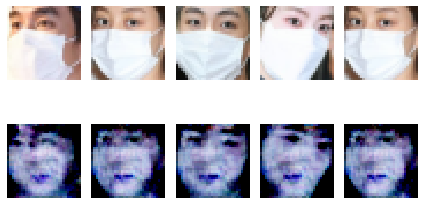

epoch = 1702/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1703/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1704/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1705/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1706/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1707/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1708/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1711/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


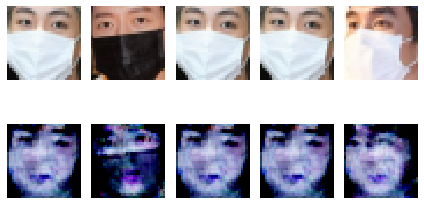

epoch = 1712/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1713/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1714/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1715/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1716/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1717/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1718/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1721/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


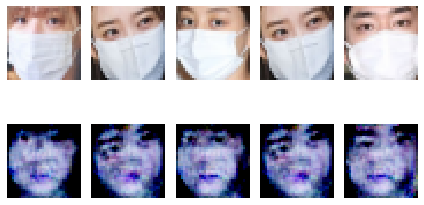

epoch = 1722/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1723/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1724/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1725/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1726/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1727/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1728/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1731/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


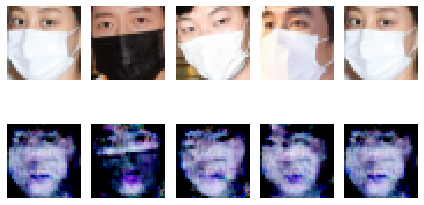

epoch = 1732/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1733/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1734/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1735/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1736/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1737/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1738/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1741/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


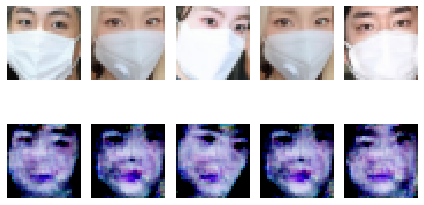

epoch = 1742/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1743/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 1744/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 1745/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1746/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1747/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1748/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1751/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


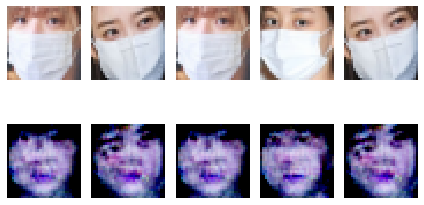

epoch = 1752/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1753/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1754/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1755/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1756/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1757/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1758/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1761/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


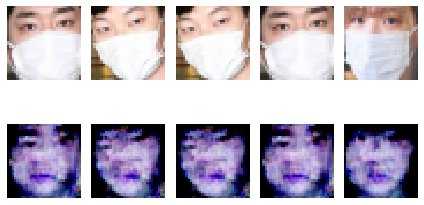

epoch = 1762/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1763/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1764/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1765/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1766/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1767/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1768/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1771/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


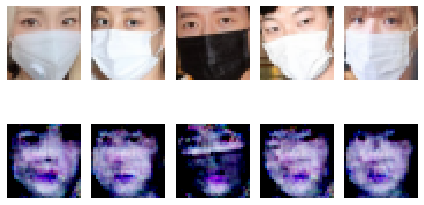

epoch = 1772/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1773/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1774/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1775/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1776/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1777/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1778/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1781/5000, d_loss=0.002, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


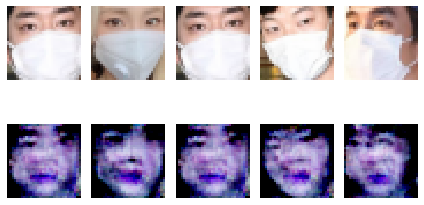

epoch = 1782/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 1783/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 1784/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 1785/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 1786/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1787/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1788/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1791/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


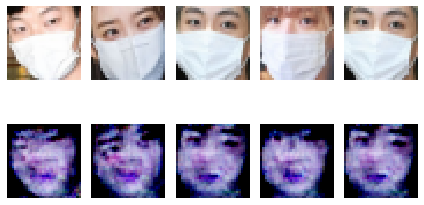

epoch = 1792/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1793/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1794/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1795/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1796/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1797/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1798/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1801/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


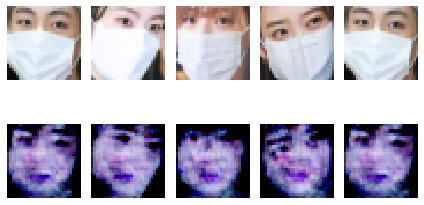

epoch = 1802/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1803/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1804/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1805/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1806/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 1807/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 1808/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1811/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


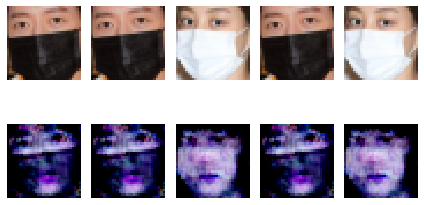

epoch = 1812/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 1813/5000, d_loss=0.020, g_loss=0.023                                                                                                                   
epoch = 1814/5000, d_loss=0.048, g_loss=0.065                                                                                                                   
epoch = 1815/5000, d_loss=0.983, g_loss=0.022                                                                                                                   
epoch = 1816/5000, d_loss=0.654, g_loss=0.055                                                                                                                   
epoch = 1817/5000, d_loss=0.106, g_loss=0.052                                                                                                                   
epoch = 1818/5000, d_loss=0.100, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1821/5000, d_loss=0.126, g_loss=0.156                                                                                                     


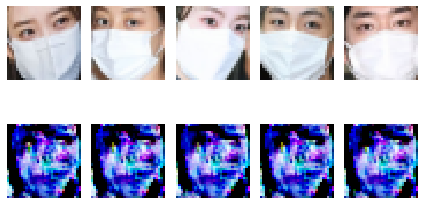

epoch = 1822/5000, d_loss=0.125, g_loss=0.165                                                                                                                   
epoch = 1823/5000, d_loss=0.119, g_loss=0.134                                                                                                                   
epoch = 1824/5000, d_loss=0.132, g_loss=0.141                                                                                                                   
epoch = 1825/5000, d_loss=0.537, g_loss=0.252                                                                                                                   
epoch = 1826/5000, d_loss=0.159, g_loss=0.233                                                                                                                   
epoch = 1827/5000, d_loss=0.137, g_loss=0.190                                                                                                                   
epoch = 1828/5000, d_loss=0.125, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1831/5000, d_loss=0.097, g_loss=0.179                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


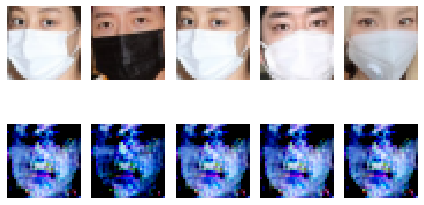

epoch = 1832/5000, d_loss=0.114, g_loss=0.246                                                                                                                   
epoch = 1833/5000, d_loss=0.091, g_loss=0.284                                                                                                                   
epoch = 1834/5000, d_loss=0.094, g_loss=0.271                                                                                                                   
epoch = 1835/5000, d_loss=0.097, g_loss=0.243                                                                                                                   
epoch = 1836/5000, d_loss=0.122, g_loss=0.304                                                                                                                   
epoch = 1837/5000, d_loss=0.092, g_loss=0.298                                                                                                                   
epoch = 1838/5000, d_loss=0.083, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1841/5000, d_loss=0.089, g_loss=0.213                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


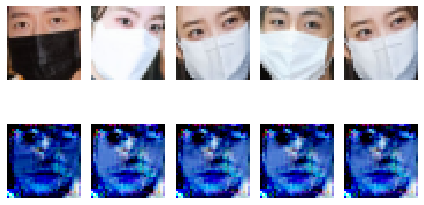

epoch = 1842/5000, d_loss=0.089, g_loss=0.196                                                                                                                   
epoch = 1843/5000, d_loss=0.080, g_loss=0.209                                                                                                                   
epoch = 1844/5000, d_loss=0.103, g_loss=0.259                                                                                                                   
epoch = 1845/5000, d_loss=0.100, g_loss=0.212                                                                                                                   
epoch = 1846/5000, d_loss=0.077, g_loss=0.243                                                                                                                   
epoch = 1847/5000, d_loss=0.067, g_loss=0.263                                                                                                                   
epoch = 1848/5000, d_loss=0.083, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1851/5000, d_loss=0.051, g_loss=0.318                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


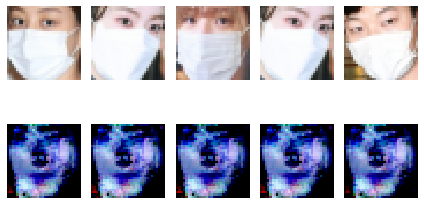

epoch = 1852/5000, d_loss=0.055, g_loss=0.296                                                                                                                   
epoch = 1853/5000, d_loss=0.042, g_loss=0.351                                                                                                                   
epoch = 1854/5000, d_loss=0.060, g_loss=0.290                                                                                                                   
epoch = 1855/5000, d_loss=0.059, g_loss=0.225                                                                                                                   
epoch = 1856/5000, d_loss=0.059, g_loss=0.368                                                                                                                   
epoch = 1857/5000, d_loss=0.090, g_loss=0.341                                                                                                                   
epoch = 1858/5000, d_loss=0.070, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1861/5000, d_loss=0.083, g_loss=0.447                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


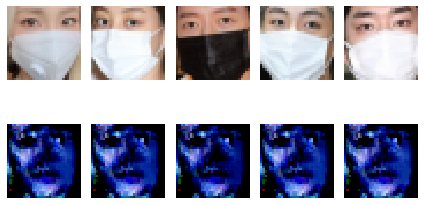

epoch = 1862/5000, d_loss=0.053, g_loss=0.376                                                                                                                   
epoch = 1863/5000, d_loss=0.039, g_loss=0.433                                                                                                                   
epoch = 1864/5000, d_loss=0.046, g_loss=0.408                                                                                                                   
epoch = 1865/5000, d_loss=0.062, g_loss=0.357                                                                                                                   
epoch = 1866/5000, d_loss=0.065, g_loss=0.227                                                                                                                   
epoch = 1867/5000, d_loss=0.041, g_loss=0.500                                                                                                                   
epoch = 1868/5000, d_loss=0.064, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1871/5000, d_loss=0.046, g_loss=0.415                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


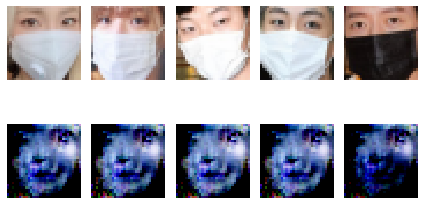

epoch = 1872/5000, d_loss=0.037, g_loss=0.309                                                                                                                   
epoch = 1873/5000, d_loss=0.027, g_loss=0.121                                                                                                                   
epoch = 1874/5000, d_loss=0.048, g_loss=0.449                                                                                                                   
epoch = 1875/5000, d_loss=0.038, g_loss=0.428                                                                                                                   
epoch = 1876/5000, d_loss=0.031, g_loss=0.435                                                                                                                   
epoch = 1877/5000, d_loss=0.034, g_loss=0.509                                                                                                                   
epoch = 1878/5000, d_loss=0.048, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1881/5000, d_loss=0.024, g_loss=0.325                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


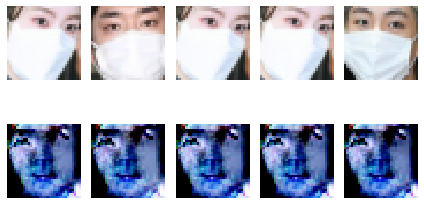

epoch = 1882/5000, d_loss=0.032, g_loss=0.246                                                                                                                   
epoch = 1883/5000, d_loss=0.033, g_loss=0.322                                                                                                                   
epoch = 1884/5000, d_loss=0.028, g_loss=0.406                                                                                                                   
epoch = 1885/5000, d_loss=0.036, g_loss=0.581                                                                                                                   
epoch = 1886/5000, d_loss=0.017, g_loss=0.463                                                                                                                   
epoch = 1887/5000, d_loss=0.013, g_loss=0.547                                                                                                                   
epoch = 1888/5000, d_loss=0.014, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1891/5000, d_loss=0.013, g_loss=0.491                                                                                                     


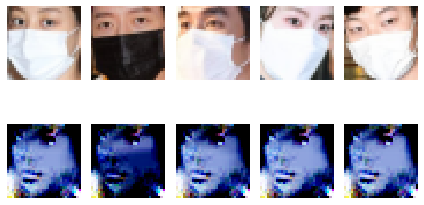

epoch = 1892/5000, d_loss=0.017, g_loss=0.496                                                                                                                   
epoch = 1893/5000, d_loss=0.024, g_loss=0.607                                                                                                                   
epoch = 1894/5000, d_loss=0.014, g_loss=0.555                                                                                                                   
epoch = 1895/5000, d_loss=0.014, g_loss=0.435                                                                                                                   
epoch = 1896/5000, d_loss=0.019, g_loss=0.382                                                                                                                   
epoch = 1897/5000, d_loss=0.029, g_loss=0.438                                                                                                                   
epoch = 1898/5000, d_loss=0.017, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1901/5000, d_loss=0.018, g_loss=0.576                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


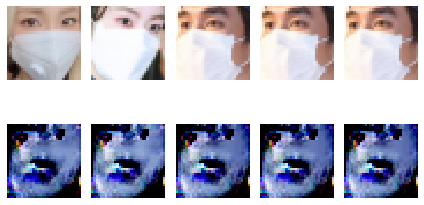

epoch = 1902/5000, d_loss=0.026, g_loss=0.270                                                                                                                   
epoch = 1903/5000, d_loss=0.020, g_loss=0.490                                                                                                                   
epoch = 1904/5000, d_loss=0.020, g_loss=0.644                                                                                                                   
epoch = 1905/5000, d_loss=0.013, g_loss=0.693                                                                                                                   
epoch = 1906/5000, d_loss=0.013, g_loss=0.664                                                                                                                   
epoch = 1907/5000, d_loss=0.012, g_loss=0.591                                                                                                                   
epoch = 1908/5000, d_loss=0.021, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1911/5000, d_loss=0.007, g_loss=0.550                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


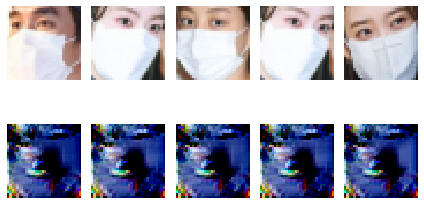

epoch = 1912/5000, d_loss=0.016, g_loss=0.536                                                                                                                   
epoch = 1913/5000, d_loss=0.008, g_loss=0.504                                                                                                                   
epoch = 1914/5000, d_loss=0.062, g_loss=0.436                                                                                                                   
epoch = 1915/5000, d_loss=0.014, g_loss=0.623                                                                                                                   
epoch = 1916/5000, d_loss=0.012, g_loss=0.419                                                                                                                   
epoch = 1917/5000, d_loss=0.011, g_loss=0.226                                                                                                                   
epoch = 1918/5000, d_loss=0.023, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1921/5000, d_loss=0.010, g_loss=0.325                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


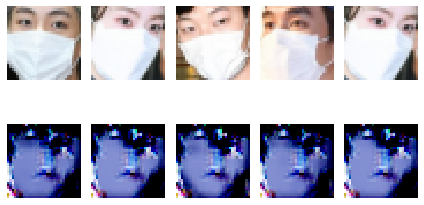

epoch = 1922/5000, d_loss=0.020, g_loss=0.166                                                                                                                   
epoch = 1923/5000, d_loss=0.007, g_loss=0.242                                                                                                                   
epoch = 1924/5000, d_loss=0.011, g_loss=0.227                                                                                                                   
epoch = 1925/5000, d_loss=0.009, g_loss=0.241                                                                                                                   
epoch = 1926/5000, d_loss=0.009, g_loss=0.265                                                                                                                   
epoch = 1927/5000, d_loss=0.011, g_loss=0.245                                                                                                                   
epoch = 1928/5000, d_loss=0.033, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1931/5000, d_loss=0.007, g_loss=0.350                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


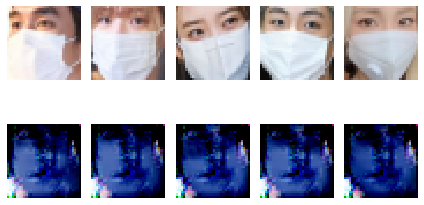

epoch = 1932/5000, d_loss=0.007, g_loss=0.241                                                                                                                   
epoch = 1933/5000, d_loss=0.006, g_loss=0.195                                                                                                                   
epoch = 1934/5000, d_loss=0.008, g_loss=0.139                                                                                                                   
epoch = 1935/5000, d_loss=0.007, g_loss=0.132                                                                                                                   
epoch = 1936/5000, d_loss=0.006, g_loss=0.138                                                                                                                   
epoch = 1937/5000, d_loss=0.006, g_loss=0.135                                                                                                                   
epoch = 1938/5000, d_loss=0.006, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1941/5000, d_loss=0.005, g_loss=0.122                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


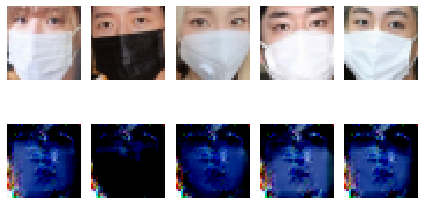

epoch = 1942/5000, d_loss=0.006, g_loss=0.122                                                                                                                   
epoch = 1943/5000, d_loss=0.004, g_loss=0.062                                                                                                                   
epoch = 1944/5000, d_loss=0.004, g_loss=0.077                                                                                                                   
epoch = 1945/5000, d_loss=0.004, g_loss=0.066                                                                                                                   
epoch = 1946/5000, d_loss=0.004, g_loss=0.068                                                                                                                   
epoch = 1947/5000, d_loss=0.004, g_loss=0.062                                                                                                                   
epoch = 1948/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1951/5000, d_loss=0.003, g_loss=0.050                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


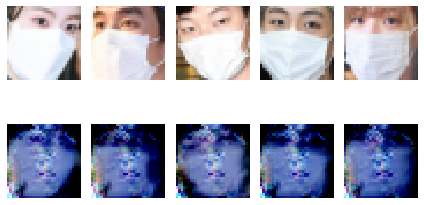

epoch = 1952/5000, d_loss=0.004, g_loss=0.036                                                                                                                   
epoch = 1953/5000, d_loss=0.003, g_loss=0.045                                                                                                                   
epoch = 1954/5000, d_loss=0.003, g_loss=0.032                                                                                                                   
epoch = 1955/5000, d_loss=0.002, g_loss=0.044                                                                                                                   
epoch = 1956/5000, d_loss=0.003, g_loss=0.031                                                                                                                   
epoch = 1957/5000, d_loss=0.003, g_loss=0.032                                                                                                                   
epoch = 1958/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1961/5000, d_loss=0.002, g_loss=0.029                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


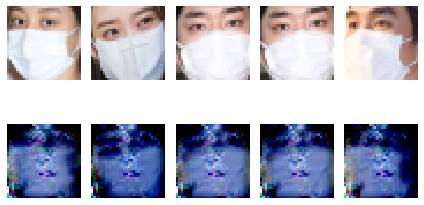

epoch = 1962/5000, d_loss=0.002, g_loss=0.035                                                                                                                   
epoch = 1963/5000, d_loss=0.002, g_loss=0.026                                                                                                                   
epoch = 1964/5000, d_loss=0.002, g_loss=0.035                                                                                                                   
epoch = 1965/5000, d_loss=0.002, g_loss=0.028                                                                                                                   
epoch = 1966/5000, d_loss=0.002, g_loss=0.033                                                                                                                   
epoch = 1967/5000, d_loss=0.003, g_loss=0.027                                                                                                                   
epoch = 1968/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1971/5000, d_loss=0.002, g_loss=0.019                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


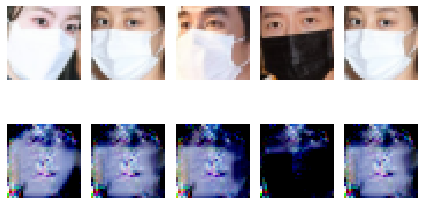

epoch = 1972/5000, d_loss=0.001, g_loss=0.027                                                                                                                   
epoch = 1973/5000, d_loss=0.002, g_loss=0.018                                                                                                                   
epoch = 1974/5000, d_loss=0.001, g_loss=0.024                                                                                                                   
epoch = 1975/5000, d_loss=0.002, g_loss=0.019                                                                                                                   
epoch = 1976/5000, d_loss=0.001, g_loss=0.023                                                                                                                   
epoch = 1977/5000, d_loss=0.001, g_loss=0.019                                                                                                                   
epoch = 1978/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1981/5000, d_loss=0.002, g_loss=0.018                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


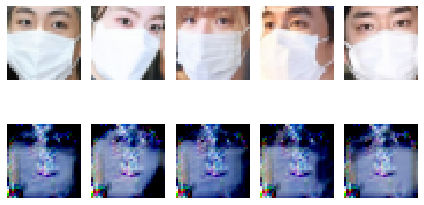

epoch = 1982/5000, d_loss=0.001, g_loss=0.017                                                                                                                   
epoch = 1983/5000, d_loss=0.002, g_loss=0.023                                                                                                                   
epoch = 1984/5000, d_loss=0.001, g_loss=0.016                                                                                                                   
epoch = 1985/5000, d_loss=0.001, g_loss=0.024                                                                                                                   
epoch = 1986/5000, d_loss=0.002, g_loss=0.015                                                                                                                   
epoch = 1987/5000, d_loss=0.002, g_loss=0.026                                                                                                                   
epoch = 1988/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 1991/5000, d_loss=0.001, g_loss=0.020                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


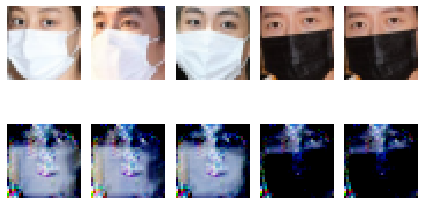

epoch = 1992/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 1993/5000, d_loss=0.001, g_loss=0.022                                                                                                                   
epoch = 1994/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 1995/5000, d_loss=0.001, g_loss=0.018                                                                                                                   
epoch = 1996/5000, d_loss=0.001, g_loss=0.013                                                                                                                   
epoch = 1997/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 1998/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2001/5000, d_loss=0.001, g_loss=0.013                                                                                                     


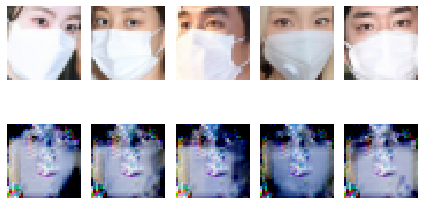

epoch = 2002/5000, d_loss=0.002, g_loss=0.012                                                                                                                   
epoch = 2003/5000, d_loss=0.002, g_loss=0.013                                                                                                                   
epoch = 2004/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 2005/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 2006/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 2007/5000, d_loss=0.001, g_loss=0.011                                                                                                                   
epoch = 2008/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2011/5000, d_loss=0.001, g_loss=0.013                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


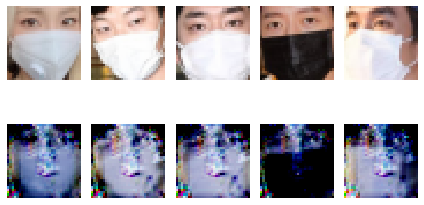

epoch = 2012/5000, d_loss=0.001, g_loss=0.011                                                                                                                   
epoch = 2013/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 2014/5000, d_loss=0.001, g_loss=0.011                                                                                                                   
epoch = 2015/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 2016/5000, d_loss=0.002, g_loss=0.013                                                                                                                   
epoch = 2017/5000, d_loss=0.002, g_loss=0.013                                                                                                                   
epoch = 2018/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2021/5000, d_loss=0.001, g_loss=0.013                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


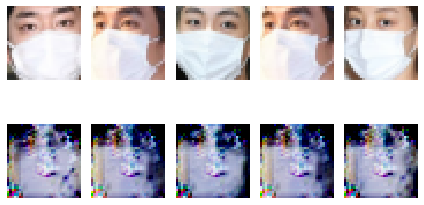

epoch = 2022/5000, d_loss=0.001, g_loss=0.011                                                                                                                   
epoch = 2023/5000, d_loss=0.001, g_loss=0.013                                                                                                                   
epoch = 2024/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 2025/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 2026/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 2027/5000, d_loss=0.002, g_loss=0.011                                                                                                                   
epoch = 2028/5000, d_loss=0.013, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2031/5000, d_loss=0.001, g_loss=0.011                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


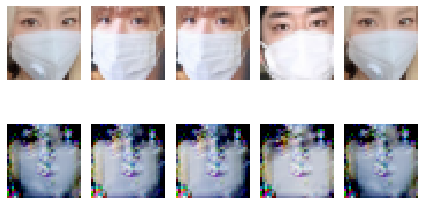

epoch = 2032/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 2033/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 2034/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 2035/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 2036/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 2037/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 2038/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2041/5000, d_loss=0.001, g_loss=0.009                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


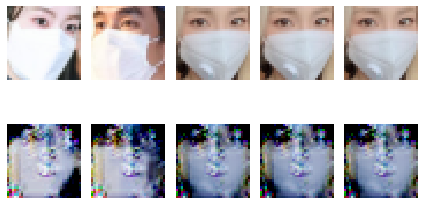

epoch = 2042/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 2043/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 2044/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 2045/5000, d_loss=0.000, g_loss=0.007                                                                                                                   
epoch = 2046/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 2047/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 2048/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2051/5000, d_loss=0.001, g_loss=0.006                                                                                                     


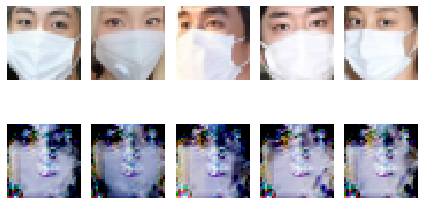

epoch = 2052/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 2053/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2054/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 2055/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 2056/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 2057/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 2058/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2061/5000, d_loss=0.000, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


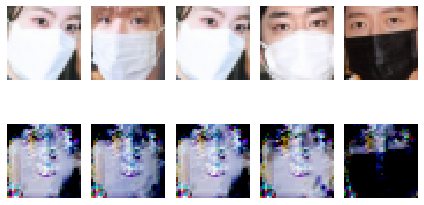

epoch = 2062/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 2063/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2064/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2065/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2066/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2067/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2068/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2071/5000, d_loss=0.001, g_loss=0.008                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


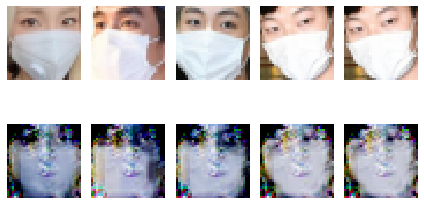

epoch = 2072/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2073/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 2074/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 2075/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 2076/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2077/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2078/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2081/5000, d_loss=0.000, g_loss=0.004                                                                                                     


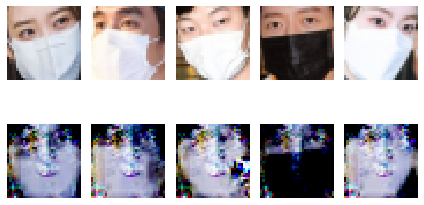

epoch = 2082/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 2083/5000, d_loss=0.002, g_loss=0.009                                                                                                                   
epoch = 2084/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 2085/5000, d_loss=0.023, g_loss=0.035                                                                                                                   
epoch = 2086/5000, d_loss=0.002, g_loss=0.009                                                                                                                   
epoch = 2087/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 2088/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2091/5000, d_loss=0.000, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


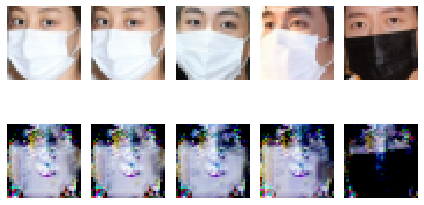

epoch = 2092/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 2093/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2094/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2095/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2096/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2097/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2098/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2101/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


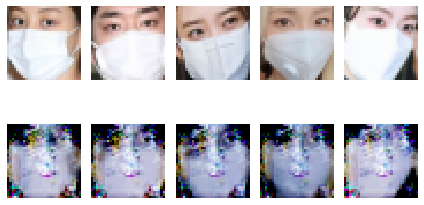

epoch = 2102/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2103/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2104/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2105/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2106/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2107/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2108/5000, d_loss=0.010, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2111/5000, d_loss=0.001, g_loss=0.007                                                                                                     


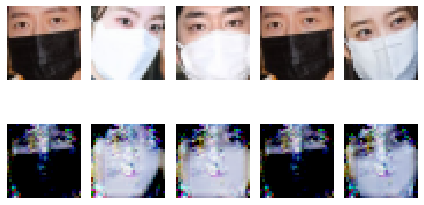

epoch = 2112/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2113/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 2114/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2115/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2116/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2117/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2118/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2121/5000, d_loss=0.000, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


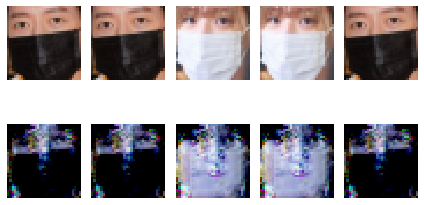

epoch = 2122/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2123/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2124/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2125/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2126/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2127/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2128/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2131/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


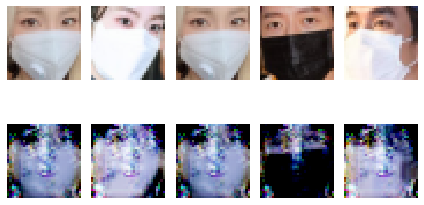

epoch = 2132/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2133/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2134/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2135/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2136/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2137/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2138/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2141/5000, d_loss=0.001, g_loss=0.008                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


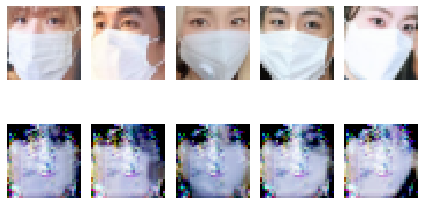

epoch = 2142/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2143/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 2144/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2145/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 2146/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2147/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2148/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2151/5000, d_loss=0.001, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


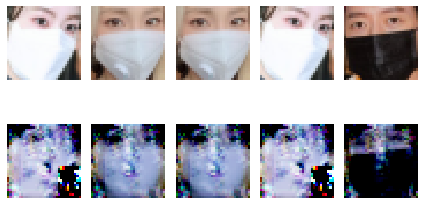

epoch = 2152/5000, d_loss=0.021, g_loss=0.014                                                                                                                   
epoch = 2153/5000, d_loss=0.004, g_loss=0.007                                                                                                                   
epoch = 2154/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2155/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2156/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2157/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2158/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2161/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


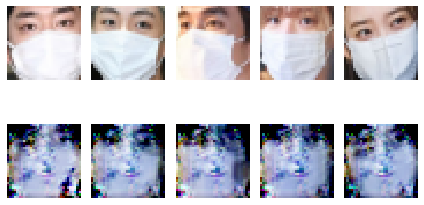

epoch = 2162/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 2163/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2164/5000, d_loss=0.002, g_loss=0.006                                                                                                                   
epoch = 2165/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2166/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 2167/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2168/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2171/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


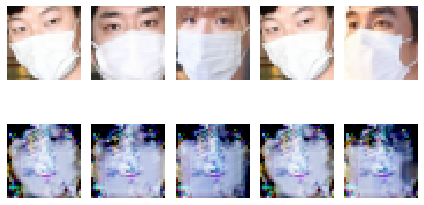

epoch = 2172/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2173/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2174/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2175/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2176/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2177/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2178/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2181/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


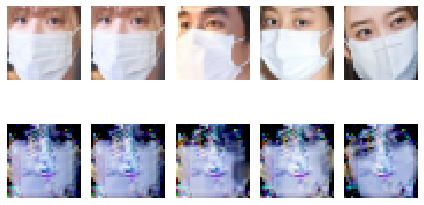

epoch = 2182/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2183/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2184/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2185/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2186/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2187/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2188/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2191/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


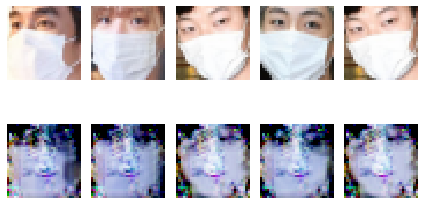

epoch = 2192/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2193/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2194/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2195/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2196/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2197/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2198/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2201/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


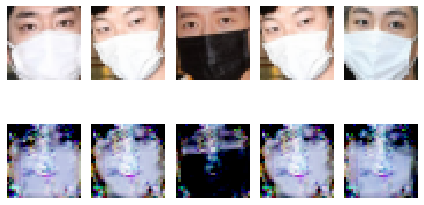

epoch = 2202/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2203/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2204/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2205/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2206/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2207/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2208/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2211/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


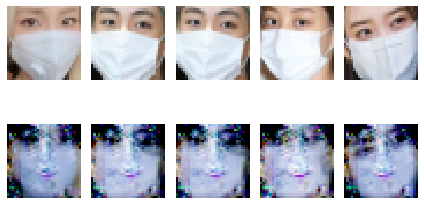

epoch = 2212/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2213/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2214/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2215/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2216/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2217/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2218/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2221/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


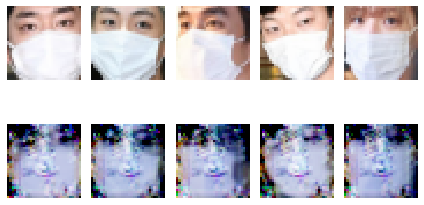

epoch = 2222/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2223/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2224/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2225/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2226/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2227/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2228/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2231/5000, d_loss=0.001, g_loss=0.007                                                                                                     


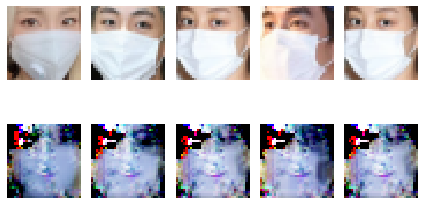

epoch = 2232/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2233/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 2234/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2235/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2236/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2237/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2238/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2241/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


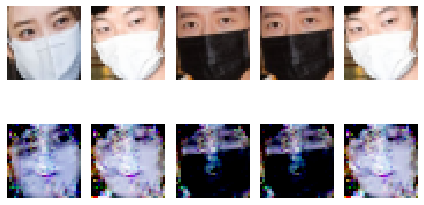

epoch = 2242/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2243/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2244/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2245/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2246/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2247/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2248/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2251/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


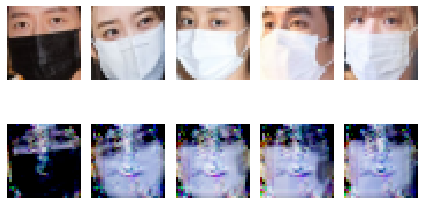

epoch = 2252/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2253/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2254/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2255/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2256/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2257/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2258/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2261/5000, d_loss=0.006, g_loss=0.027                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


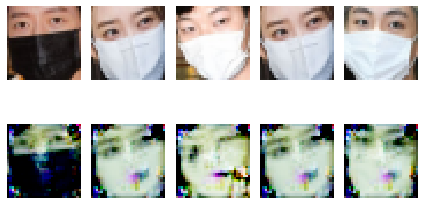

epoch = 2262/5000, d_loss=0.004, g_loss=0.013                                                                                                                   
epoch = 2263/5000, d_loss=0.002, g_loss=0.009                                                                                                                   
epoch = 2264/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 2265/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 2266/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 2267/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2268/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2271/5000, d_loss=0.001, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


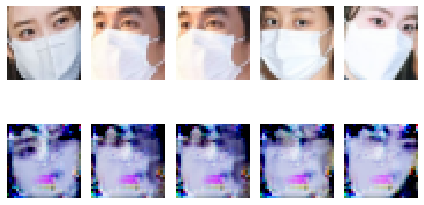

epoch = 2272/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2273/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2274/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2275/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2276/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2277/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2278/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2281/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


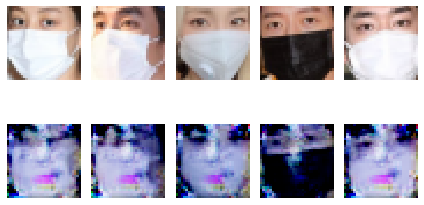

epoch = 2282/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2283/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2284/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2285/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2286/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2287/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2288/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2291/5000, d_loss=0.003, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


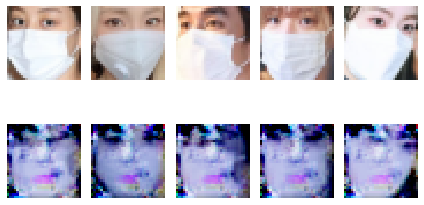

epoch = 2292/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2293/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2294/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2295/5000, d_loss=0.006, g_loss=0.004                                                                                                                   
epoch = 2296/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2297/5000, d_loss=0.319, g_loss=0.010                                                                                                                   
epoch = 2298/5000, d_loss=0.004, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2301/5000, d_loss=0.001, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


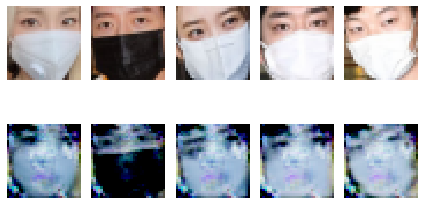

epoch = 2302/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2303/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2304/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2305/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2306/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2307/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2308/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2311/5000, d_loss=0.000, g_loss=0.003                                                                                                     


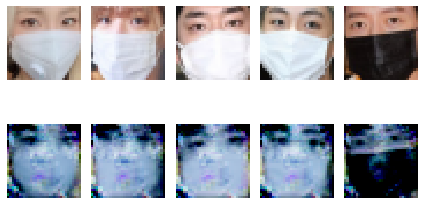

epoch = 2312/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 2313/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2314/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2315/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2316/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2317/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2318/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2321/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


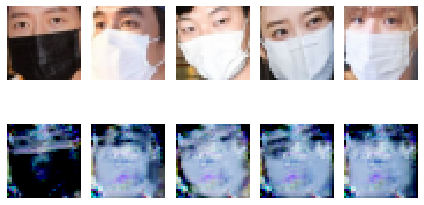

epoch = 2322/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2323/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2324/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2325/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2326/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2327/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2328/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2331/5000, d_loss=0.000, g_loss=0.002                                                                                                     


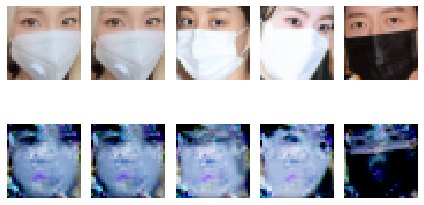

epoch = 2332/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2333/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2334/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2335/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2336/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2337/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2338/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2341/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


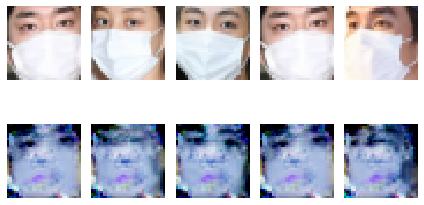

epoch = 2342/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2343/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2344/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2345/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2346/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2347/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2348/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2351/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


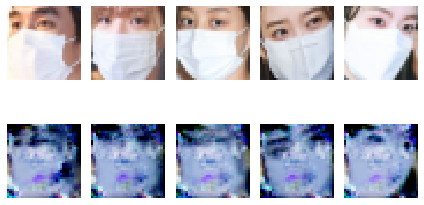

epoch = 2352/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2353/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2354/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2355/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2356/5000, d_loss=0.003, g_loss=0.002                                                                                                                   
epoch = 2357/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2358/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2361/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


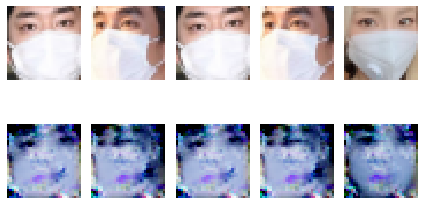

epoch = 2362/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2363/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2364/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2365/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2366/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2367/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2368/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2371/5000, d_loss=0.000, g_loss=0.001                                                                                                     


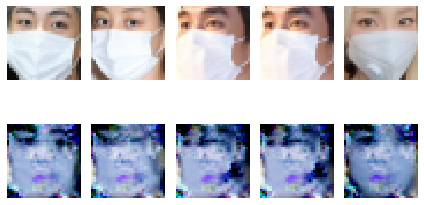

epoch = 2372/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2373/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2374/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2375/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2376/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2377/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2378/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2381/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


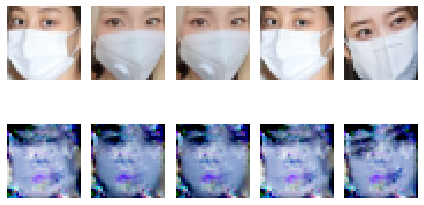

epoch = 2382/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2383/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2384/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2385/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2386/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2387/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2388/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2391/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


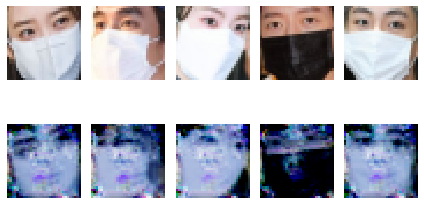

epoch = 2392/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2393/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2394/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2395/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2396/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2397/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2398/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2401/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


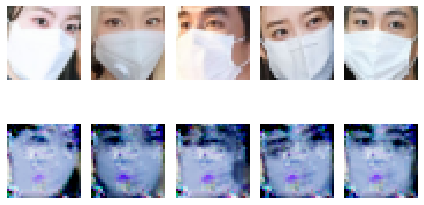

epoch = 2402/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2403/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2404/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2405/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2406/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2407/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2408/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2411/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


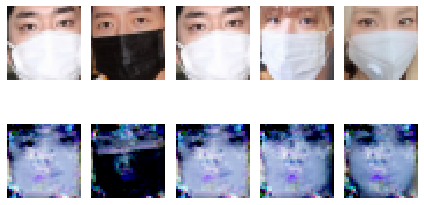

epoch = 2412/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2413/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2414/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2415/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2416/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2417/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2418/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2421/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


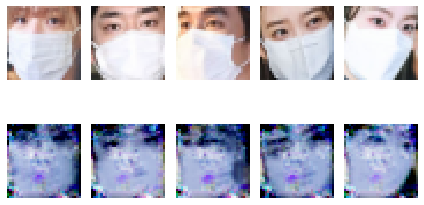

epoch = 2422/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2423/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2424/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2425/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2426/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2427/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2428/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2431/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


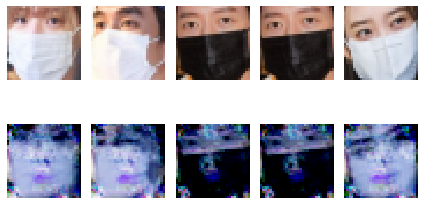

epoch = 2432/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2433/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2434/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2435/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2436/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2437/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2438/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2441/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


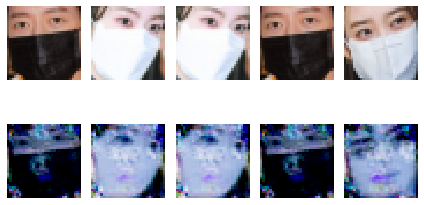

epoch = 2442/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2443/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2444/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2445/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2446/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2447/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2448/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2451/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


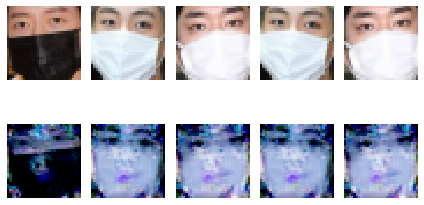

epoch = 2452/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2453/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2454/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2455/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2456/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2457/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2458/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2461/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


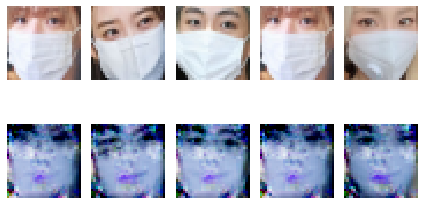

epoch = 2462/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2463/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2464/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2465/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2466/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2467/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2468/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2471/5000, d_loss=0.000, g_loss=0.001                                                                                                     


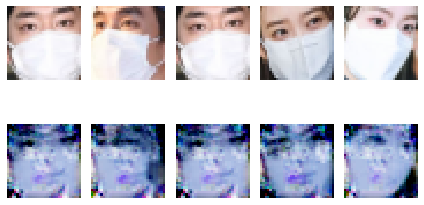

epoch = 2472/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2473/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2474/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2475/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2476/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2477/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2478/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2481/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


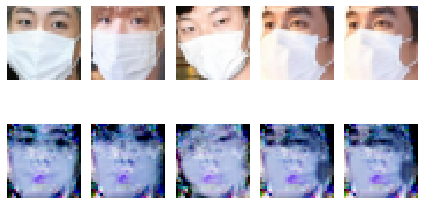

epoch = 2482/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2483/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2484/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2485/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2486/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2487/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2488/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2491/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


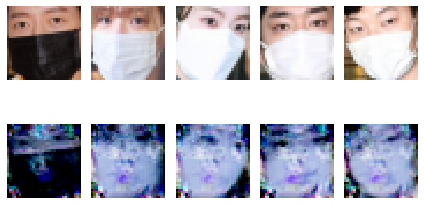

epoch = 2492/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2493/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2494/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2495/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2496/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2497/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2498/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2501/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


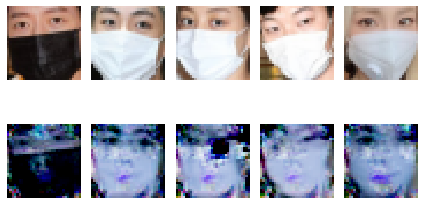

epoch = 2502/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2503/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2504/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2505/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2506/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2507/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2508/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2511/5000, d_loss=0.001, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


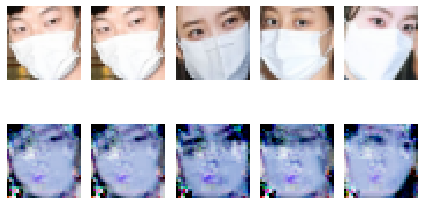

epoch = 2512/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 2513/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 2514/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 2515/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 2516/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2517/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2518/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2521/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


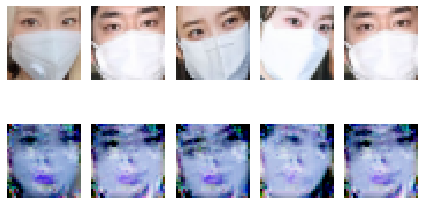

epoch = 2522/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2523/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2524/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2525/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2526/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2527/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2528/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2531/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


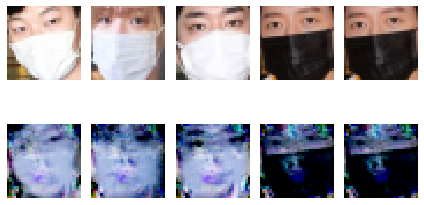

epoch = 2532/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2533/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2534/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2535/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2536/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2537/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2538/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2541/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


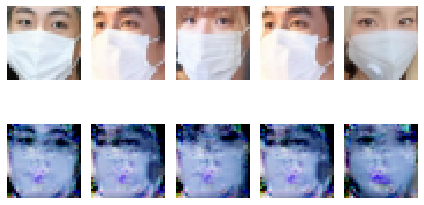

epoch = 2542/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2543/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2544/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2545/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2546/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2547/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2548/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2551/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


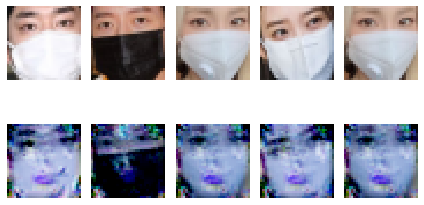

epoch = 2552/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2553/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2554/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2555/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2556/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2557/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2558/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2561/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


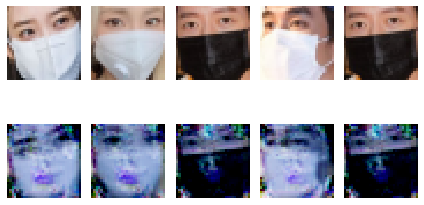

epoch = 2562/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2563/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2564/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2565/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2566/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2567/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2568/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2571/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


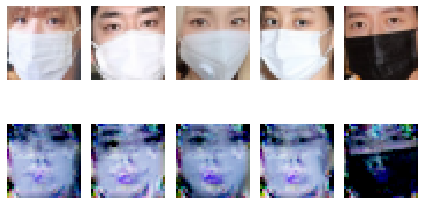

epoch = 2572/5000, d_loss=0.003, g_loss=0.007                                                                                                                   
epoch = 2573/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2574/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2575/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 2576/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2577/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2578/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2581/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


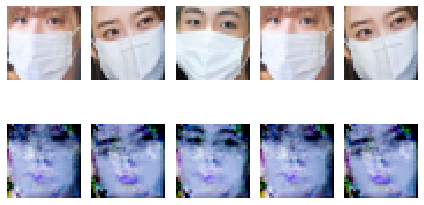

epoch = 2582/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2583/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2584/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2585/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2586/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2587/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2588/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2591/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


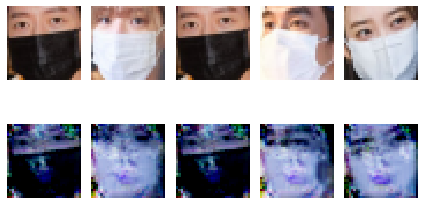

epoch = 2592/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2593/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2594/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2595/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2596/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2597/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2598/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2601/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


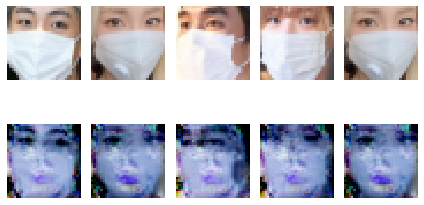

epoch = 2602/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2603/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2604/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2605/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2606/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2607/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2608/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2611/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


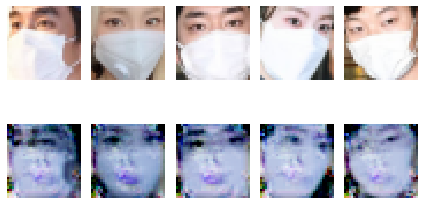

epoch = 2612/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2613/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2614/5000, d_loss=0.003, g_loss=0.005                                                                                                                   
epoch = 2615/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2616/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 2617/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 2618/5000, d_loss=0.006, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2621/5000, d_loss=0.012, g_loss=0.010                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


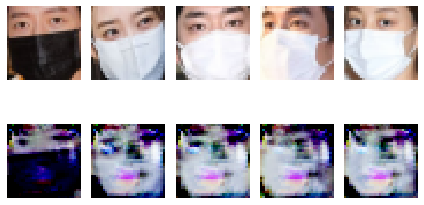

epoch = 2622/5000, d_loss=0.005, g_loss=0.009                                                                                                                   
epoch = 2623/5000, d_loss=0.006, g_loss=0.009                                                                                                                   
epoch = 2624/5000, d_loss=0.011, g_loss=0.012                                                                                                                   
epoch = 2625/5000, d_loss=0.008, g_loss=0.011                                                                                                                   
epoch = 2626/5000, d_loss=0.005, g_loss=0.008                                                                                                                   
epoch = 2627/5000, d_loss=0.004, g_loss=0.006                                                                                                                   
epoch = 2628/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2631/5000, d_loss=0.002, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


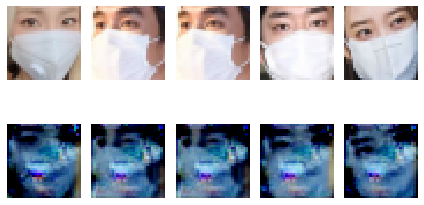

epoch = 2632/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 2633/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2634/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2635/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2636/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2637/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2638/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2641/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


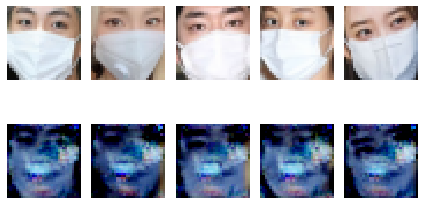

epoch = 2642/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2643/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2644/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2645/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2646/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2647/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2648/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2651/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


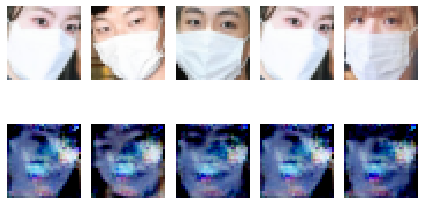

epoch = 2652/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2653/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2654/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2655/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 2656/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2657/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2658/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2661/5000, d_loss=0.001, g_loss=0.001                                                                                                     


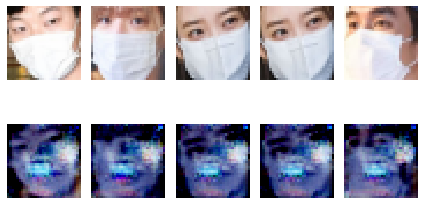

epoch = 2662/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2663/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2664/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2665/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2666/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2667/5000, d_loss=0.003, g_loss=0.002                                                                                                                   
epoch = 2668/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2671/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


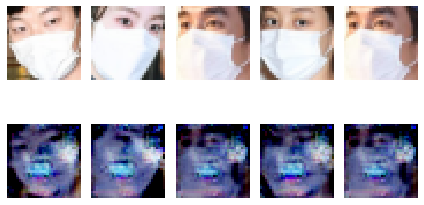

epoch = 2672/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2673/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2674/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2675/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2676/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2677/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2678/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2681/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


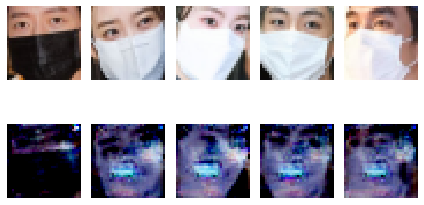

epoch = 2682/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2683/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2684/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2685/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2686/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2687/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2688/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2691/5000, d_loss=0.001, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


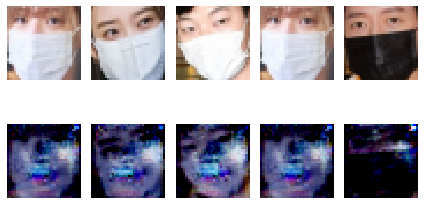

epoch = 2692/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2693/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2694/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2695/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2696/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2697/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2698/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2701/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


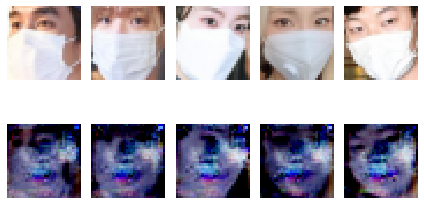

epoch = 2702/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2703/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2704/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 2705/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 2706/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 2707/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2708/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2711/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


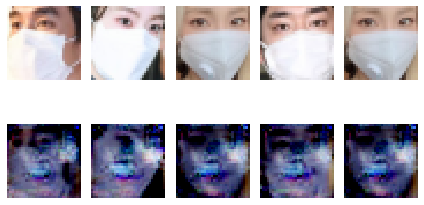

epoch = 2712/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2713/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2714/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2715/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2716/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2717/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2718/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2721/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


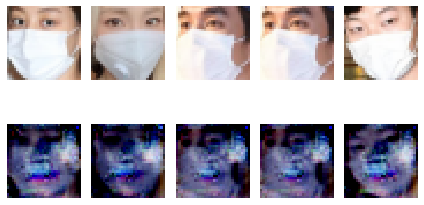

epoch = 2722/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2723/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2724/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2725/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2726/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 2727/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2728/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2731/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


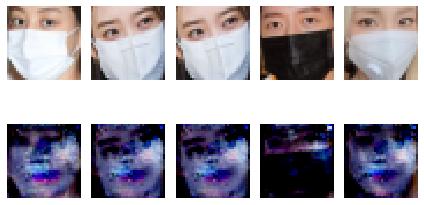

epoch = 2732/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2733/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2734/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2735/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2736/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2737/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 2738/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2741/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


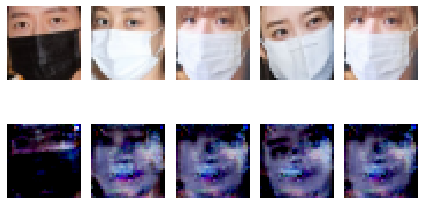

epoch = 2742/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2743/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2744/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2745/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2746/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2747/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2748/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2751/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


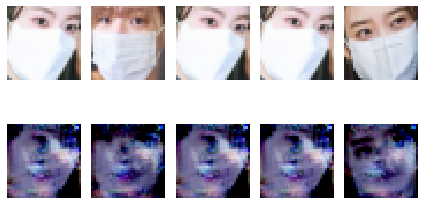

epoch = 2752/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2753/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2754/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2755/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2756/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2757/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2758/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2761/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


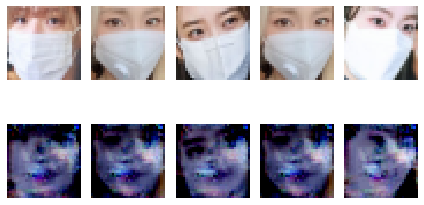

epoch = 2762/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2763/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2764/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2765/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2766/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2767/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2768/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2771/5000, d_loss=0.002, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


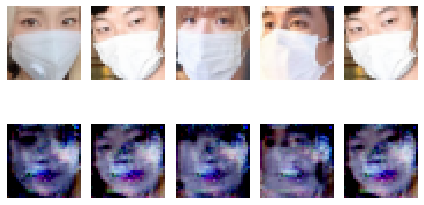

epoch = 2772/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2773/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2774/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2775/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2776/5000, d_loss=0.003, g_loss=0.006                                                                                                                   
epoch = 2777/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2778/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2781/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


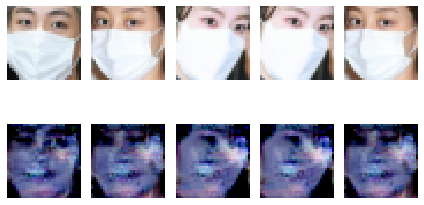

epoch = 2782/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2783/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2784/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 2785/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2786/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2787/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 2788/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2791/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


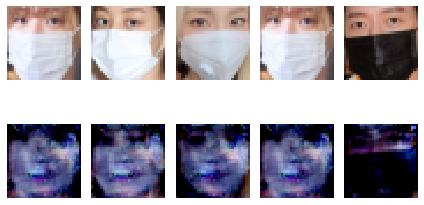

epoch = 2792/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2793/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2794/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2795/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2796/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2797/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2798/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2801/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


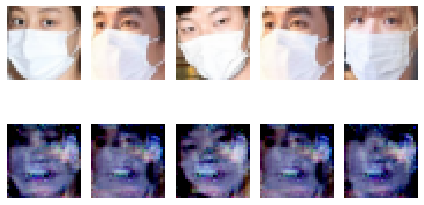

epoch = 2802/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2803/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2804/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2805/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2806/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2807/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2808/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2811/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


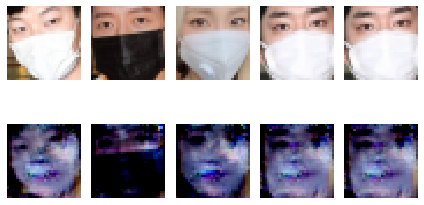

epoch = 2812/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2813/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2814/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2815/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2816/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2817/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 2818/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2821/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


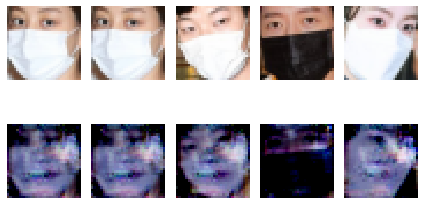

epoch = 2822/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2823/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2824/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2825/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2826/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2827/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2828/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2831/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


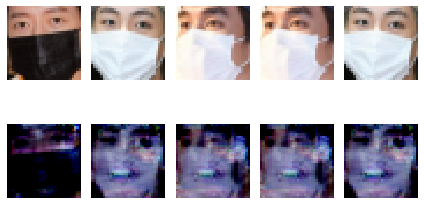

epoch = 2832/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2833/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2834/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2835/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2836/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2837/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2838/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2841/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


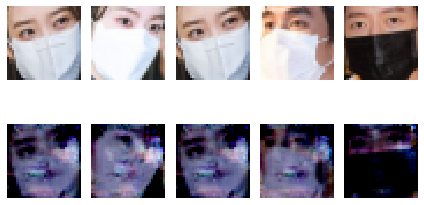

epoch = 2842/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2843/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2844/5000, d_loss=0.007, g_loss=0.014                                                                                                                   
epoch = 2845/5000, d_loss=0.023, g_loss=0.037                                                                                                                   
epoch = 2846/5000, d_loss=0.008, g_loss=0.011                                                                                                                   
epoch = 2847/5000, d_loss=0.007, g_loss=0.007                                                                                                                   
epoch = 2848/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2851/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


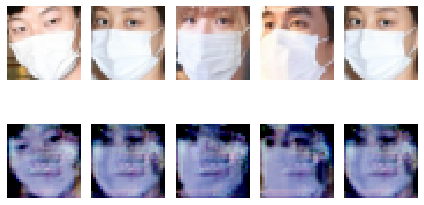

epoch = 2852/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2853/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2854/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2855/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2856/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2857/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2858/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2861/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


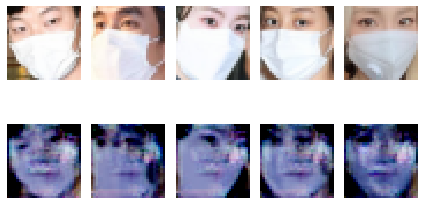

epoch = 2862/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2863/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2864/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2865/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2866/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2867/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2868/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2871/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


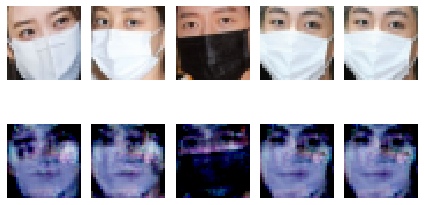

epoch = 2872/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2873/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2874/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2875/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2876/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2877/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2878/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2881/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


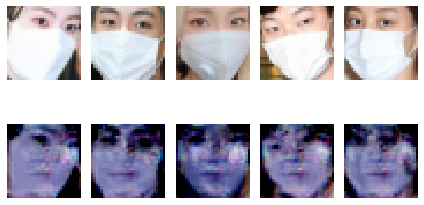

epoch = 2882/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2883/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2884/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2885/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2886/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2887/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2888/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2891/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


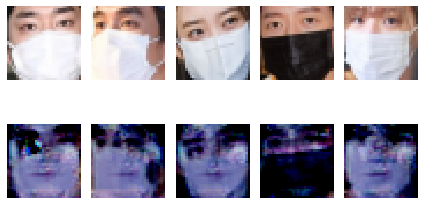

epoch = 2892/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2893/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2894/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2895/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2896/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 2897/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 2898/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2901/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


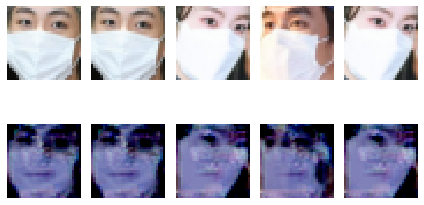

epoch = 2902/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2903/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2904/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2905/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2906/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2907/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2908/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2911/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


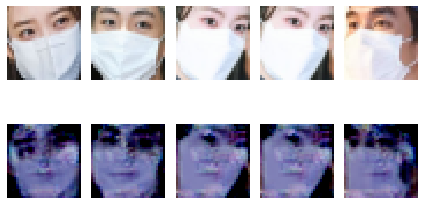

epoch = 2912/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2913/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2914/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2915/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 2916/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2917/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2918/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2921/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


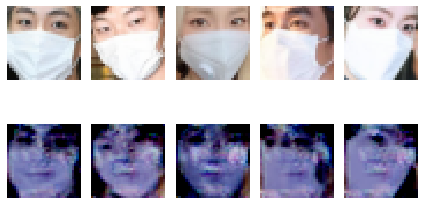

epoch = 2922/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2923/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2924/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2925/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2926/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2927/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2928/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2931/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


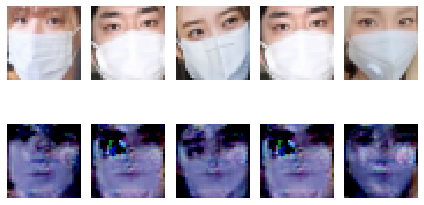

epoch = 2932/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2933/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2934/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2935/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2936/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2937/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2938/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2941/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


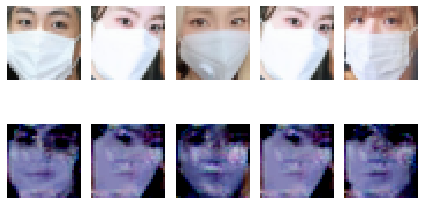

epoch = 2942/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2943/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2944/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2945/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 2946/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2947/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 2948/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2951/5000, d_loss=0.064, g_loss=0.016                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


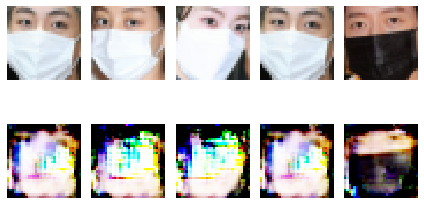

epoch = 2952/5000, d_loss=0.007, g_loss=0.010                                                                                                                   
epoch = 2953/5000, d_loss=0.006, g_loss=0.008                                                                                                                   
epoch = 2954/5000, d_loss=0.007, g_loss=0.010                                                                                                                   
epoch = 2955/5000, d_loss=0.019, g_loss=0.024                                                                                                                   
epoch = 2956/5000, d_loss=0.035, g_loss=0.031                                                                                                                   
epoch = 2957/5000, d_loss=0.009, g_loss=0.012                                                                                                                   
epoch = 2958/5000, d_loss=0.009, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2961/5000, d_loss=0.027, g_loss=0.044                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


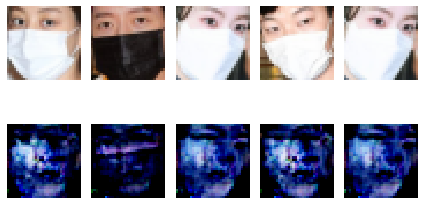

epoch = 2962/5000, d_loss=0.014, g_loss=0.017                                                                                                                   
epoch = 2963/5000, d_loss=0.015, g_loss=0.017                                                                                                                   
epoch = 2964/5000, d_loss=0.017, g_loss=0.015                                                                                                                   
epoch = 2965/5000, d_loss=0.021, g_loss=0.015                                                                                                                   
epoch = 2966/5000, d_loss=0.005, g_loss=0.007                                                                                                                   
epoch = 2967/5000, d_loss=0.005, g_loss=0.005                                                                                                                   
epoch = 2968/5000, d_loss=0.005, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2971/5000, d_loss=0.006, g_loss=0.003                                                                                                     


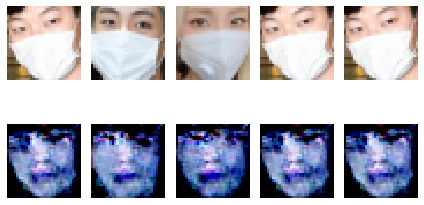

epoch = 2972/5000, d_loss=0.006, g_loss=0.003                                                                                                                   
epoch = 2973/5000, d_loss=0.006, g_loss=0.003                                                                                                                   
epoch = 2974/5000, d_loss=0.005, g_loss=0.002                                                                                                                   
epoch = 2975/5000, d_loss=0.005, g_loss=0.002                                                                                                                   
epoch = 2976/5000, d_loss=0.005, g_loss=0.002                                                                                                                   
epoch = 2977/5000, d_loss=0.004, g_loss=0.002                                                                                                                   
epoch = 2978/5000, d_loss=0.004, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2981/5000, d_loss=0.003, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


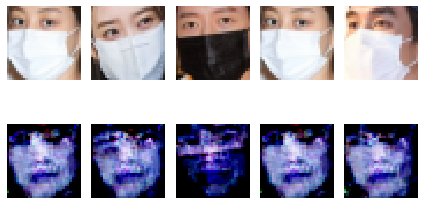

epoch = 2982/5000, d_loss=0.003, g_loss=0.001                                                                                                                   
epoch = 2983/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 2984/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 2985/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 2986/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 2987/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 2988/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 2991/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


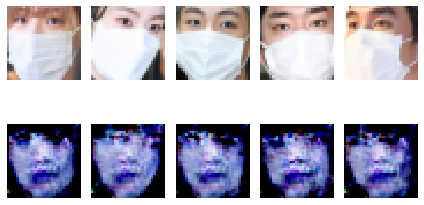

epoch = 2992/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2993/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 2994/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 2995/5000, d_loss=0.003, g_loss=0.001                                                                                                                   
epoch = 2996/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 2997/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 2998/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3001/5000, d_loss=0.010, g_loss=0.009                                                                                                     


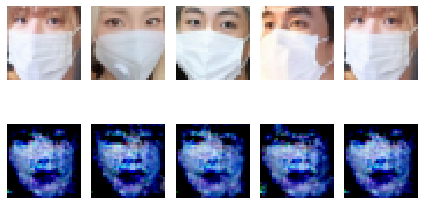

epoch = 3002/5000, d_loss=0.008, g_loss=0.008                                                                                                                   
epoch = 3003/5000, d_loss=0.020, g_loss=0.089                                                                                                                   
epoch = 3004/5000, d_loss=0.014, g_loss=0.032                                                                                                                   
epoch = 3005/5000, d_loss=0.024, g_loss=0.040                                                                                                                   
epoch = 3006/5000, d_loss=0.010, g_loss=0.015                                                                                                                   
epoch = 3007/5000, d_loss=0.016, g_loss=0.013                                                                                                                   
epoch = 3008/5000, d_loss=0.009, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3011/5000, d_loss=0.006, g_loss=0.006                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


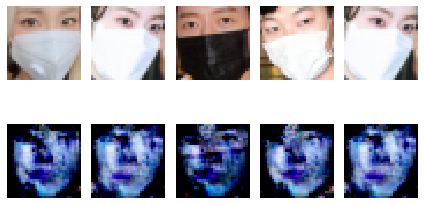

epoch = 3012/5000, d_loss=0.005, g_loss=0.006                                                                                                                   
epoch = 3013/5000, d_loss=0.005, g_loss=0.004                                                                                                                   
epoch = 3014/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 3015/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 3016/5000, d_loss=0.005, g_loss=0.005                                                                                                                   
epoch = 3017/5000, d_loss=0.007, g_loss=0.008                                                                                                                   
epoch = 3018/5000, d_loss=0.013, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3021/5000, d_loss=0.008, g_loss=0.010                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


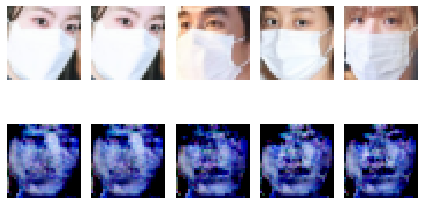

epoch = 3022/5000, d_loss=0.008, g_loss=0.007                                                                                                                   
epoch = 3023/5000, d_loss=0.005, g_loss=0.005                                                                                                                   
epoch = 3024/5000, d_loss=0.004, g_loss=0.006                                                                                                                   
epoch = 3025/5000, d_loss=0.004, g_loss=0.009                                                                                                                   
epoch = 3026/5000, d_loss=0.005, g_loss=0.007                                                                                                                   
epoch = 3027/5000, d_loss=0.005, g_loss=0.007                                                                                                                   
epoch = 3028/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3031/5000, d_loss=0.003, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


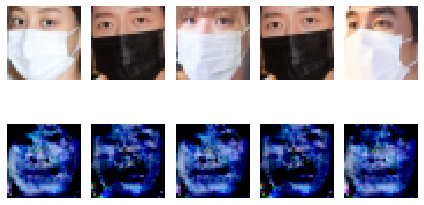

epoch = 3032/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 3033/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 3034/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 3035/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3036/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3037/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 3038/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3041/5000, d_loss=0.002, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


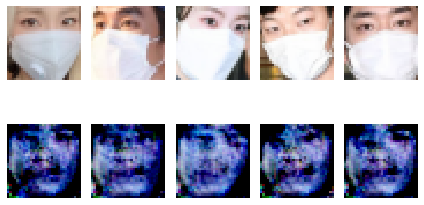

epoch = 3042/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 3043/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 3044/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 3045/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 3046/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 3047/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3048/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3051/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


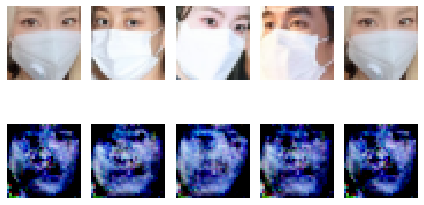

epoch = 3052/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3053/5000, d_loss=0.004, g_loss=0.002                                                                                                                   
epoch = 3054/5000, d_loss=0.006, g_loss=0.004                                                                                                                   
epoch = 3055/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3056/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3057/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3058/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3061/5000, d_loss=0.001, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


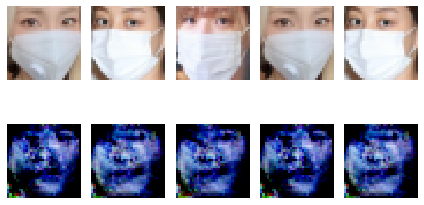

epoch = 3062/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3063/5000, d_loss=0.004, g_loss=0.007                                                                                                                   
epoch = 3064/5000, d_loss=0.006, g_loss=0.009                                                                                                                   
epoch = 3065/5000, d_loss=0.007, g_loss=0.009                                                                                                                   
epoch = 3066/5000, d_loss=0.008, g_loss=0.010                                                                                                                   
epoch = 3067/5000, d_loss=0.032, g_loss=0.021                                                                                                                   
epoch = 3068/5000, d_loss=0.022, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3071/5000, d_loss=0.010, g_loss=0.027                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


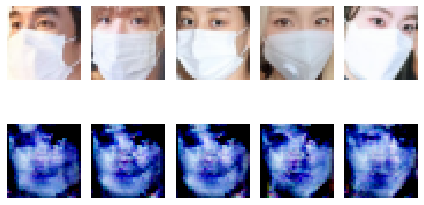

epoch = 3072/5000, d_loss=0.007, g_loss=0.011                                                                                                                   
epoch = 3073/5000, d_loss=0.006, g_loss=0.011                                                                                                                   
epoch = 3074/5000, d_loss=0.008, g_loss=0.009                                                                                                                   
epoch = 3075/5000, d_loss=0.008, g_loss=0.016                                                                                                                   
epoch = 3076/5000, d_loss=0.016, g_loss=0.009                                                                                                                   
epoch = 3077/5000, d_loss=0.023, g_loss=0.019                                                                                                                   
epoch = 3078/5000, d_loss=0.006, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3081/5000, d_loss=0.009, g_loss=0.008                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


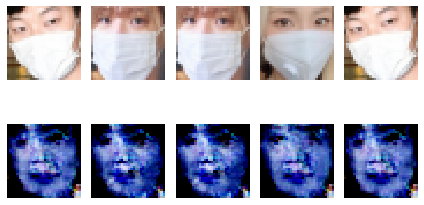

epoch = 3082/5000, d_loss=0.026, g_loss=0.008                                                                                                                   
epoch = 3083/5000, d_loss=0.007, g_loss=0.009                                                                                                                   
epoch = 3084/5000, d_loss=0.007, g_loss=0.012                                                                                                                   
epoch = 3085/5000, d_loss=0.008, g_loss=0.008                                                                                                                   
epoch = 3086/5000, d_loss=0.003, g_loss=0.004                                                                                                                   
epoch = 3087/5000, d_loss=0.004, g_loss=0.004                                                                                                                   
epoch = 3088/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3091/5000, d_loss=0.002, g_loss=0.002                                                                                                     


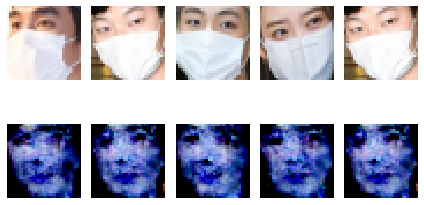

epoch = 3092/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3093/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3094/5000, d_loss=0.003, g_loss=0.002                                                                                                                   
epoch = 3095/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3096/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3097/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 3098/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3101/5000, d_loss=0.002, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


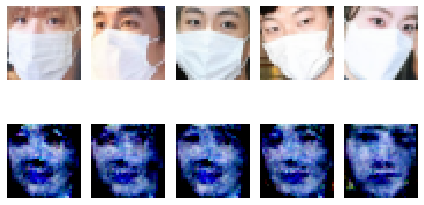

epoch = 3102/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3103/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 3104/5000, d_loss=0.004, g_loss=0.004                                                                                                                   
epoch = 3105/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3106/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3107/5000, d_loss=0.017, g_loss=0.011                                                                                                                   
epoch = 3108/5000, d_loss=0.005, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3111/5000, d_loss=0.013, g_loss=0.030                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


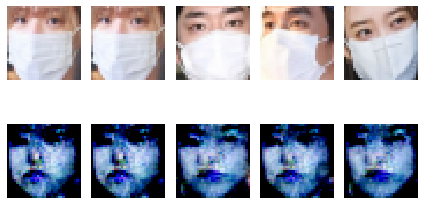

epoch = 3112/5000, d_loss=0.007, g_loss=0.014                                                                                                                   
epoch = 3113/5000, d_loss=0.020, g_loss=0.036                                                                                                                   
epoch = 3114/5000, d_loss=0.047, g_loss=0.051                                                                                                                   
epoch = 3115/5000, d_loss=0.018, g_loss=0.075                                                                                                                   
epoch = 3116/5000, d_loss=0.064, g_loss=0.103                                                                                                                   
epoch = 3117/5000, d_loss=0.016, g_loss=0.054                                                                                                                   
epoch = 3118/5000, d_loss=0.007, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3121/5000, d_loss=0.029, g_loss=0.103                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


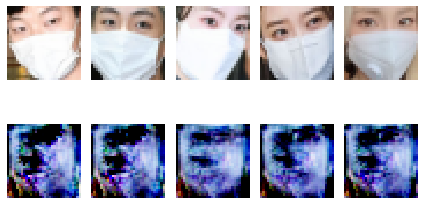

epoch = 3122/5000, d_loss=0.013, g_loss=0.017                                                                                                                   
epoch = 3123/5000, d_loss=0.010, g_loss=0.045                                                                                                                   
epoch = 3124/5000, d_loss=0.015, g_loss=0.046                                                                                                                   
epoch = 3125/5000, d_loss=0.011, g_loss=0.031                                                                                                                   
epoch = 3126/5000, d_loss=0.012, g_loss=0.057                                                                                                                   
epoch = 3127/5000, d_loss=0.018, g_loss=0.031                                                                                                                   
epoch = 3128/5000, d_loss=0.073, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3131/5000, d_loss=0.030, g_loss=0.145                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


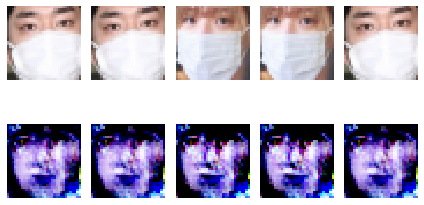

epoch = 3132/5000, d_loss=0.018, g_loss=0.115                                                                                                                   
epoch = 3133/5000, d_loss=0.033, g_loss=0.139                                                                                                                   
epoch = 3134/5000, d_loss=0.013, g_loss=0.079                                                                                                                   
epoch = 3135/5000, d_loss=0.018, g_loss=0.120                                                                                                                   
epoch = 3136/5000, d_loss=0.011, g_loss=0.096                                                                                                                   
epoch = 3137/5000, d_loss=0.029, g_loss=0.195                                                                                                                   
epoch = 3138/5000, d_loss=0.014, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3141/5000, d_loss=0.011, g_loss=0.288                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


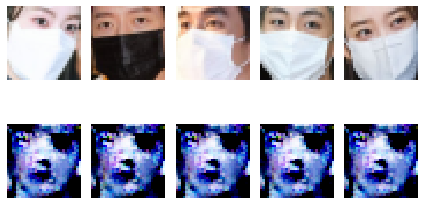

epoch = 3142/5000, d_loss=0.009, g_loss=0.217                                                                                                                   
epoch = 3143/5000, d_loss=0.019, g_loss=0.190                                                                                                                   
epoch = 3144/5000, d_loss=0.015, g_loss=0.278                                                                                                                   
epoch = 3145/5000, d_loss=0.013, g_loss=0.225                                                                                                                   
epoch = 3146/5000, d_loss=0.020, g_loss=0.114                                                                                                                   
epoch = 3147/5000, d_loss=0.012, g_loss=0.186                                                                                                                   
epoch = 3148/5000, d_loss=0.020, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3151/5000, d_loss=0.012, g_loss=0.074                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


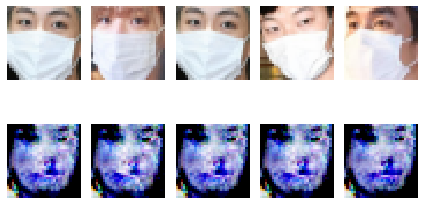

epoch = 3152/5000, d_loss=0.013, g_loss=0.057                                                                                                                   
epoch = 3153/5000, d_loss=0.011, g_loss=0.059                                                                                                                   
epoch = 3154/5000, d_loss=0.014, g_loss=0.147                                                                                                                   
epoch = 3155/5000, d_loss=0.010, g_loss=0.192                                                                                                                   
epoch = 3156/5000, d_loss=0.011, g_loss=0.162                                                                                                                   
epoch = 3157/5000, d_loss=0.009, g_loss=0.175                                                                                                                   
epoch = 3158/5000, d_loss=0.012, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3161/5000, d_loss=0.016, g_loss=0.251                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


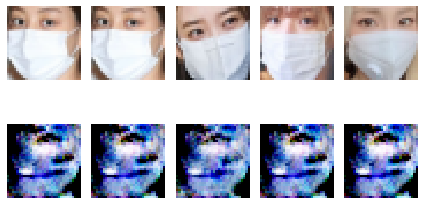

epoch = 3162/5000, d_loss=0.010, g_loss=0.246                                                                                                                   
epoch = 3163/5000, d_loss=0.014, g_loss=0.200                                                                                                                   
epoch = 3164/5000, d_loss=0.020, g_loss=0.330                                                                                                                   
epoch = 3165/5000, d_loss=0.016, g_loss=0.207                                                                                                                   
epoch = 3166/5000, d_loss=0.022, g_loss=0.218                                                                                                                   
epoch = 3167/5000, d_loss=0.025, g_loss=0.303                                                                                                                   
epoch = 3168/5000, d_loss=0.052, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3171/5000, d_loss=0.031, g_loss=0.345                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


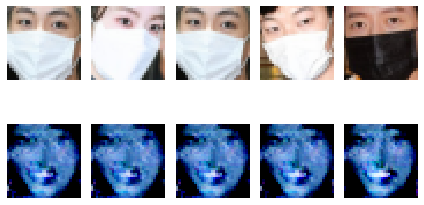

epoch = 3172/5000, d_loss=0.011, g_loss=0.193                                                                                                                   
epoch = 3173/5000, d_loss=0.012, g_loss=0.215                                                                                                                   
epoch = 3174/5000, d_loss=0.011, g_loss=0.066                                                                                                                   
epoch = 3175/5000, d_loss=0.012, g_loss=0.137                                                                                                                   
epoch = 3176/5000, d_loss=0.012, g_loss=0.185                                                                                                                   
epoch = 3177/5000, d_loss=0.024, g_loss=0.240                                                                                                                   
epoch = 3178/5000, d_loss=0.022, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3181/5000, d_loss=0.021, g_loss=0.228                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


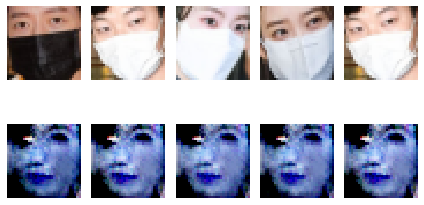

epoch = 3182/5000, d_loss=0.020, g_loss=0.192                                                                                                                   
epoch = 3183/5000, d_loss=0.023, g_loss=0.263                                                                                                                   
epoch = 3184/5000, d_loss=0.019, g_loss=0.157                                                                                                                   
epoch = 3185/5000, d_loss=0.010, g_loss=0.102                                                                                                                   
epoch = 3186/5000, d_loss=0.020, g_loss=0.160                                                                                                                   
epoch = 3187/5000, d_loss=0.010, g_loss=0.084                                                                                                                   
epoch = 3188/5000, d_loss=0.015, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3191/5000, d_loss=0.023, g_loss=0.129                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


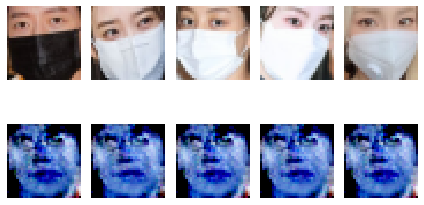

epoch = 3192/5000, d_loss=0.020, g_loss=0.170                                                                                                                   
epoch = 3193/5000, d_loss=0.017, g_loss=0.344                                                                                                                   
epoch = 3194/5000, d_loss=0.038, g_loss=0.281                                                                                                                   
epoch = 3195/5000, d_loss=0.045, g_loss=0.176                                                                                                                   
epoch = 3196/5000, d_loss=0.026, g_loss=0.137                                                                                                                   
epoch = 3197/5000, d_loss=0.023, g_loss=0.123                                                                                                                   
epoch = 3198/5000, d_loss=0.022, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3201/5000, d_loss=0.016, g_loss=0.052                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


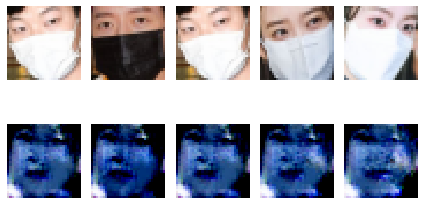

epoch = 3202/5000, d_loss=0.014, g_loss=0.226                                                                                                                   
epoch = 3203/5000, d_loss=0.009, g_loss=0.124                                                                                                                   
epoch = 3204/5000, d_loss=0.028, g_loss=0.148                                                                                                                   
epoch = 3205/5000, d_loss=0.012, g_loss=0.226                                                                                                                   
epoch = 3206/5000, d_loss=0.032, g_loss=0.132                                                                                                                   
epoch = 3207/5000, d_loss=0.018, g_loss=0.120                                                                                                                   
epoch = 3208/5000, d_loss=0.008, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3211/5000, d_loss=0.013, g_loss=0.197                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


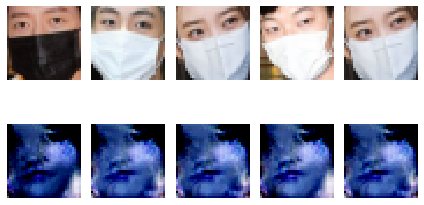

epoch = 3212/5000, d_loss=0.007, g_loss=0.201                                                                                                                   
epoch = 3213/5000, d_loss=0.008, g_loss=0.188                                                                                                                   
epoch = 3214/5000, d_loss=0.010, g_loss=0.173                                                                                                                   
epoch = 3215/5000, d_loss=0.009, g_loss=0.246                                                                                                                   
epoch = 3216/5000, d_loss=0.007, g_loss=0.231                                                                                                                   
epoch = 3217/5000, d_loss=0.014, g_loss=0.251                                                                                                                   
epoch = 3218/5000, d_loss=0.012, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3221/5000, d_loss=0.015, g_loss=0.312                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


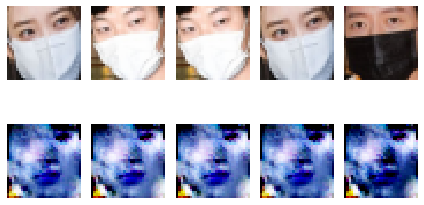

epoch = 3222/5000, d_loss=0.014, g_loss=0.259                                                                                                                   
epoch = 3223/5000, d_loss=0.011, g_loss=0.203                                                                                                                   
epoch = 3224/5000, d_loss=0.019, g_loss=0.237                                                                                                                   
epoch = 3225/5000, d_loss=0.007, g_loss=0.089                                                                                                                   
epoch = 3226/5000, d_loss=0.011, g_loss=0.064                                                                                                                   
epoch = 3227/5000, d_loss=0.009, g_loss=0.131                                                                                                                   
epoch = 3228/5000, d_loss=0.012, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3231/5000, d_loss=0.015, g_loss=0.102                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


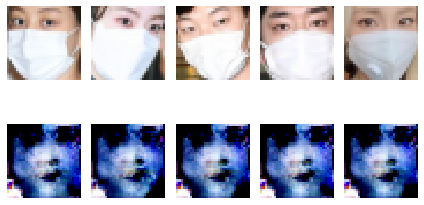

epoch = 3232/5000, d_loss=0.015, g_loss=0.173                                                                                                                   
epoch = 3233/5000, d_loss=0.017, g_loss=0.149                                                                                                                   
epoch = 3234/5000, d_loss=0.018, g_loss=0.222                                                                                                                   
epoch = 3235/5000, d_loss=0.017, g_loss=0.200                                                                                                                   
epoch = 3236/5000, d_loss=0.011, g_loss=0.158                                                                                                                   
epoch = 3237/5000, d_loss=0.007, g_loss=0.095                                                                                                                   
epoch = 3238/5000, d_loss=0.008, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3241/5000, d_loss=0.008, g_loss=0.170                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


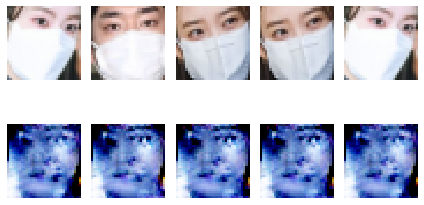

epoch = 3242/5000, d_loss=0.006, g_loss=0.076                                                                                                                   
epoch = 3243/5000, d_loss=0.011, g_loss=0.275                                                                                                                   
epoch = 3244/5000, d_loss=0.014, g_loss=0.247                                                                                                                   
epoch = 3245/5000, d_loss=0.015, g_loss=0.263                                                                                                                   
epoch = 3246/5000, d_loss=0.030, g_loss=0.212                                                                                                                   
epoch = 3247/5000, d_loss=0.020, g_loss=0.140                                                                                                                   
epoch = 3248/5000, d_loss=0.011, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3251/5000, d_loss=0.014, g_loss=0.248                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


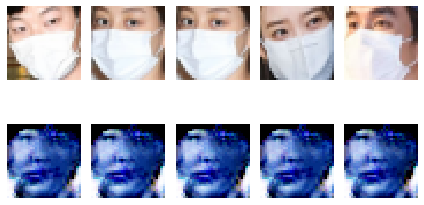

epoch = 3252/5000, d_loss=0.018, g_loss=0.385                                                                                                                   
epoch = 3253/5000, d_loss=0.011, g_loss=0.362                                                                                                                   
epoch = 3254/5000, d_loss=0.033, g_loss=0.420                                                                                                                   
epoch = 3255/5000, d_loss=0.019, g_loss=0.278                                                                                                                   
epoch = 3256/5000, d_loss=0.010, g_loss=0.254                                                                                                                   
epoch = 3257/5000, d_loss=0.007, g_loss=0.244                                                                                                                   
epoch = 3258/5000, d_loss=0.007, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3261/5000, d_loss=0.018, g_loss=0.149                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


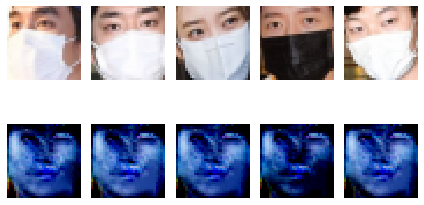

epoch = 3262/5000, d_loss=0.011, g_loss=0.117                                                                                                                   
epoch = 3263/5000, d_loss=0.008, g_loss=0.154                                                                                                                   
epoch = 3264/5000, d_loss=0.009, g_loss=0.218                                                                                                                   
epoch = 3265/5000, d_loss=0.018, g_loss=0.233                                                                                                                   
epoch = 3266/5000, d_loss=0.009, g_loss=0.157                                                                                                                   
epoch = 3267/5000, d_loss=0.008, g_loss=0.174                                                                                                                   
epoch = 3268/5000, d_loss=0.023, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3271/5000, d_loss=0.015, g_loss=0.131                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


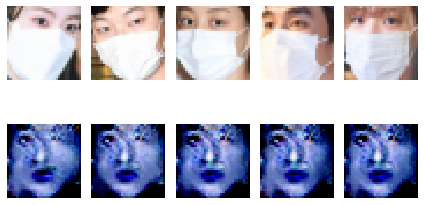

epoch = 3272/5000, d_loss=0.005, g_loss=0.118                                                                                                                   
epoch = 3273/5000, d_loss=0.018, g_loss=0.066                                                                                                                   
epoch = 3274/5000, d_loss=0.014, g_loss=0.071                                                                                                                   
epoch = 3275/5000, d_loss=0.016, g_loss=0.087                                                                                                                   
epoch = 3276/5000, d_loss=0.017, g_loss=0.139                                                                                                                   
epoch = 3277/5000, d_loss=0.013, g_loss=0.094                                                                                                                   
epoch = 3278/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3281/5000, d_loss=0.005, g_loss=0.100                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


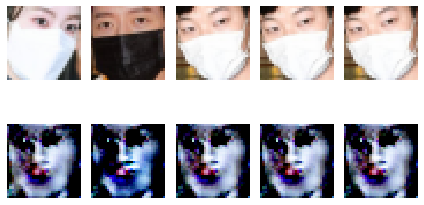

epoch = 3282/5000, d_loss=0.010, g_loss=0.166                                                                                                                   
epoch = 3283/5000, d_loss=0.007, g_loss=0.186                                                                                                                   
epoch = 3284/5000, d_loss=0.142, g_loss=0.077                                                                                                                   
epoch = 3285/5000, d_loss=0.012, g_loss=0.175                                                                                                                   
epoch = 3286/5000, d_loss=0.008, g_loss=0.106                                                                                                                   
epoch = 3287/5000, d_loss=0.006, g_loss=0.178                                                                                                                   
epoch = 3288/5000, d_loss=0.007, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3291/5000, d_loss=0.007, g_loss=0.228                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


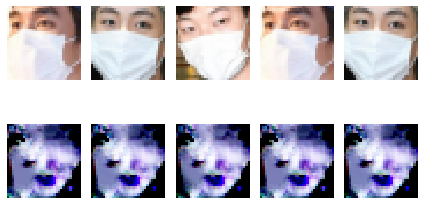

epoch = 3292/5000, d_loss=0.004, g_loss=0.353                                                                                                                   
epoch = 3293/5000, d_loss=0.005, g_loss=0.330                                                                                                                   
epoch = 3294/5000, d_loss=0.005, g_loss=0.266                                                                                                                   
epoch = 3295/5000, d_loss=0.004, g_loss=0.291                                                                                                                   
epoch = 3296/5000, d_loss=0.007, g_loss=0.335                                                                                                                   
epoch = 3297/5000, d_loss=0.009, g_loss=0.291                                                                                                                   
epoch = 3298/5000, d_loss=0.006, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3301/5000, d_loss=0.010, g_loss=0.423                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


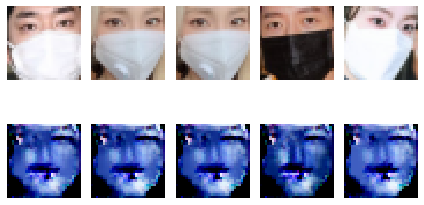

epoch = 3302/5000, d_loss=0.018, g_loss=0.287                                                                                                                   
epoch = 3303/5000, d_loss=0.012, g_loss=0.280                                                                                                                   
epoch = 3304/5000, d_loss=0.010, g_loss=0.157                                                                                                                   
epoch = 3305/5000, d_loss=0.007, g_loss=0.233                                                                                                                   
epoch = 3306/5000, d_loss=0.006, g_loss=0.304                                                                                                                   
epoch = 3307/5000, d_loss=0.005, g_loss=0.187                                                                                                                   
epoch = 3308/5000, d_loss=0.010, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3311/5000, d_loss=0.021, g_loss=0.161                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


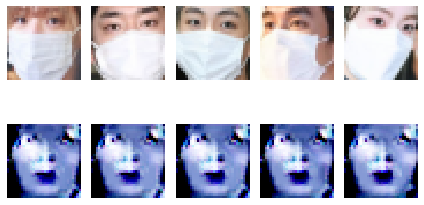

epoch = 3312/5000, d_loss=0.008, g_loss=0.376                                                                                                                   
epoch = 3313/5000, d_loss=0.005, g_loss=0.228                                                                                                                   
epoch = 3314/5000, d_loss=0.006, g_loss=0.264                                                                                                                   
epoch = 3315/5000, d_loss=0.019, g_loss=0.442                                                                                                                   
epoch = 3316/5000, d_loss=0.021, g_loss=0.512                                                                                                                   
epoch = 3317/5000, d_loss=0.010, g_loss=0.317                                                                                                                   
epoch = 3318/5000, d_loss=0.014, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3321/5000, d_loss=0.012, g_loss=0.348                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


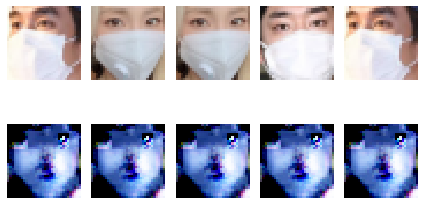

epoch = 3322/5000, d_loss=0.005, g_loss=0.193                                                                                                                   
epoch = 3323/5000, d_loss=0.005, g_loss=0.227                                                                                                                   
epoch = 3324/5000, d_loss=0.005, g_loss=0.339                                                                                                                   
epoch = 3325/5000, d_loss=0.004, g_loss=0.283                                                                                                                   
epoch = 3326/5000, d_loss=0.006, g_loss=0.233                                                                                                                   
epoch = 3327/5000, d_loss=0.006, g_loss=0.285                                                                                                                   
epoch = 3328/5000, d_loss=0.005, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3331/5000, d_loss=0.007, g_loss=0.349                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


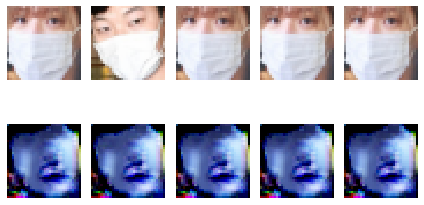

epoch = 3332/5000, d_loss=0.009, g_loss=0.322                                                                                                                   
epoch = 3333/5000, d_loss=0.015, g_loss=0.360                                                                                                                   
epoch = 3334/5000, d_loss=0.019, g_loss=0.261                                                                                                                   
epoch = 3335/5000, d_loss=0.016, g_loss=0.267                                                                                                                   
epoch = 3336/5000, d_loss=0.018, g_loss=0.265                                                                                                                   
epoch = 3337/5000, d_loss=0.015, g_loss=0.198                                                                                                                   
epoch = 3338/5000, d_loss=0.023, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3341/5000, d_loss=0.005, g_loss=0.066                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


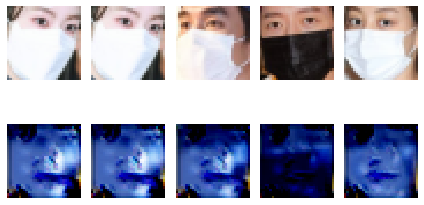

epoch = 3342/5000, d_loss=0.004, g_loss=0.094                                                                                                                   
epoch = 3343/5000, d_loss=0.003, g_loss=0.088                                                                                                                   
epoch = 3344/5000, d_loss=0.003, g_loss=0.065                                                                                                                   
epoch = 3345/5000, d_loss=0.004, g_loss=0.097                                                                                                                   
epoch = 3346/5000, d_loss=0.005, g_loss=0.043                                                                                                                   
epoch = 3347/5000, d_loss=0.003, g_loss=0.103                                                                                                                   
epoch = 3348/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3351/5000, d_loss=0.002, g_loss=0.043                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


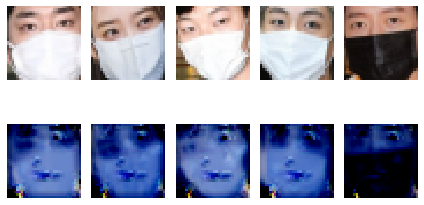

epoch = 3352/5000, d_loss=0.002, g_loss=0.029                                                                                                                   
epoch = 3353/5000, d_loss=0.002, g_loss=0.024                                                                                                                   
epoch = 3354/5000, d_loss=0.002, g_loss=0.026                                                                                                                   
epoch = 3355/5000, d_loss=0.001, g_loss=0.021                                                                                                                   
epoch = 3356/5000, d_loss=0.001, g_loss=0.021                                                                                                                   
epoch = 3357/5000, d_loss=0.001, g_loss=0.019                                                                                                                   
epoch = 3358/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3361/5000, d_loss=0.001, g_loss=0.020                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


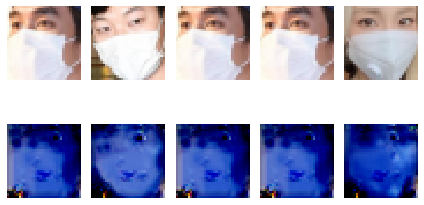

epoch = 3362/5000, d_loss=0.002, g_loss=0.016                                                                                                                   
epoch = 3363/5000, d_loss=0.002, g_loss=0.014                                                                                                                   
epoch = 3364/5000, d_loss=0.003, g_loss=0.029                                                                                                                   
epoch = 3365/5000, d_loss=0.002, g_loss=0.014                                                                                                                   
epoch = 3366/5000, d_loss=0.001, g_loss=0.027                                                                                                                   
epoch = 3367/5000, d_loss=0.002, g_loss=0.012                                                                                                                   
epoch = 3368/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3371/5000, d_loss=0.001, g_loss=0.014                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


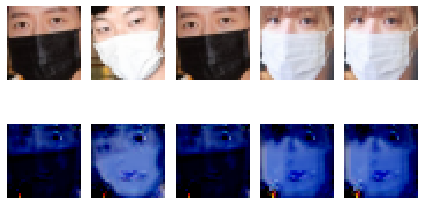

epoch = 3372/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 3373/5000, d_loss=0.001, g_loss=0.015                                                                                                                   
epoch = 3374/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 3375/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 3376/5000, d_loss=0.001, g_loss=0.013                                                                                                                   
epoch = 3377/5000, d_loss=0.001, g_loss=0.015                                                                                                                   
epoch = 3378/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3381/5000, d_loss=0.001, g_loss=0.010                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


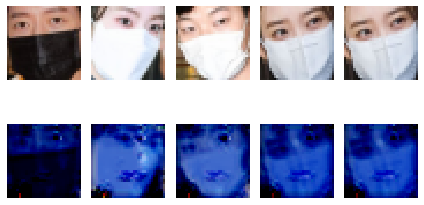

epoch = 3382/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 3383/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 3384/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 3385/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 3386/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 3387/5000, d_loss=0.001, g_loss=0.011                                                                                                                   
epoch = 3388/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3391/5000, d_loss=0.001, g_loss=0.012                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


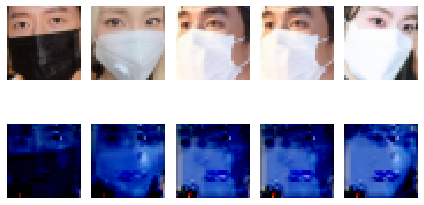

epoch = 3392/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 3393/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 3394/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 3395/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 3396/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 3397/5000, d_loss=0.001, g_loss=0.011                                                                                                                   
epoch = 3398/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3401/5000, d_loss=0.001, g_loss=0.008                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


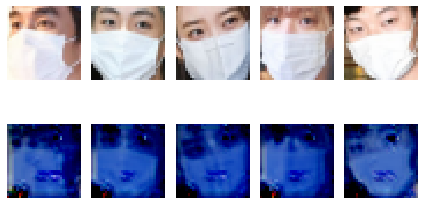

epoch = 3402/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 3403/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 3404/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 3405/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 3406/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 3407/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 3408/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3411/5000, d_loss=0.001, g_loss=0.007                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


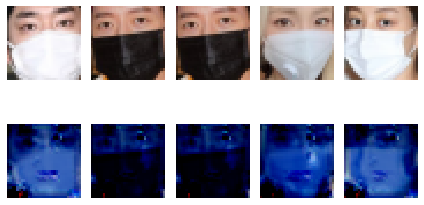

epoch = 3412/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 3413/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 3414/5000, d_loss=0.001, g_loss=0.011                                                                                                                   
epoch = 3415/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 3416/5000, d_loss=0.002, g_loss=0.010                                                                                                                   
epoch = 3417/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 3418/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3421/5000, d_loss=0.000, g_loss=0.006                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


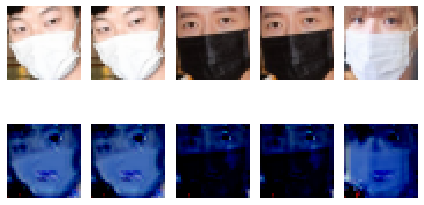

epoch = 3422/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 3423/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 3424/5000, d_loss=0.000, g_loss=0.009                                                                                                                   
epoch = 3425/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 3426/5000, d_loss=0.000, g_loss=0.007                                                                                                                   
epoch = 3427/5000, d_loss=0.000, g_loss=0.008                                                                                                                   
epoch = 3428/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3431/5000, d_loss=0.000, g_loss=0.007                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


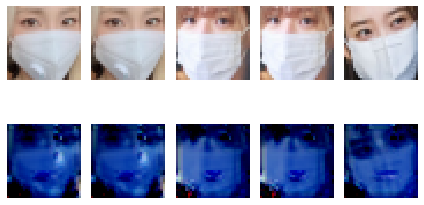

epoch = 3432/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 3433/5000, d_loss=0.000, g_loss=0.007                                                                                                                   
epoch = 3434/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 3435/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 3436/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 3437/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 3438/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3441/5000, d_loss=0.000, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


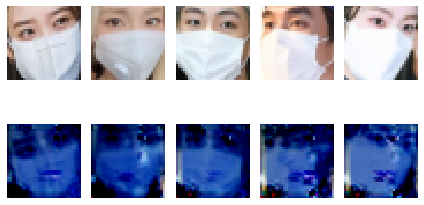

epoch = 3442/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 3443/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 3444/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 3445/5000, d_loss=0.000, g_loss=0.008                                                                                                                   
epoch = 3446/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 3447/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 3448/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3451/5000, d_loss=0.001, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


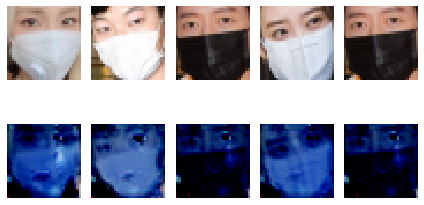

epoch = 3452/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 3453/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 3454/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3455/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 3456/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 3457/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 3458/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3461/5000, d_loss=0.001, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


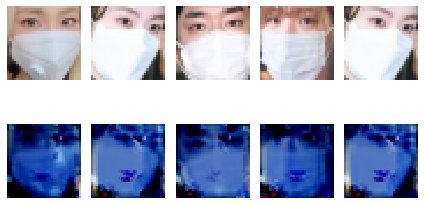

epoch = 3462/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 3463/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3464/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3465/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 3466/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3467/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3468/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3471/5000, d_loss=0.000, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


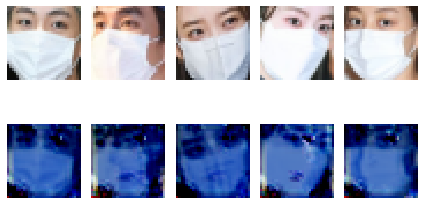

epoch = 3472/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 3473/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3474/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3475/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 3476/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 3477/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 3478/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3481/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


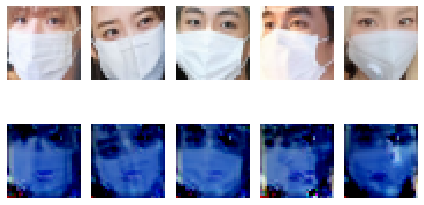

epoch = 3482/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 3483/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 3484/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3485/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 3486/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 3487/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 3488/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3491/5000, d_loss=0.003, g_loss=0.007                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


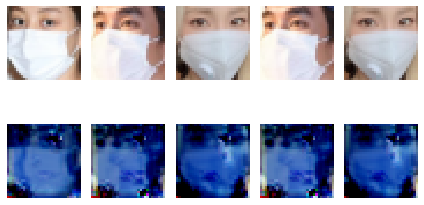

epoch = 3492/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3493/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3494/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 3495/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3496/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 3497/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 3498/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3501/5000, d_loss=0.000, g_loss=0.003                                                                                                     


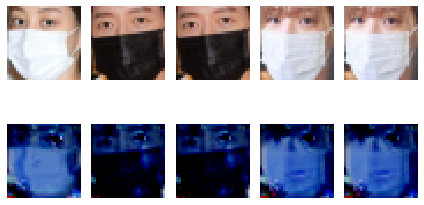

epoch = 3502/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3503/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3504/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3505/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 3506/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3507/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3508/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3511/5000, d_loss=0.002, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


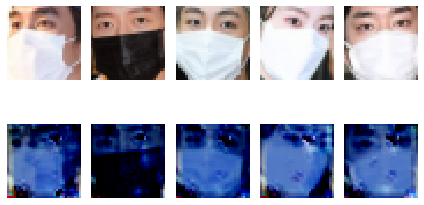

epoch = 3512/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3513/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3514/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3515/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3516/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3517/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3518/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3521/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


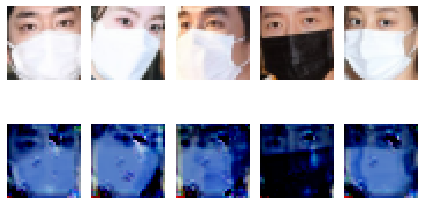

epoch = 3522/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3523/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3524/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3525/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3526/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3527/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3528/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3531/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


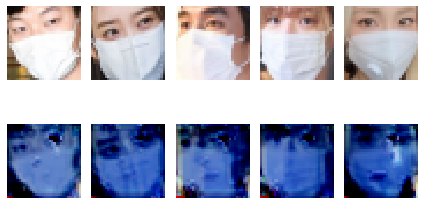

epoch = 3532/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3533/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3534/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3535/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3536/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3537/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3538/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3541/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


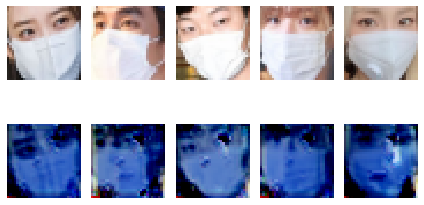

epoch = 3542/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3543/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3544/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3545/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3546/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3547/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3548/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3551/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


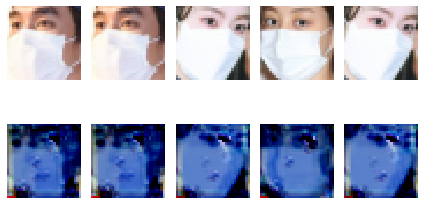

epoch = 3552/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3553/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3554/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3555/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3556/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3557/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3558/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3561/5000, d_loss=0.002, g_loss=0.006                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


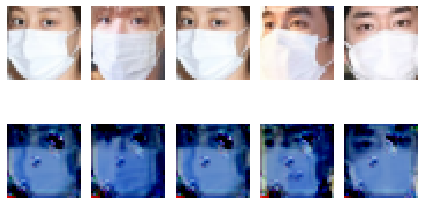

epoch = 3562/5000, d_loss=0.002, g_loss=0.006                                                                                                                   
epoch = 3563/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3564/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3565/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3566/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3567/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3568/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3571/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


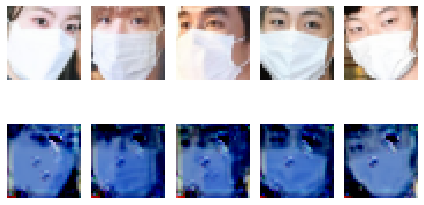

epoch = 3572/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3573/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3574/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3575/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3576/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 3577/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3578/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3581/5000, d_loss=0.044, g_loss=0.040                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


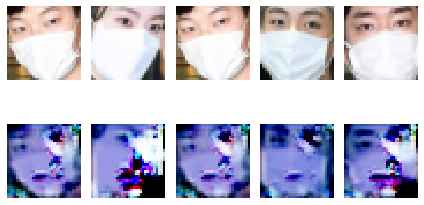

epoch = 3582/5000, d_loss=0.019, g_loss=0.041                                                                                                                   
epoch = 3583/5000, d_loss=0.010, g_loss=0.050                                                                                                                   
epoch = 3584/5000, d_loss=0.017, g_loss=0.065                                                                                                                   
epoch = 3585/5000, d_loss=0.020, g_loss=0.034                                                                                                                   
epoch = 3586/5000, d_loss=0.017, g_loss=0.040                                                                                                                   
epoch = 3587/5000, d_loss=0.009, g_loss=0.034                                                                                                                   
epoch = 3588/5000, d_loss=0.032, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3591/5000, d_loss=0.016, g_loss=0.038                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


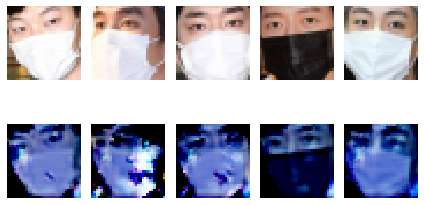

epoch = 3592/5000, d_loss=0.014, g_loss=0.040                                                                                                                   
epoch = 3593/5000, d_loss=0.017, g_loss=0.033                                                                                                                   
epoch = 3594/5000, d_loss=0.020, g_loss=0.037                                                                                                                   
epoch = 3595/5000, d_loss=0.014, g_loss=0.036                                                                                                                   
epoch = 3596/5000, d_loss=0.008, g_loss=0.035                                                                                                                   
epoch = 3597/5000, d_loss=0.072, g_loss=0.041                                                                                                                   
epoch = 3598/5000, d_loss=0.007, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3601/5000, d_loss=0.008, g_loss=0.028                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


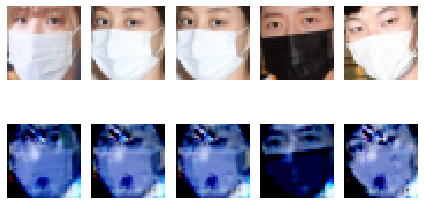

epoch = 3602/5000, d_loss=0.007, g_loss=0.029                                                                                                                   
epoch = 3603/5000, d_loss=0.007, g_loss=0.035                                                                                                                   
epoch = 3604/5000, d_loss=0.007, g_loss=0.026                                                                                                                   
epoch = 3605/5000, d_loss=0.006, g_loss=0.025                                                                                                                   
epoch = 3606/5000, d_loss=0.005, g_loss=0.027                                                                                                                   
epoch = 3607/5000, d_loss=0.008, g_loss=0.027                                                                                                                   
epoch = 3608/5000, d_loss=0.006, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3611/5000, d_loss=0.018, g_loss=0.032                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


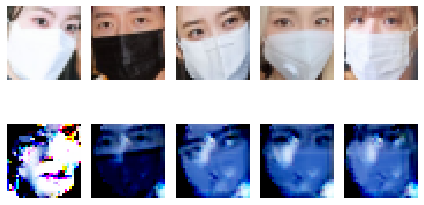

epoch = 3612/5000, d_loss=0.005, g_loss=0.026                                                                                                                   
epoch = 3613/5000, d_loss=0.006, g_loss=0.020                                                                                                                   
epoch = 3614/5000, d_loss=0.008, g_loss=0.026                                                                                                                   
epoch = 3615/5000, d_loss=0.006, g_loss=0.024                                                                                                                   
epoch = 3616/5000, d_loss=0.006, g_loss=0.027                                                                                                                   
epoch = 3617/5000, d_loss=0.018, g_loss=0.024                                                                                                                   
epoch = 3618/5000, d_loss=0.005, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3621/5000, d_loss=0.008, g_loss=0.021                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


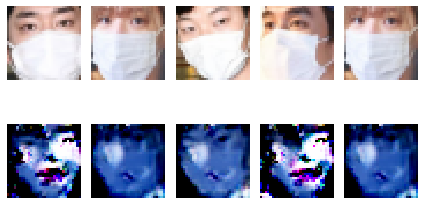

epoch = 3622/5000, d_loss=0.010, g_loss=0.021                                                                                                                   
epoch = 3623/5000, d_loss=0.007, g_loss=0.027                                                                                                                   
epoch = 3624/5000, d_loss=0.004, g_loss=0.022                                                                                                                   
epoch = 3625/5000, d_loss=0.005, g_loss=0.021                                                                                                                   
epoch = 3626/5000, d_loss=0.004, g_loss=0.021                                                                                                                   
epoch = 3627/5000, d_loss=0.004, g_loss=0.020                                                                                                                   
epoch = 3628/5000, d_loss=0.005, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3631/5000, d_loss=0.003, g_loss=0.016                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


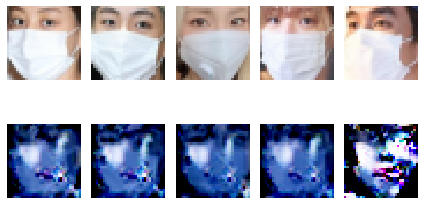

epoch = 3632/5000, d_loss=0.004, g_loss=0.023                                                                                                                   
epoch = 3633/5000, d_loss=0.005, g_loss=0.022                                                                                                                   
epoch = 3634/5000, d_loss=0.005, g_loss=0.023                                                                                                                   
epoch = 3635/5000, d_loss=0.003, g_loss=0.024                                                                                                                   
epoch = 3636/5000, d_loss=0.005, g_loss=0.028                                                                                                                   
epoch = 3637/5000, d_loss=0.012, g_loss=0.023                                                                                                                   
epoch = 3638/5000, d_loss=0.013, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3641/5000, d_loss=0.003, g_loss=0.020                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


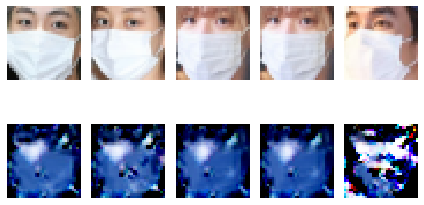

epoch = 3642/5000, d_loss=0.004, g_loss=0.021                                                                                                                   
epoch = 3643/5000, d_loss=0.003, g_loss=0.022                                                                                                                   
epoch = 3644/5000, d_loss=0.004, g_loss=0.024                                                                                                                   
epoch = 3645/5000, d_loss=0.006, g_loss=0.028                                                                                                                   
epoch = 3646/5000, d_loss=0.004, g_loss=0.023                                                                                                                   
epoch = 3647/5000, d_loss=0.003, g_loss=0.023                                                                                                                   
epoch = 3648/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3651/5000, d_loss=0.005, g_loss=0.024                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


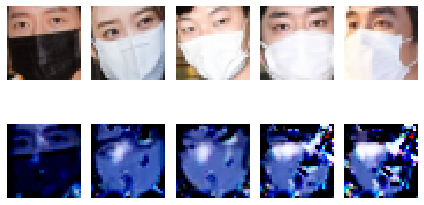

epoch = 3652/5000, d_loss=0.004, g_loss=0.023                                                                                                                   
epoch = 3653/5000, d_loss=0.004, g_loss=0.026                                                                                                                   
epoch = 3654/5000, d_loss=0.007, g_loss=0.027                                                                                                                   
epoch = 3655/5000, d_loss=0.004, g_loss=0.024                                                                                                                   
epoch = 3656/5000, d_loss=0.004, g_loss=0.024                                                                                                                   
epoch = 3657/5000, d_loss=0.002, g_loss=0.022                                                                                                                   
epoch = 3658/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3661/5000, d_loss=0.003, g_loss=0.022                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


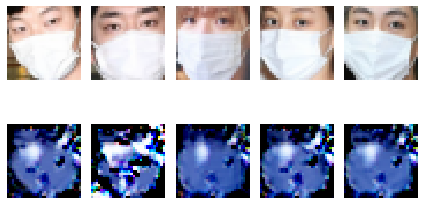

epoch = 3662/5000, d_loss=0.002, g_loss=0.022                                                                                                                   
epoch = 3663/5000, d_loss=0.002, g_loss=0.021                                                                                                                   
epoch = 3664/5000, d_loss=0.002, g_loss=0.021                                                                                                                   
epoch = 3665/5000, d_loss=0.003, g_loss=0.022                                                                                                                   
epoch = 3666/5000, d_loss=0.002, g_loss=0.018                                                                                                                   
epoch = 3667/5000, d_loss=0.003, g_loss=0.022                                                                                                                   
epoch = 3668/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3671/5000, d_loss=0.002, g_loss=0.024                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


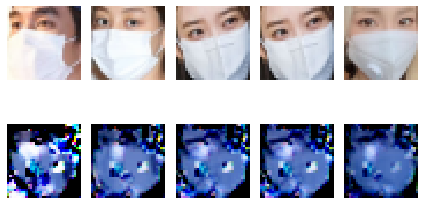

epoch = 3672/5000, d_loss=0.002, g_loss=0.017                                                                                                                   
epoch = 3673/5000, d_loss=0.003, g_loss=0.022                                                                                                                   
epoch = 3674/5000, d_loss=0.003, g_loss=0.028                                                                                                                   
epoch = 3675/5000, d_loss=0.003, g_loss=0.021                                                                                                                   
epoch = 3676/5000, d_loss=0.004, g_loss=0.017                                                                                                                   
epoch = 3677/5000, d_loss=0.003, g_loss=0.018                                                                                                                   
epoch = 3678/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3681/5000, d_loss=0.005, g_loss=0.018                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


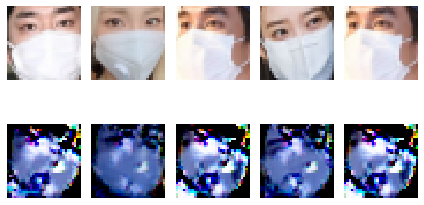

epoch = 3682/5000, d_loss=0.005, g_loss=0.016                                                                                                                   
epoch = 3683/5000, d_loss=0.003, g_loss=0.015                                                                                                                   
epoch = 3684/5000, d_loss=0.003, g_loss=0.010                                                                                                                   
epoch = 3685/5000, d_loss=0.003, g_loss=0.011                                                                                                                   
epoch = 3686/5000, d_loss=0.002, g_loss=0.009                                                                                                                   
epoch = 3687/5000, d_loss=0.002, g_loss=0.009                                                                                                                   
epoch = 3688/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3691/5000, d_loss=0.003, g_loss=0.007                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


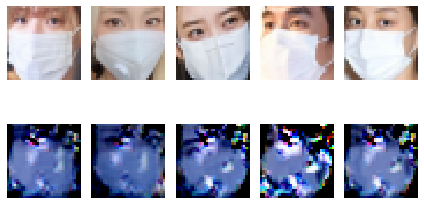

epoch = 3692/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 3693/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 3694/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 3695/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 3696/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 3697/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 3698/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3701/5000, d_loss=0.002, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


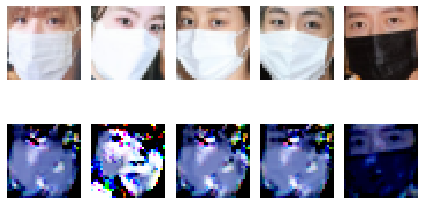

epoch = 3702/5000, d_loss=0.004, g_loss=0.005                                                                                                                   
epoch = 3703/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 3704/5000, d_loss=0.009, g_loss=0.005                                                                                                                   
epoch = 3705/5000, d_loss=0.002, g_loss=0.006                                                                                                                   
epoch = 3706/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 3707/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 3708/5000, d_loss=0.006, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3711/5000, d_loss=0.003, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


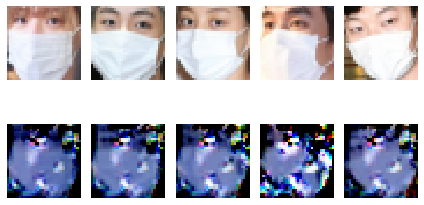

epoch = 3712/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3713/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3714/5000, d_loss=0.006, g_loss=0.005                                                                                                                   
epoch = 3715/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3716/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3717/5000, d_loss=0.005, g_loss=0.003                                                                                                                   
epoch = 3718/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3721/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


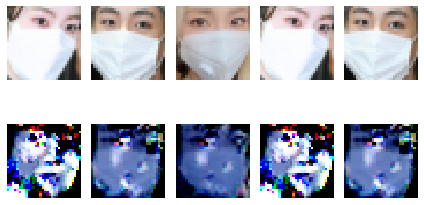

epoch = 3722/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3723/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3724/5000, d_loss=0.005, g_loss=0.003                                                                                                                   
epoch = 3725/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3726/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3727/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3728/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3731/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


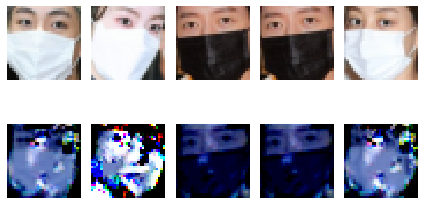

epoch = 3732/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3733/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 3734/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 3735/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3736/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3737/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3738/5000, d_loss=0.008, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3741/5000, d_loss=0.002, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


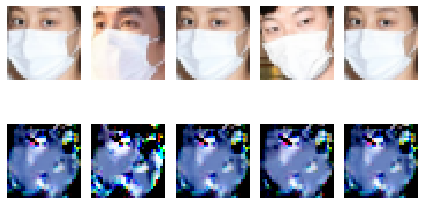

epoch = 3742/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3743/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3744/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 3745/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3746/5000, d_loss=0.006, g_loss=0.005                                                                                                                   
epoch = 3747/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3748/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3751/5000, d_loss=0.002, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


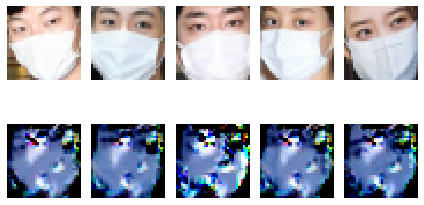

epoch = 3752/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 3753/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3754/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3755/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 3756/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3757/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3758/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3761/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


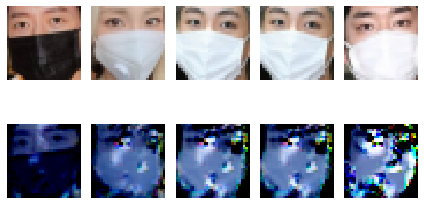

epoch = 3762/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3763/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3764/5000, d_loss=0.003, g_loss=0.002                                                                                                                   
epoch = 3765/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3766/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3767/5000, d_loss=0.006, g_loss=0.003                                                                                                                   
epoch = 3768/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3771/5000, d_loss=0.024, g_loss=0.016                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


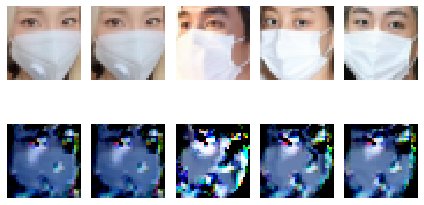

epoch = 3772/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 3773/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 3774/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 3775/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 3776/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 3777/5000, d_loss=0.008, g_loss=0.010                                                                                                                   
epoch = 3778/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3781/5000, d_loss=0.002, g_loss=0.008                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


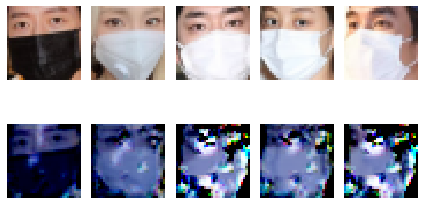

epoch = 3782/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 3783/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 3784/5000, d_loss=0.002, g_loss=0.011                                                                                                                   
epoch = 3785/5000, d_loss=0.003, g_loss=0.009                                                                                                                   
epoch = 3786/5000, d_loss=0.004, g_loss=0.014                                                                                                                   
epoch = 3787/5000, d_loss=0.011, g_loss=0.009                                                                                                                   
epoch = 3788/5000, d_loss=0.020, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3791/5000, d_loss=0.010, g_loss=0.018                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


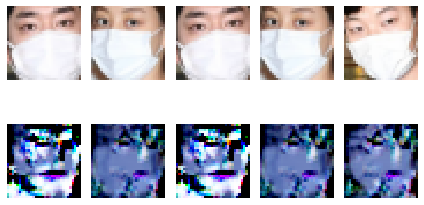

epoch = 3792/5000, d_loss=0.005, g_loss=0.022                                                                                                                   
epoch = 3793/5000, d_loss=0.007, g_loss=0.021                                                                                                                   
epoch = 3794/5000, d_loss=0.002, g_loss=0.020                                                                                                                   
epoch = 3795/5000, d_loss=0.003, g_loss=0.021                                                                                                                   
epoch = 3796/5000, d_loss=0.011, g_loss=0.015                                                                                                                   
epoch = 3797/5000, d_loss=0.021, g_loss=0.041                                                                                                                   
epoch = 3798/5000, d_loss=0.044, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3801/5000, d_loss=0.005, g_loss=0.018                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


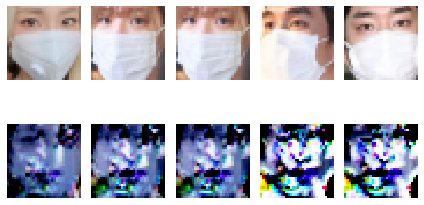

epoch = 3802/5000, d_loss=0.005, g_loss=0.016                                                                                                                   
epoch = 3803/5000, d_loss=0.003, g_loss=0.022                                                                                                                   
epoch = 3804/5000, d_loss=0.004, g_loss=0.016                                                                                                                   
epoch = 3805/5000, d_loss=0.003, g_loss=0.024                                                                                                                   
epoch = 3806/5000, d_loss=0.002, g_loss=0.015                                                                                                                   
epoch = 3807/5000, d_loss=0.002, g_loss=0.023                                                                                                                   
epoch = 3808/5000, d_loss=0.008, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3811/5000, d_loss=0.003, g_loss=0.013                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


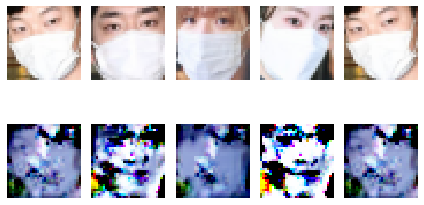

epoch = 3812/5000, d_loss=0.004, g_loss=0.012                                                                                                                   
epoch = 3813/5000, d_loss=0.002, g_loss=0.019                                                                                                                   
epoch = 3814/5000, d_loss=0.005, g_loss=0.013                                                                                                                   
epoch = 3815/5000, d_loss=0.002, g_loss=0.018                                                                                                                   
epoch = 3816/5000, d_loss=0.005, g_loss=0.012                                                                                                                   
epoch = 3817/5000, d_loss=0.004, g_loss=0.017                                                                                                                   
epoch = 3818/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3821/5000, d_loss=0.002, g_loss=0.016                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


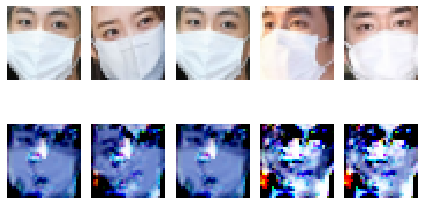

epoch = 3822/5000, d_loss=0.003, g_loss=0.015                                                                                                                   
epoch = 3823/5000, d_loss=0.003, g_loss=0.019                                                                                                                   
epoch = 3824/5000, d_loss=0.003, g_loss=0.026                                                                                                                   
epoch = 3825/5000, d_loss=0.004, g_loss=0.019                                                                                                                   
epoch = 3826/5000, d_loss=0.009, g_loss=0.028                                                                                                                   
epoch = 3827/5000, d_loss=0.008, g_loss=0.017                                                                                                                   
epoch = 3828/5000, d_loss=0.006, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3831/5000, d_loss=0.010, g_loss=0.019                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


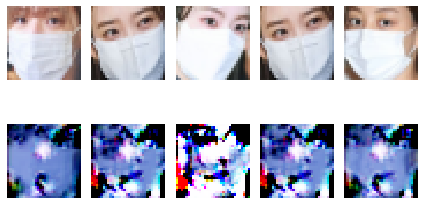

epoch = 3832/5000, d_loss=0.003, g_loss=0.020                                                                                                                   
epoch = 3833/5000, d_loss=0.008, g_loss=0.021                                                                                                                   
epoch = 3834/5000, d_loss=0.003, g_loss=0.019                                                                                                                   
epoch = 3835/5000, d_loss=0.002, g_loss=0.023                                                                                                                   
epoch = 3836/5000, d_loss=0.002, g_loss=0.019                                                                                                                   
epoch = 3837/5000, d_loss=0.005, g_loss=0.024                                                                                                                   
epoch = 3838/5000, d_loss=0.006, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3841/5000, d_loss=0.004, g_loss=0.028                                                                                                     


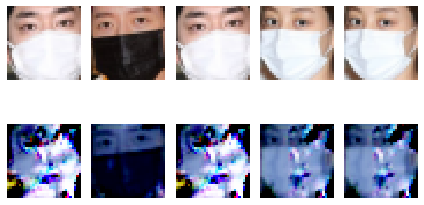

epoch = 3842/5000, d_loss=0.004, g_loss=0.018                                                                                                                   
epoch = 3843/5000, d_loss=0.002, g_loss=0.023                                                                                                                   
epoch = 3844/5000, d_loss=0.002, g_loss=0.018                                                                                                                   
epoch = 3845/5000, d_loss=0.006, g_loss=0.022                                                                                                                   
epoch = 3846/5000, d_loss=0.002, g_loss=0.020                                                                                                                   
epoch = 3847/5000, d_loss=0.003, g_loss=0.024                                                                                                                   
epoch = 3848/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3851/5000, d_loss=0.002, g_loss=0.018                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


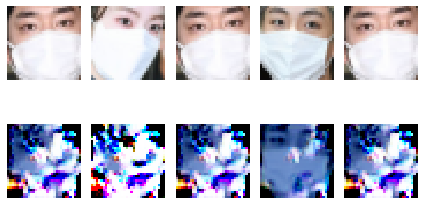

epoch = 3852/5000, d_loss=0.001, g_loss=0.021                                                                                                                   
epoch = 3853/5000, d_loss=0.005, g_loss=0.015                                                                                                                   
epoch = 3854/5000, d_loss=0.003, g_loss=0.013                                                                                                                   
epoch = 3855/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 3856/5000, d_loss=0.003, g_loss=0.014                                                                                                                   
epoch = 3857/5000, d_loss=0.001, g_loss=0.015                                                                                                                   
epoch = 3858/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3861/5000, d_loss=0.002, g_loss=0.012                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


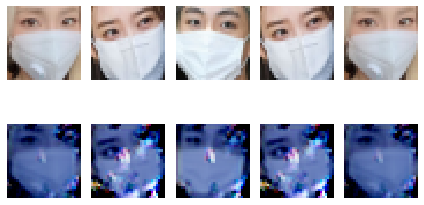

epoch = 3862/5000, d_loss=0.001, g_loss=0.013                                                                                                                   
epoch = 3863/5000, d_loss=0.002, g_loss=0.014                                                                                                                   
epoch = 3864/5000, d_loss=0.004, g_loss=0.017                                                                                                                   
epoch = 3865/5000, d_loss=0.005, g_loss=0.012                                                                                                                   
epoch = 3866/5000, d_loss=0.003, g_loss=0.009                                                                                                                   
epoch = 3867/5000, d_loss=0.003, g_loss=0.013                                                                                                                   
epoch = 3868/5000, d_loss=0.004, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3871/5000, d_loss=0.004, g_loss=0.008                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


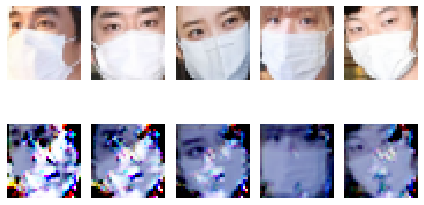

epoch = 3872/5000, d_loss=0.002, g_loss=0.012                                                                                                                   
epoch = 3873/5000, d_loss=0.002, g_loss=0.009                                                                                                                   
epoch = 3874/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 3875/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 3876/5000, d_loss=0.001, g_loss=0.011                                                                                                                   
epoch = 3877/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 3878/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3881/5000, d_loss=0.002, g_loss=0.006                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


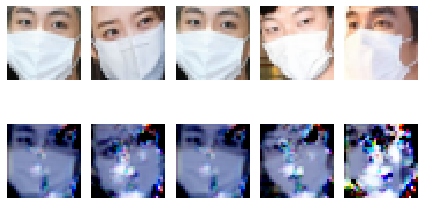

epoch = 3882/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 3883/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 3884/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 3885/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 3886/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 3887/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 3888/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3891/5000, d_loss=0.001, g_loss=0.009                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


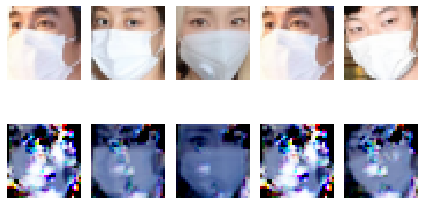

epoch = 3892/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 3893/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 3894/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 3895/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 3896/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 3897/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 3898/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3901/5000, d_loss=0.002, g_loss=0.005                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


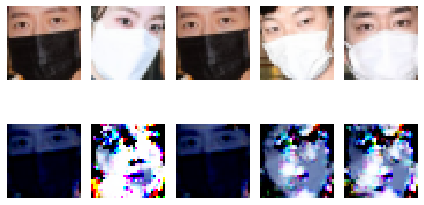

epoch = 3902/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 3903/5000, d_loss=0.002, g_loss=0.009                                                                                                                   
epoch = 3904/5000, d_loss=0.003, g_loss=0.011                                                                                                                   
epoch = 3905/5000, d_loss=0.003, g_loss=0.007                                                                                                                   
epoch = 3906/5000, d_loss=0.002, g_loss=0.012                                                                                                                   
epoch = 3907/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 3908/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3911/5000, d_loss=0.002, g_loss=0.008                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


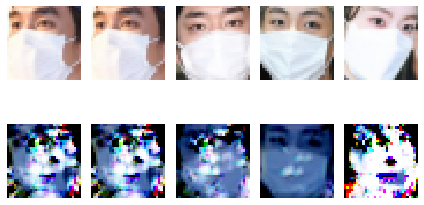

epoch = 3912/5000, d_loss=0.003, g_loss=0.005                                                                                                                   
epoch = 3913/5000, d_loss=0.002, g_loss=0.014                                                                                                                   
epoch = 3914/5000, d_loss=0.004, g_loss=0.008                                                                                                                   
epoch = 3915/5000, d_loss=0.002, g_loss=0.015                                                                                                                   
epoch = 3916/5000, d_loss=0.004, g_loss=0.012                                                                                                                   
epoch = 3917/5000, d_loss=0.002, g_loss=0.008                                                                                                                   
epoch = 3918/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3921/5000, d_loss=0.001, g_loss=0.006                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


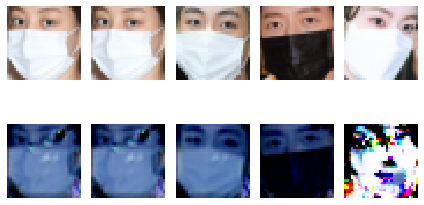

epoch = 3922/5000, d_loss=0.003, g_loss=0.009                                                                                                                   
epoch = 3923/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 3924/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 3925/5000, d_loss=0.013, g_loss=0.013                                                                                                                   
epoch = 3926/5000, d_loss=0.003, g_loss=0.015                                                                                                                   
epoch = 3927/5000, d_loss=0.010, g_loss=0.010                                                                                                                   
epoch = 3928/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3931/5000, d_loss=0.004, g_loss=0.007                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


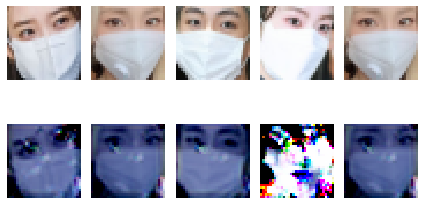

epoch = 3932/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 3933/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 3934/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 3935/5000, d_loss=0.005, g_loss=0.006                                                                                                                   
epoch = 3936/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 3937/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 3938/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3941/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


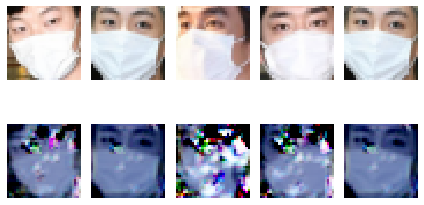

epoch = 3942/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3943/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3944/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 3945/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3946/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3947/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 3948/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3951/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


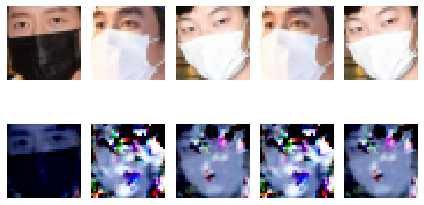

epoch = 3952/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 3953/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 3954/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 3955/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 3956/5000, d_loss=0.008, g_loss=0.004                                                                                                                   
epoch = 3957/5000, d_loss=0.015, g_loss=0.017                                                                                                                   
epoch = 3958/5000, d_loss=0.020, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3961/5000, d_loss=0.003, g_loss=0.024                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


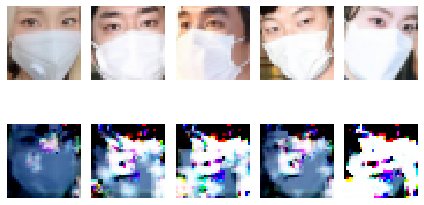

epoch = 3962/5000, d_loss=0.007, g_loss=0.026                                                                                                                   
epoch = 3963/5000, d_loss=0.003, g_loss=0.020                                                                                                                   
epoch = 3964/5000, d_loss=0.003, g_loss=0.021                                                                                                                   
epoch = 3965/5000, d_loss=0.028, g_loss=0.021                                                                                                                   
epoch = 3966/5000, d_loss=0.003, g_loss=0.022                                                                                                                   
epoch = 3967/5000, d_loss=0.025, g_loss=0.028                                                                                                                   
epoch = 3968/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3971/5000, d_loss=0.003, g_loss=0.020                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


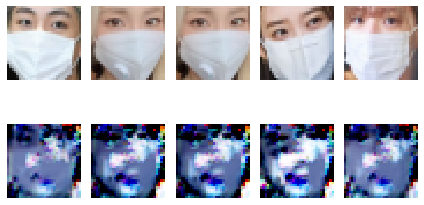

epoch = 3972/5000, d_loss=0.002, g_loss=0.014                                                                                                                   
epoch = 3973/5000, d_loss=0.002, g_loss=0.014                                                                                                                   
epoch = 3974/5000, d_loss=0.003, g_loss=0.019                                                                                                                   
epoch = 3975/5000, d_loss=0.001, g_loss=0.018                                                                                                                   
epoch = 3976/5000, d_loss=0.002, g_loss=0.020                                                                                                                   
epoch = 3977/5000, d_loss=0.002, g_loss=0.020                                                                                                                   
epoch = 3978/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3981/5000, d_loss=0.001, g_loss=0.016                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


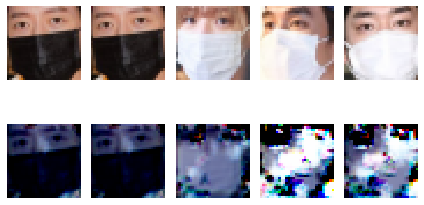

epoch = 3982/5000, d_loss=0.001, g_loss=0.019                                                                                                                   
epoch = 3983/5000, d_loss=0.005, g_loss=0.021                                                                                                                   
epoch = 3984/5000, d_loss=0.001, g_loss=0.017                                                                                                                   
epoch = 3985/5000, d_loss=0.004, g_loss=0.022                                                                                                                   
epoch = 3986/5000, d_loss=0.002, g_loss=0.020                                                                                                                   
epoch = 3987/5000, d_loss=0.001, g_loss=0.021                                                                                                                   
epoch = 3988/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 3991/5000, d_loss=0.003, g_loss=0.021                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


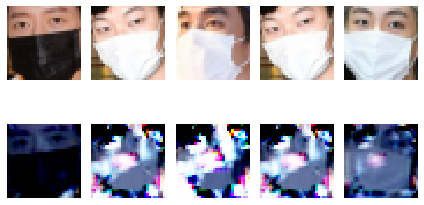

epoch = 3992/5000, d_loss=0.001, g_loss=0.022                                                                                                                   
epoch = 3993/5000, d_loss=0.002, g_loss=0.023                                                                                                                   
epoch = 3994/5000, d_loss=0.004, g_loss=0.020                                                                                                                   
epoch = 3995/5000, d_loss=0.001, g_loss=0.015                                                                                                                   
epoch = 3996/5000, d_loss=0.001, g_loss=0.019                                                                                                                   
epoch = 3997/5000, d_loss=0.001, g_loss=0.016                                                                                                                   
epoch = 3998/5000, d_loss=0.004, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4001/5000, d_loss=0.006, g_loss=0.020                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


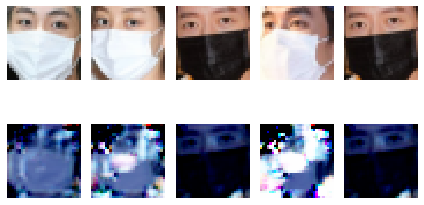

epoch = 4002/5000, d_loss=0.001, g_loss=0.021                                                                                                                   
epoch = 4003/5000, d_loss=0.001, g_loss=0.022                                                                                                                   
epoch = 4004/5000, d_loss=0.002, g_loss=0.029                                                                                                                   
epoch = 4005/5000, d_loss=0.004, g_loss=0.025                                                                                                                   
epoch = 4006/5000, d_loss=0.002, g_loss=0.026                                                                                                                   
epoch = 4007/5000, d_loss=0.003, g_loss=0.025                                                                                                                   
epoch = 4008/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4011/5000, d_loss=0.001, g_loss=0.016                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


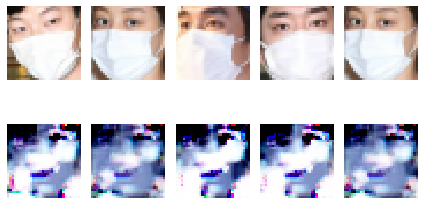

epoch = 4012/5000, d_loss=0.003, g_loss=0.039                                                                                                                   
epoch = 4013/5000, d_loss=0.001, g_loss=0.021                                                                                                                   
epoch = 4014/5000, d_loss=0.001, g_loss=0.015                                                                                                                   
epoch = 4015/5000, d_loss=0.001, g_loss=0.016                                                                                                                   
epoch = 4016/5000, d_loss=0.003, g_loss=0.019                                                                                                                   
epoch = 4017/5000, d_loss=0.004, g_loss=0.036                                                                                                                   
epoch = 4018/5000, d_loss=0.009, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4021/5000, d_loss=0.002, g_loss=0.018                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


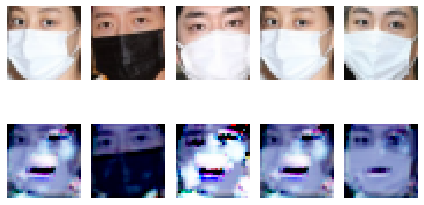

epoch = 4022/5000, d_loss=0.002, g_loss=0.019                                                                                                                   
epoch = 4023/5000, d_loss=0.003, g_loss=0.018                                                                                                                   
epoch = 4024/5000, d_loss=0.001, g_loss=0.024                                                                                                                   
epoch = 4025/5000, d_loss=0.011, g_loss=0.021                                                                                                                   
epoch = 4026/5000, d_loss=0.002, g_loss=0.016                                                                                                                   
epoch = 4027/5000, d_loss=0.005, g_loss=0.024                                                                                                                   
epoch = 4028/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4031/5000, d_loss=0.001, g_loss=0.020                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


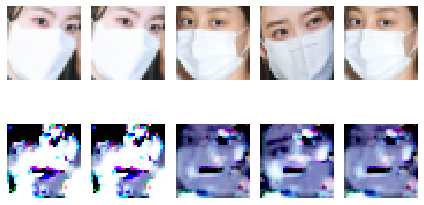

epoch = 4032/5000, d_loss=0.001, g_loss=0.018                                                                                                                   
epoch = 4033/5000, d_loss=0.001, g_loss=0.018                                                                                                                   
epoch = 4034/5000, d_loss=0.001, g_loss=0.018                                                                                                                   
epoch = 4035/5000, d_loss=0.001, g_loss=0.015                                                                                                                   
epoch = 4036/5000, d_loss=0.002, g_loss=0.017                                                                                                                   
epoch = 4037/5000, d_loss=0.002, g_loss=0.020                                                                                                                   
epoch = 4038/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4041/5000, d_loss=0.002, g_loss=0.014                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


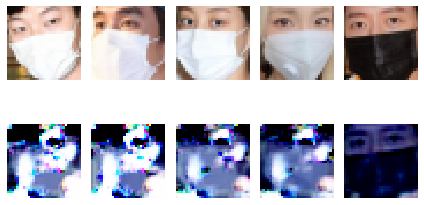

epoch = 4042/5000, d_loss=0.000, g_loss=0.014                                                                                                                   
epoch = 4043/5000, d_loss=0.001, g_loss=0.013                                                                                                                   
epoch = 4044/5000, d_loss=0.000, g_loss=0.013                                                                                                                   
epoch = 4045/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 4046/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 4047/5000, d_loss=0.005, g_loss=0.015                                                                                                                   
epoch = 4048/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4051/5000, d_loss=0.001, g_loss=0.014                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


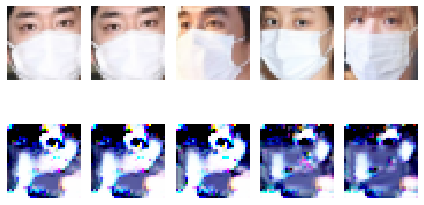

epoch = 4052/5000, d_loss=0.000, g_loss=0.013                                                                                                                   
epoch = 4053/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 4054/5000, d_loss=0.000, g_loss=0.012                                                                                                                   
epoch = 4055/5000, d_loss=0.002, g_loss=0.013                                                                                                                   
epoch = 4056/5000, d_loss=0.000, g_loss=0.015                                                                                                                   
epoch = 4057/5000, d_loss=0.002, g_loss=0.013                                                                                                                   
epoch = 4058/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4061/5000, d_loss=0.001, g_loss=0.019                                                                                                     


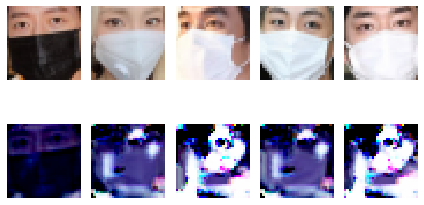

epoch = 4062/5000, d_loss=0.004, g_loss=0.020                                                                                                                   
epoch = 4063/5000, d_loss=0.001, g_loss=0.016                                                                                                                   
epoch = 4064/5000, d_loss=0.001, g_loss=0.017                                                                                                                   
epoch = 4065/5000, d_loss=0.001, g_loss=0.016                                                                                                                   
epoch = 4066/5000, d_loss=0.001, g_loss=0.016                                                                                                                   
epoch = 4067/5000, d_loss=0.004, g_loss=0.021                                                                                                                   
epoch = 4068/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4071/5000, d_loss=0.004, g_loss=0.020                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


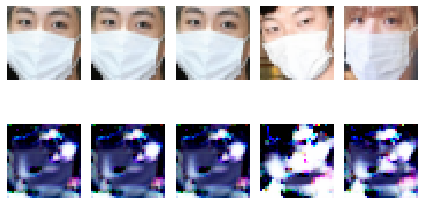

epoch = 4072/5000, d_loss=0.001, g_loss=0.025                                                                                                                   
epoch = 4073/5000, d_loss=0.002, g_loss=0.020                                                                                                                   
epoch = 4074/5000, d_loss=0.009, g_loss=0.052                                                                                                                   
epoch = 4075/5000, d_loss=0.003, g_loss=0.018                                                                                                                   
epoch = 4076/5000, d_loss=0.001, g_loss=0.015                                                                                                                   
epoch = 4077/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 4078/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4081/5000, d_loss=0.001, g_loss=0.017                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


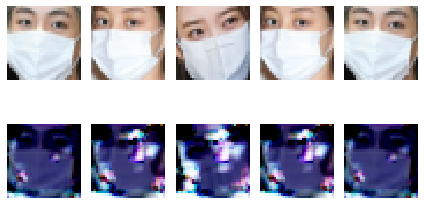

epoch = 4082/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 4083/5000, d_loss=0.002, g_loss=0.018                                                                                                                   
epoch = 4084/5000, d_loss=0.001, g_loss=0.022                                                                                                                   
epoch = 4085/5000, d_loss=0.002, g_loss=0.018                                                                                                                   
epoch = 4086/5000, d_loss=0.001, g_loss=0.018                                                                                                                   
epoch = 4087/5000, d_loss=0.001, g_loss=0.021                                                                                                                   
epoch = 4088/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4091/5000, d_loss=0.001, g_loss=0.024                                                                                                     


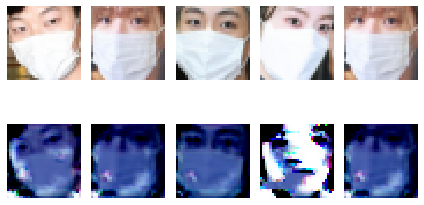

epoch = 4092/5000, d_loss=0.002, g_loss=0.026                                                                                                                   
epoch = 4093/5000, d_loss=0.003, g_loss=0.021                                                                                                                   
epoch = 4094/5000, d_loss=0.014, g_loss=0.085                                                                                                                   
epoch = 4095/5000, d_loss=0.004, g_loss=0.039                                                                                                                   
epoch = 4096/5000, d_loss=0.004, g_loss=0.045                                                                                                                   
epoch = 4097/5000, d_loss=0.033, g_loss=0.048                                                                                                                   
epoch = 4098/5000, d_loss=0.005, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4101/5000, d_loss=0.006, g_loss=0.024                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


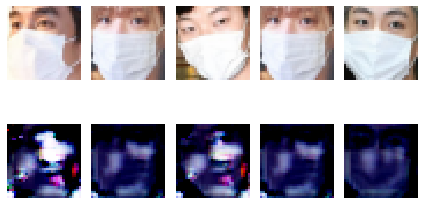

epoch = 4102/5000, d_loss=0.004, g_loss=0.036                                                                                                                   
epoch = 4103/5000, d_loss=0.011, g_loss=0.028                                                                                                                   
epoch = 4104/5000, d_loss=0.002, g_loss=0.041                                                                                                                   
epoch = 4105/5000, d_loss=0.006, g_loss=0.033                                                                                                                   
epoch = 4106/5000, d_loss=0.003, g_loss=0.026                                                                                                                   
epoch = 4107/5000, d_loss=0.006, g_loss=0.030                                                                                                                   
epoch = 4108/5000, d_loss=0.006, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4111/5000, d_loss=0.001, g_loss=0.021                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


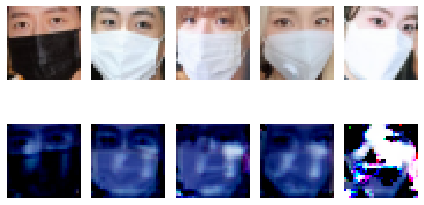

epoch = 4112/5000, d_loss=0.007, g_loss=0.025                                                                                                                   
epoch = 4113/5000, d_loss=0.002, g_loss=0.026                                                                                                                   
epoch = 4114/5000, d_loss=0.002, g_loss=0.024                                                                                                                   
epoch = 4115/5000, d_loss=0.003, g_loss=0.022                                                                                                                   
epoch = 4116/5000, d_loss=0.001, g_loss=0.022                                                                                                                   
epoch = 4117/5000, d_loss=0.002, g_loss=0.021                                                                                                                   
epoch = 4118/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4121/5000, d_loss=0.003, g_loss=0.028                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


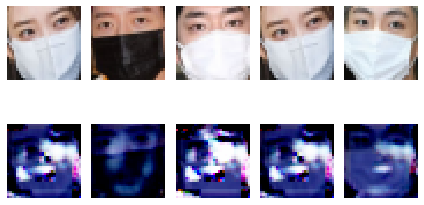

epoch = 4122/5000, d_loss=0.004, g_loss=0.024                                                                                                                   
epoch = 4123/5000, d_loss=0.008, g_loss=0.019                                                                                                                   
epoch = 4124/5000, d_loss=0.003, g_loss=0.027                                                                                                                   
epoch = 4125/5000, d_loss=0.003, g_loss=0.025                                                                                                                   
epoch = 4126/5000, d_loss=0.003, g_loss=0.021                                                                                                                   
epoch = 4127/5000, d_loss=0.006, g_loss=0.028                                                                                                                   
epoch = 4128/5000, d_loss=0.004, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4131/5000, d_loss=0.004, g_loss=0.024                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


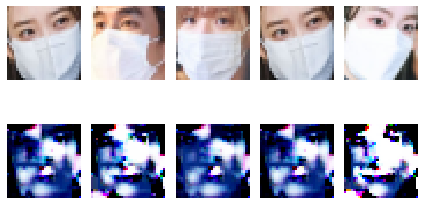

epoch = 4132/5000, d_loss=0.005, g_loss=0.020                                                                                                                   
epoch = 4133/5000, d_loss=0.005, g_loss=0.038                                                                                                                   
epoch = 4134/5000, d_loss=0.003, g_loss=0.021                                                                                                                   
epoch = 4135/5000, d_loss=0.001, g_loss=0.026                                                                                                                   
epoch = 4136/5000, d_loss=0.002, g_loss=0.025                                                                                                                   
epoch = 4137/5000, d_loss=0.001, g_loss=0.022                                                                                                                   
epoch = 4138/5000, d_loss=0.008, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4141/5000, d_loss=0.001, g_loss=0.023                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


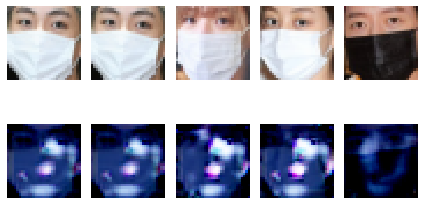

epoch = 4142/5000, d_loss=0.001, g_loss=0.024                                                                                                                   
epoch = 4143/5000, d_loss=0.003, g_loss=0.022                                                                                                                   
epoch = 4144/5000, d_loss=0.001, g_loss=0.021                                                                                                                   
epoch = 4145/5000, d_loss=0.002, g_loss=0.017                                                                                                                   
epoch = 4146/5000, d_loss=0.002, g_loss=0.027                                                                                                                   
epoch = 4147/5000, d_loss=0.006, g_loss=0.020                                                                                                                   
epoch = 4148/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4151/5000, d_loss=0.001, g_loss=0.014                                                                                                     


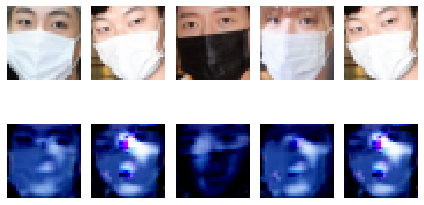

epoch = 4152/5000, d_loss=0.001, g_loss=0.019                                                                                                                   
epoch = 4153/5000, d_loss=0.004, g_loss=0.016                                                                                                                   
epoch = 4154/5000, d_loss=0.001, g_loss=0.016                                                                                                                   
epoch = 4155/5000, d_loss=0.003, g_loss=0.007                                                                                                                   
epoch = 4156/5000, d_loss=0.003, g_loss=0.018                                                                                                                   
epoch = 4157/5000, d_loss=0.002, g_loss=0.009                                                                                                                   
epoch = 4158/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4161/5000, d_loss=0.001, g_loss=0.014                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


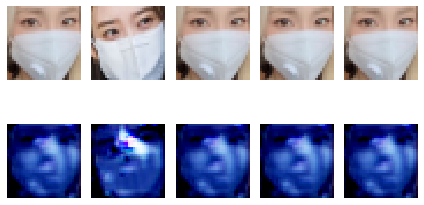

epoch = 4162/5000, d_loss=0.003, g_loss=0.007                                                                                                                   
epoch = 4163/5000, d_loss=0.001, g_loss=0.013                                                                                                                   
epoch = 4164/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 4165/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 4166/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 4167/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 4168/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4171/5000, d_loss=0.001, g_loss=0.012                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


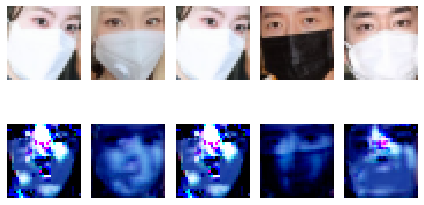

epoch = 4172/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 4173/5000, d_loss=0.002, g_loss=0.015                                                                                                                   
epoch = 4174/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 4175/5000, d_loss=0.001, g_loss=0.013                                                                                                                   
epoch = 4176/5000, d_loss=0.000, g_loss=0.007                                                                                                                   
epoch = 4177/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 4178/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4181/5000, d_loss=0.001, g_loss=0.011                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


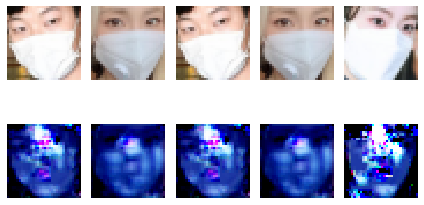

epoch = 4182/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 4183/5000, d_loss=0.002, g_loss=0.019                                                                                                                   
epoch = 4184/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 4185/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 4186/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 4187/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 4188/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4191/5000, d_loss=0.001, g_loss=0.007                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


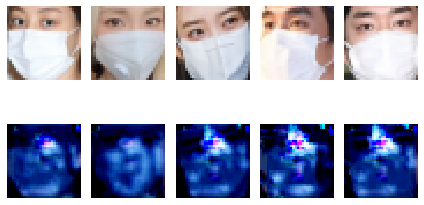

epoch = 4192/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 4193/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 4194/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 4195/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 4196/5000, d_loss=0.000, g_loss=0.008                                                                                                                   
epoch = 4197/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 4198/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4201/5000, d_loss=0.001, g_loss=0.007                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


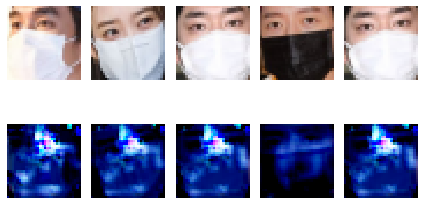

epoch = 4202/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 4203/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 4204/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 4205/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 4206/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 4207/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 4208/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4211/5000, d_loss=0.005, g_loss=0.011                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


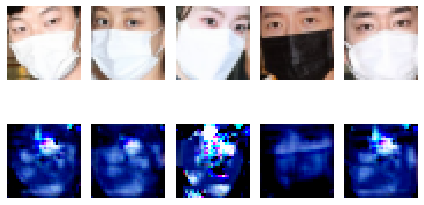

epoch = 4212/5000, d_loss=0.002, g_loss=0.006                                                                                                                   
epoch = 4213/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 4214/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 4215/5000, d_loss=0.002, g_loss=0.008                                                                                                                   
epoch = 4216/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4217/5000, d_loss=0.003, g_loss=0.010                                                                                                                   
epoch = 4218/5000, d_loss=0.006, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4221/5000, d_loss=0.001, g_loss=0.006                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


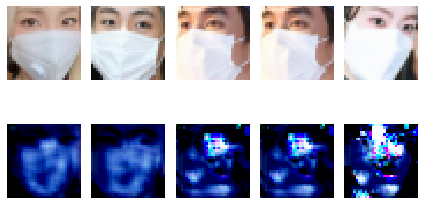

epoch = 4222/5000, d_loss=0.000, g_loss=0.005                                                                                                                   
epoch = 4223/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 4224/5000, d_loss=0.002, g_loss=0.008                                                                                                                   
epoch = 4225/5000, d_loss=0.000, g_loss=0.007                                                                                                                   
epoch = 4226/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 4227/5000, d_loss=0.002, g_loss=0.009                                                                                                                   
epoch = 4228/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4231/5000, d_loss=0.002, g_loss=0.034                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


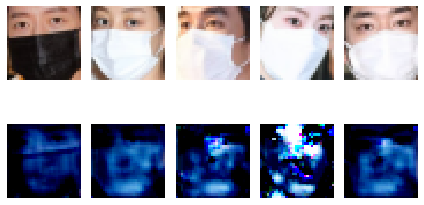

epoch = 4232/5000, d_loss=0.002, g_loss=0.016                                                                                                                   
epoch = 4233/5000, d_loss=0.002, g_loss=0.034                                                                                                                   
epoch = 4234/5000, d_loss=0.003, g_loss=0.018                                                                                                                   
epoch = 4235/5000, d_loss=0.002, g_loss=0.036                                                                                                                   
epoch = 4236/5000, d_loss=0.001, g_loss=0.016                                                                                                                   
epoch = 4237/5000, d_loss=0.005, g_loss=0.027                                                                                                                   
epoch = 4238/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4241/5000, d_loss=0.010, g_loss=0.028                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


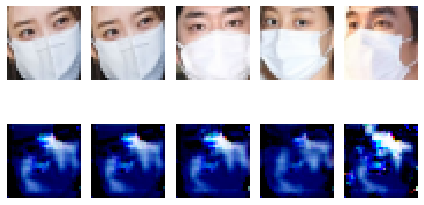

epoch = 4242/5000, d_loss=0.003, g_loss=0.014                                                                                                                   
epoch = 4243/5000, d_loss=0.004, g_loss=0.040                                                                                                                   
epoch = 4244/5000, d_loss=0.003, g_loss=0.015                                                                                                                   
epoch = 4245/5000, d_loss=0.002, g_loss=0.028                                                                                                                   
epoch = 4246/5000, d_loss=0.002, g_loss=0.012                                                                                                                   
epoch = 4247/5000, d_loss=0.002, g_loss=0.033                                                                                                                   
epoch = 4248/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4251/5000, d_loss=0.001, g_loss=0.035                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


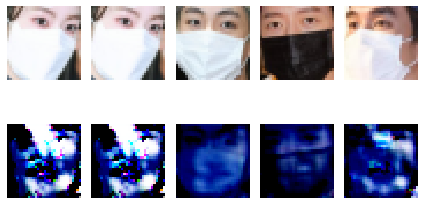

epoch = 4252/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 4253/5000, d_loss=0.002, g_loss=0.021                                                                                                                   
epoch = 4254/5000, d_loss=0.001, g_loss=0.017                                                                                                                   
epoch = 4255/5000, d_loss=0.001, g_loss=0.016                                                                                                                   
epoch = 4256/5000, d_loss=0.001, g_loss=0.016                                                                                                                   
epoch = 4257/5000, d_loss=0.001, g_loss=0.017                                                                                                                   
epoch = 4258/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4261/5000, d_loss=0.001, g_loss=0.010                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


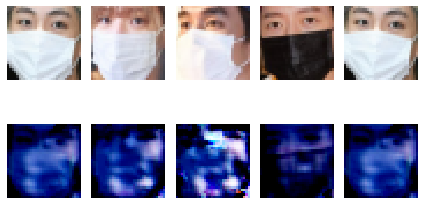

epoch = 4262/5000, d_loss=0.001, g_loss=0.011                                                                                                                   
epoch = 4263/5000, d_loss=0.000, g_loss=0.011                                                                                                                   
epoch = 4264/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 4265/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 4266/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 4267/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 4268/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4271/5000, d_loss=0.001, g_loss=0.010                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


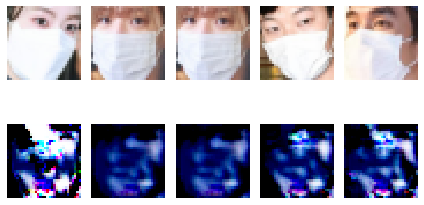

epoch = 4272/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 4273/5000, d_loss=0.002, g_loss=0.022                                                                                                                   
epoch = 4274/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 4275/5000, d_loss=0.001, g_loss=0.014                                                                                                                   
epoch = 4276/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 4277/5000, d_loss=0.000, g_loss=0.012                                                                                                                   
epoch = 4278/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4281/5000, d_loss=0.000, g_loss=0.015                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


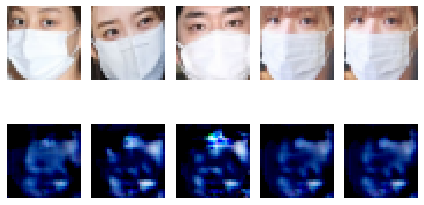

epoch = 4282/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4283/5000, d_loss=0.002, g_loss=0.025                                                                                                                   
epoch = 4284/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 4285/5000, d_loss=0.001, g_loss=0.024                                                                                                                   
epoch = 4286/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 4287/5000, d_loss=0.001, g_loss=0.026                                                                                                                   
epoch = 4288/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4291/5000, d_loss=0.000, g_loss=0.013                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


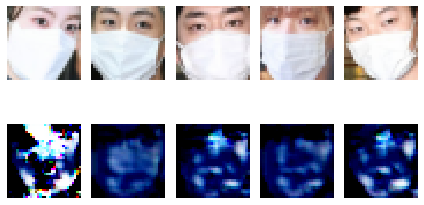

epoch = 4292/5000, d_loss=0.000, g_loss=0.010                                                                                                                   
epoch = 4293/5000, d_loss=0.000, g_loss=0.013                                                                                                                   
epoch = 4294/5000, d_loss=0.000, g_loss=0.007                                                                                                                   
epoch = 4295/5000, d_loss=0.001, g_loss=0.022                                                                                                                   
epoch = 4296/5000, d_loss=0.000, g_loss=0.006                                                                                                                   
epoch = 4297/5000, d_loss=0.001, g_loss=0.024                                                                                                                   
epoch = 4298/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4301/5000, d_loss=0.003, g_loss=0.015                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


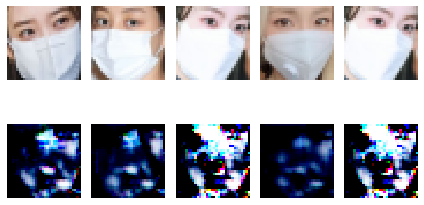

epoch = 4302/5000, d_loss=0.001, g_loss=0.013                                                                                                                   
epoch = 4303/5000, d_loss=0.001, g_loss=0.020                                                                                                                   
epoch = 4304/5000, d_loss=0.001, g_loss=0.010                                                                                                                   
epoch = 4305/5000, d_loss=0.001, g_loss=0.029                                                                                                                   
epoch = 4306/5000, d_loss=0.001, g_loss=0.013                                                                                                                   
epoch = 4307/5000, d_loss=0.000, g_loss=0.024                                                                                                                   
epoch = 4308/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4311/5000, d_loss=0.000, g_loss=0.016                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


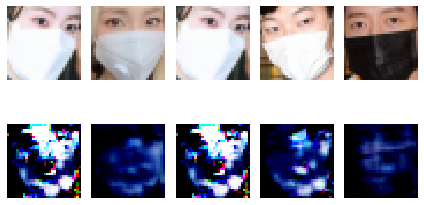

epoch = 4312/5000, d_loss=0.000, g_loss=0.008                                                                                                                   
epoch = 4313/5000, d_loss=0.001, g_loss=0.025                                                                                                                   
epoch = 4314/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 4315/5000, d_loss=0.001, g_loss=0.030                                                                                                                   
epoch = 4316/5000, d_loss=0.000, g_loss=0.012                                                                                                                   
epoch = 4317/5000, d_loss=0.000, g_loss=0.021                                                                                                                   
epoch = 4318/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4321/5000, d_loss=0.000, g_loss=0.017                                                                                                     


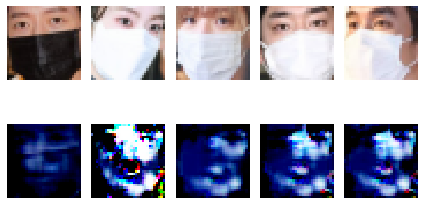

epoch = 4322/5000, d_loss=0.000, g_loss=0.010                                                                                                                   
epoch = 4323/5000, d_loss=0.000, g_loss=0.023                                                                                                                   
epoch = 4324/5000, d_loss=0.001, g_loss=0.012                                                                                                                   
epoch = 4325/5000, d_loss=0.001, g_loss=0.020                                                                                                                   
epoch = 4326/5000, d_loss=0.000, g_loss=0.012                                                                                                                   
epoch = 4327/5000, d_loss=0.008, g_loss=0.021                                                                                                                   
epoch = 4328/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4331/5000, d_loss=0.001, g_loss=0.013                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


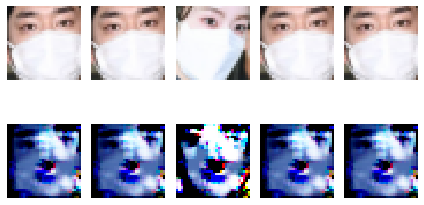

epoch = 4332/5000, d_loss=0.003, g_loss=0.029                                                                                                                   
epoch = 4333/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 4334/5000, d_loss=0.002, g_loss=0.012                                                                                                                   
epoch = 4335/5000, d_loss=0.004, g_loss=0.008                                                                                                                   
epoch = 4336/5000, d_loss=0.001, g_loss=0.006                                                                                                                   
epoch = 4337/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 4338/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4341/5000, d_loss=0.000, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


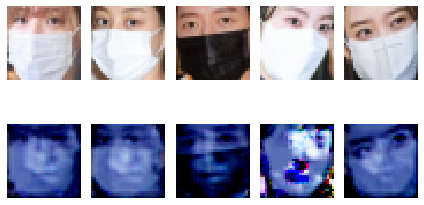

epoch = 4342/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 4343/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4344/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4345/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4346/5000, d_loss=0.000, g_loss=0.004                                                                                                                   
epoch = 4347/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4348/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4351/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


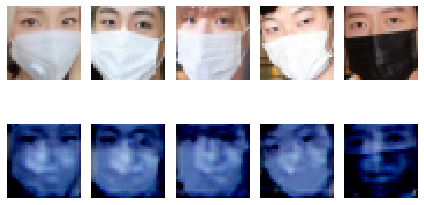

epoch = 4352/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4353/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4354/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4355/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4356/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4357/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4358/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4361/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


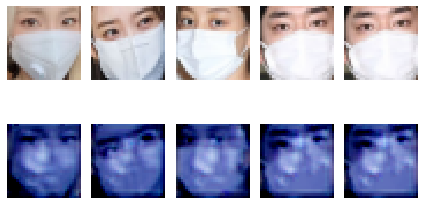

epoch = 4362/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4363/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4364/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4365/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4366/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4367/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4368/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4371/5000, d_loss=0.000, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


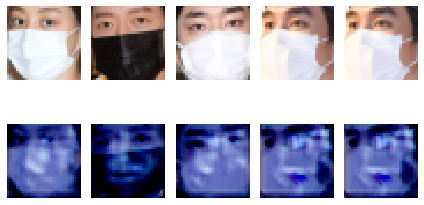

epoch = 4372/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4373/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4374/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4375/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4376/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 4377/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4378/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4381/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


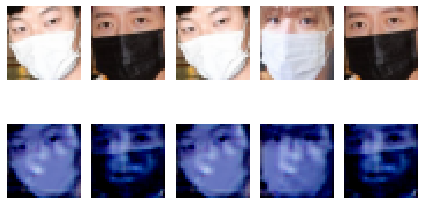

epoch = 4382/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4383/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4384/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4385/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4386/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4387/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4388/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4391/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


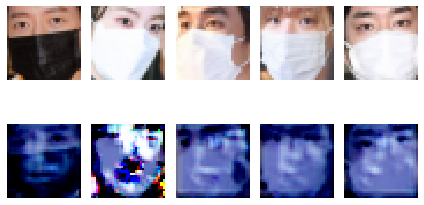

epoch = 4392/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4393/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4394/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4395/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4396/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4397/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4398/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4401/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


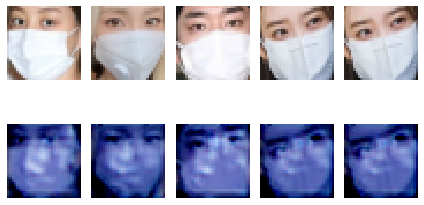

epoch = 4402/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4403/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4404/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4405/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4406/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4407/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4408/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4411/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


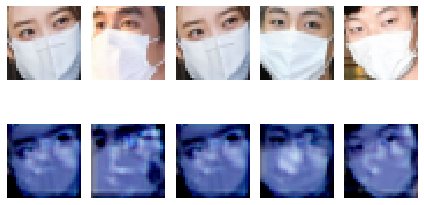

epoch = 4412/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4413/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4414/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4415/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4416/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4417/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4418/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4421/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


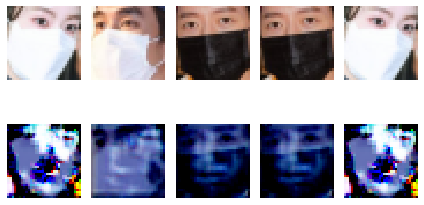

epoch = 4422/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4423/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4424/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4425/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4426/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4427/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4428/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4431/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


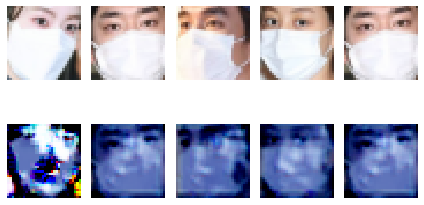

epoch = 4432/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4433/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4434/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4435/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4436/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4437/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4438/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4441/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


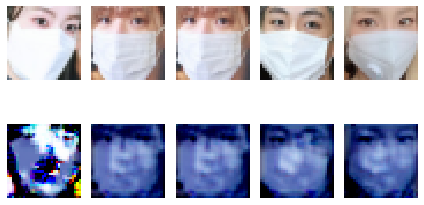

epoch = 4442/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4443/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4444/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4445/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4446/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4447/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4448/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4451/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


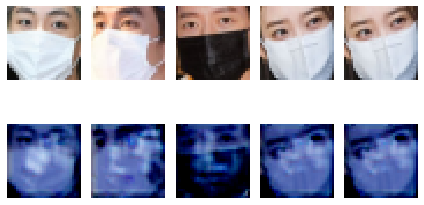

epoch = 4452/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4453/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4454/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4455/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4456/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4457/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4458/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4461/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


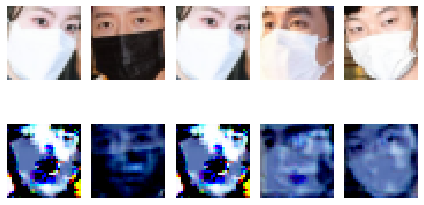

epoch = 4462/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4463/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4464/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4465/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4466/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4467/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4468/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4471/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


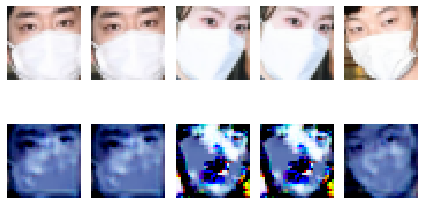

epoch = 4472/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4473/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4474/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4475/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4476/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4477/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4478/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4481/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


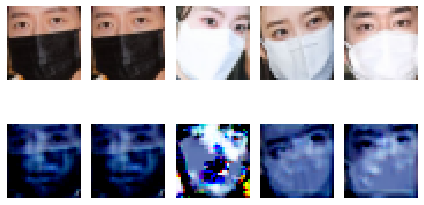

epoch = 4482/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4483/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4484/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4485/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4486/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4487/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4488/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4491/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


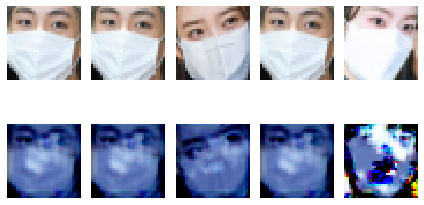

epoch = 4492/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4493/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4494/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4495/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4496/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4497/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4498/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4501/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


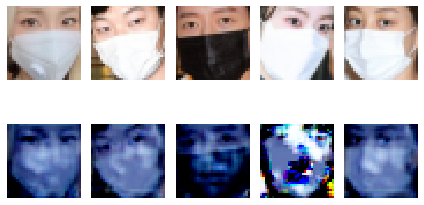

epoch = 4502/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4503/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 4504/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4505/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4506/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4507/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4508/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4511/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


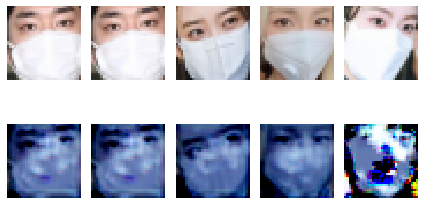

epoch = 4512/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4513/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4514/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4515/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4516/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4517/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4518/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4521/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


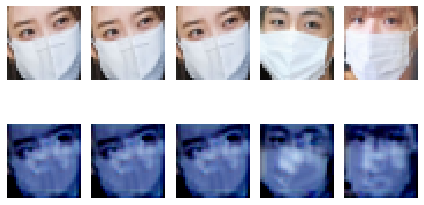

epoch = 4522/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4523/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4524/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4525/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4526/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4527/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4528/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4531/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


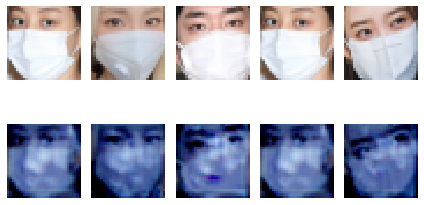

epoch = 4532/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4533/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4534/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 4535/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 4536/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4537/5000, d_loss=0.007, g_loss=0.015                                                                                                                   
epoch = 4538/5000, d_loss=0.025, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4541/5000, d_loss=0.007, g_loss=0.026                                                                                                     


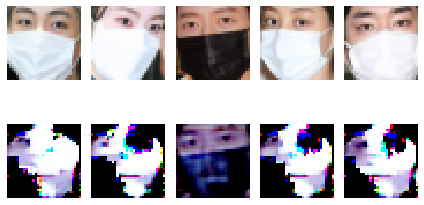

epoch = 4542/5000, d_loss=0.004, g_loss=0.018                                                                                                                   
epoch = 4543/5000, d_loss=0.007, g_loss=0.018                                                                                                                   
epoch = 4544/5000, d_loss=0.003, g_loss=0.014                                                                                                                   
epoch = 4545/5000, d_loss=0.005, g_loss=0.019                                                                                                                   
epoch = 4546/5000, d_loss=0.003, g_loss=0.025                                                                                                                   
epoch = 4547/5000, d_loss=0.003, g_loss=0.020                                                                                                                   
epoch = 4548/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4551/5000, d_loss=0.002, g_loss=0.015                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


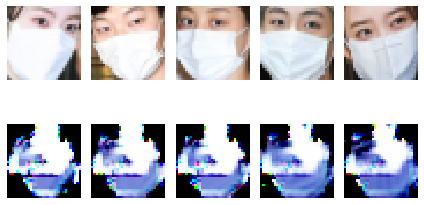

epoch = 4552/5000, d_loss=0.003, g_loss=0.018                                                                                                                   
epoch = 4553/5000, d_loss=0.003, g_loss=0.014                                                                                                                   
epoch = 4554/5000, d_loss=0.005, g_loss=0.014                                                                                                                   
epoch = 4555/5000, d_loss=0.004, g_loss=0.013                                                                                                                   
epoch = 4556/5000, d_loss=0.002, g_loss=0.011                                                                                                                   
epoch = 4557/5000, d_loss=0.002, g_loss=0.015                                                                                                                   
epoch = 4558/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4561/5000, d_loss=0.002, g_loss=0.010                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


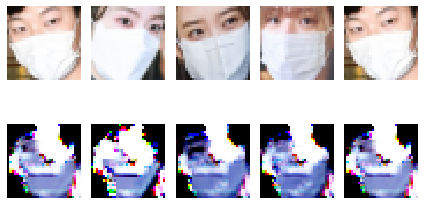

epoch = 4562/5000, d_loss=0.001, g_loss=0.009                                                                                                                   
epoch = 4563/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 4564/5000, d_loss=0.001, g_loss=0.008                                                                                                                   
epoch = 4565/5000, d_loss=0.005, g_loss=0.009                                                                                                                   
epoch = 4566/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 4567/5000, d_loss=0.001, g_loss=0.007                                                                                                                   
epoch = 4568/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4571/5000, d_loss=0.001, g_loss=0.006                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


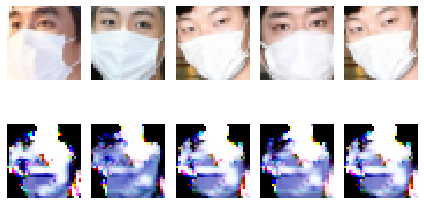

epoch = 4572/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 4573/5000, d_loss=0.002, g_loss=0.009                                                                                                                   
epoch = 4574/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 4575/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 4576/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 4577/5000, d_loss=0.002, g_loss=0.007                                                                                                                   
epoch = 4578/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4581/5000, d_loss=0.001, g_loss=0.004                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


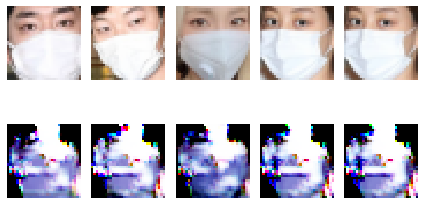

epoch = 4582/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 4583/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 4584/5000, d_loss=0.004, g_loss=0.007                                                                                                                   
epoch = 4585/5000, d_loss=0.001, g_loss=0.005                                                                                                                   
epoch = 4586/5000, d_loss=0.001, g_loss=0.004                                                                                                                   
epoch = 4587/5000, d_loss=0.002, g_loss=0.005                                                                                                                   
epoch = 4588/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4591/5000, d_loss=0.000, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


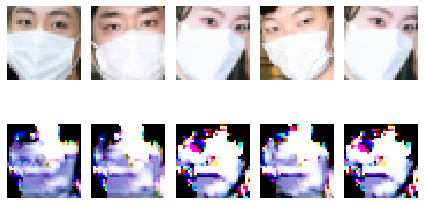

epoch = 4592/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4593/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4594/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4595/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4596/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4597/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 4598/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4601/5000, d_loss=0.003, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


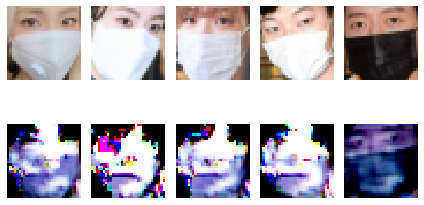

epoch = 4602/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 4603/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 4604/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 4605/5000, d_loss=0.000, g_loss=0.003                                                                                                                   
epoch = 4606/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 4607/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 4608/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4611/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


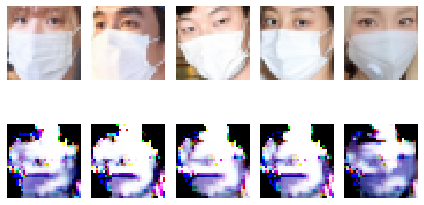

epoch = 4612/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 4613/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 4614/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 4615/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 4616/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4617/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4618/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4621/5000, d_loss=0.001, g_loss=0.003                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


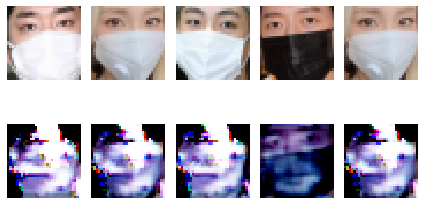

epoch = 4622/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 4623/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 4624/5000, d_loss=0.006, g_loss=0.006                                                                                                                   
epoch = 4625/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 4626/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4627/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4628/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4631/5000, d_loss=0.002, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


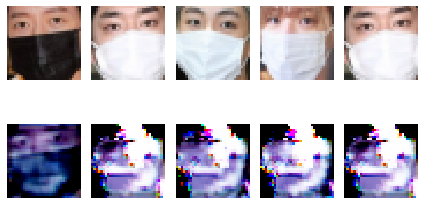

epoch = 4632/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4633/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4634/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4635/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4636/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4637/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4638/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4641/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


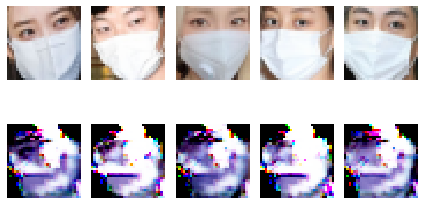

epoch = 4642/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4643/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4644/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4645/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4646/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4647/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4648/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4651/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


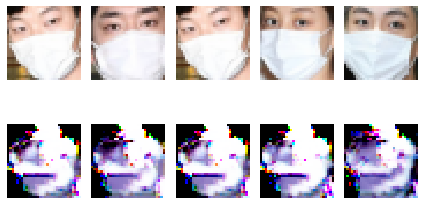

epoch = 4652/5000, d_loss=0.000, g_loss=0.002                                                                                                                   
epoch = 4653/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4654/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 4655/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4656/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4657/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4658/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4661/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


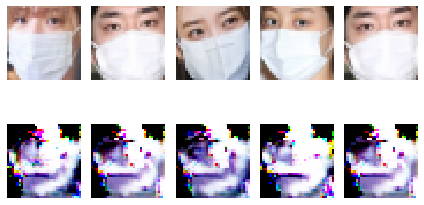

epoch = 4662/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 4663/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 4664/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4665/5000, d_loss=0.001, g_loss=0.003                                                                                                                   
epoch = 4666/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4667/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4668/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4671/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


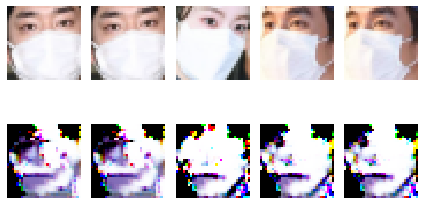

epoch = 4672/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4673/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 4674/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4675/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4676/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4677/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4678/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4681/5000, d_loss=0.003, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


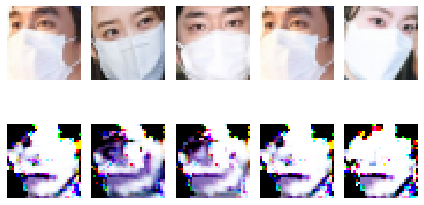

epoch = 4682/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 4683/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4684/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4685/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4686/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4687/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4688/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4691/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


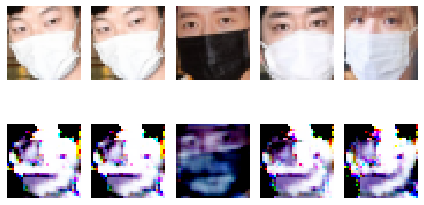

epoch = 4692/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4693/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4694/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4695/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4696/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4697/5000, d_loss=0.004, g_loss=0.004                                                                                                                   
epoch = 4698/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4701/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


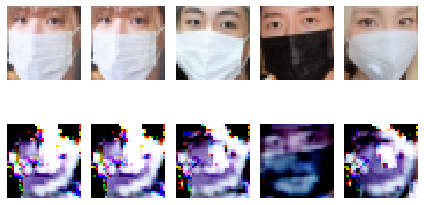

epoch = 4702/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4703/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4704/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4705/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4706/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4707/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4708/5000, d_loss=0.003, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4711/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


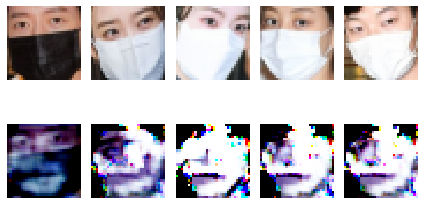

epoch = 4712/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4713/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4714/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4715/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4716/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4717/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4718/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4721/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


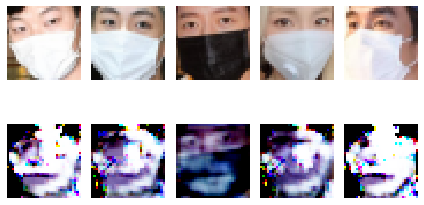

epoch = 4722/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4723/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4724/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4725/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4726/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4727/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4728/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4731/5000, d_loss=0.001, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


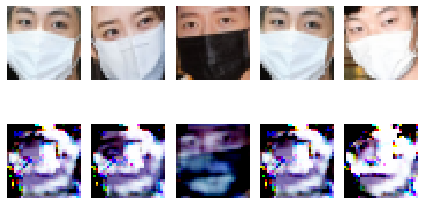

epoch = 4732/5000, d_loss=0.003, g_loss=0.002                                                                                                                   
epoch = 4733/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 4734/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4735/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 4736/5000, d_loss=0.002, g_loss=0.002                                                                                                                   
epoch = 4737/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4738/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4741/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


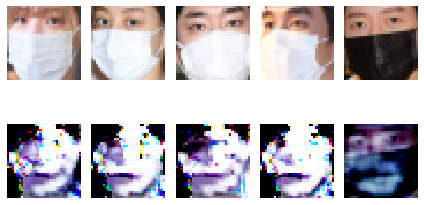

epoch = 4742/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 4743/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4744/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4745/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4746/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4747/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4748/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4751/5000, d_loss=0.001, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


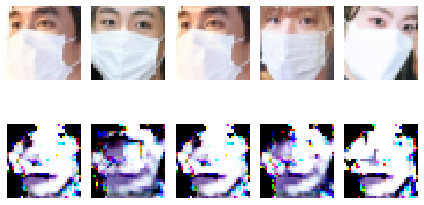

epoch = 4752/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4753/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 4754/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4755/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4756/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 4757/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4758/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4761/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


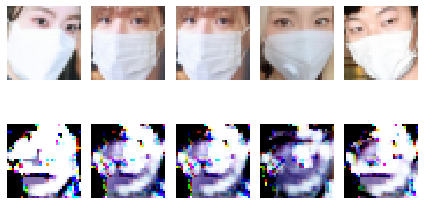

epoch = 4762/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4763/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4764/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4765/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4766/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4767/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4768/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4771/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


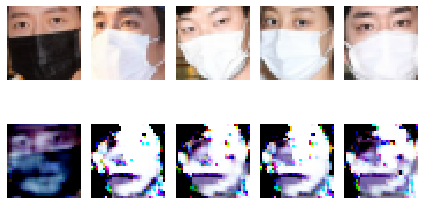

epoch = 4772/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4773/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4774/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4775/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 4776/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4777/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4778/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4781/5000, d_loss=0.000, g_loss=0.000                                                                                                     


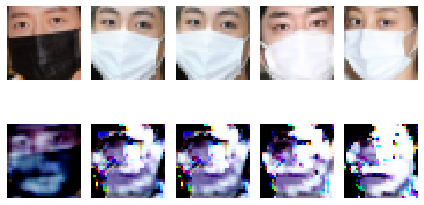

epoch = 4782/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4783/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4784/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4785/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4786/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 4787/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4788/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4791/5000, d_loss=0.001, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


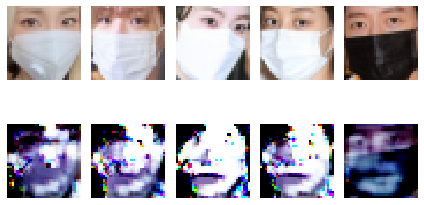

epoch = 4792/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4793/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 4794/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4795/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4796/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4797/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4798/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4801/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


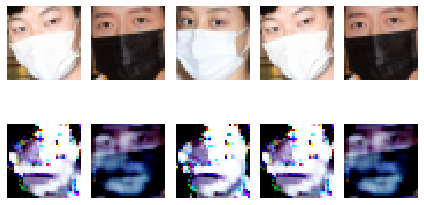

epoch = 4802/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4803/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4804/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4805/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4806/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4807/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4808/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4811/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


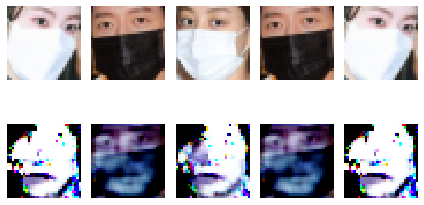

epoch = 4812/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4813/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4814/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4815/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4816/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4817/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4818/5000, d_loss=0.004, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4821/5000, d_loss=0.003, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


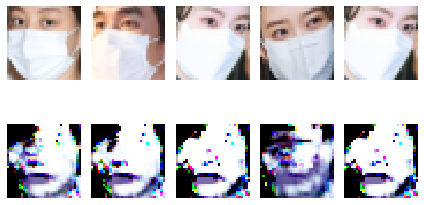

epoch = 4822/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4823/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4824/5000, d_loss=0.002, g_loss=0.001                                                                                                                   
epoch = 4825/5000, d_loss=0.004, g_loss=0.002                                                                                                                   
epoch = 4826/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 4827/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4828/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4831/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


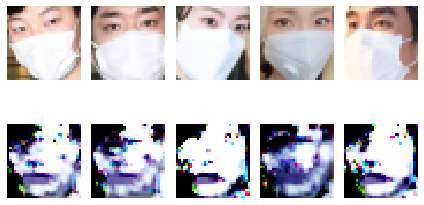

epoch = 4832/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4833/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4834/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4835/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4836/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4837/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4838/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4841/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


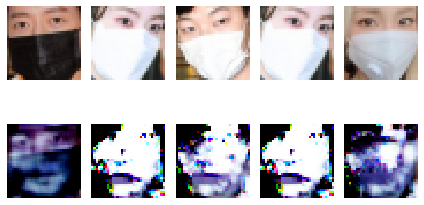

epoch = 4842/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4843/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4844/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4845/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4846/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 4847/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4848/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4851/5000, d_loss=0.000, g_loss=0.000                                                                                                     


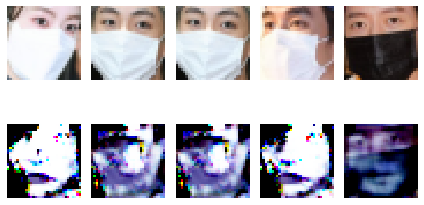

epoch = 4852/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4853/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4854/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4855/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4856/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4857/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4858/5000, d_loss=0.002, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4861/5000, d_loss=0.003, g_loss=0.002                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


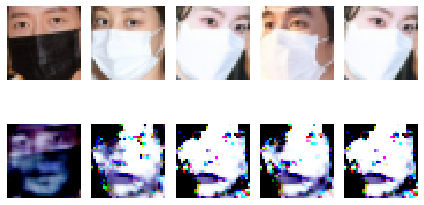

epoch = 4862/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4863/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4864/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 4865/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4866/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4867/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4868/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4871/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


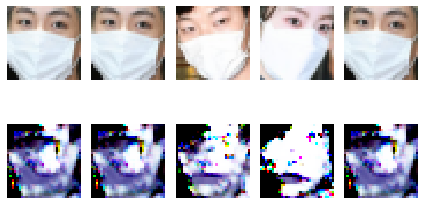

epoch = 4872/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4873/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4874/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4875/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4876/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4877/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4878/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4881/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


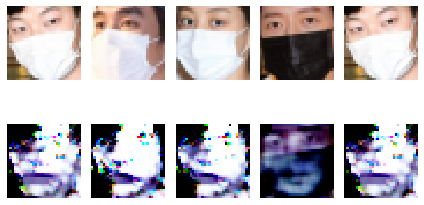

epoch = 4882/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4883/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4884/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4885/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4886/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4887/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4888/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4891/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


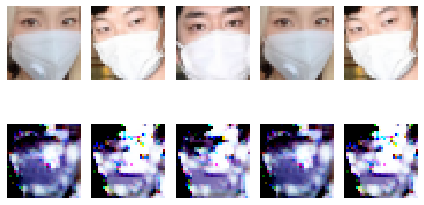

epoch = 4892/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4893/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 4894/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4895/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4896/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4897/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4898/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4901/5000, d_loss=0.001, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


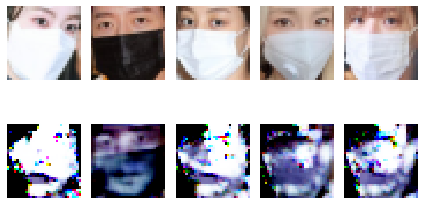

epoch = 4902/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 4903/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4904/5000, d_loss=0.003, g_loss=0.003                                                                                                                   
epoch = 4905/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4906/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4907/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 4908/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4911/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


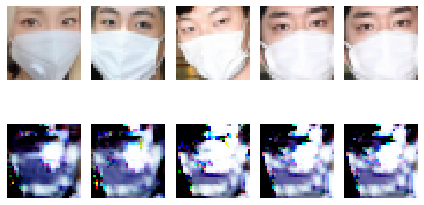

epoch = 4912/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4913/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4914/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4915/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4916/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4917/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4918/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4921/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


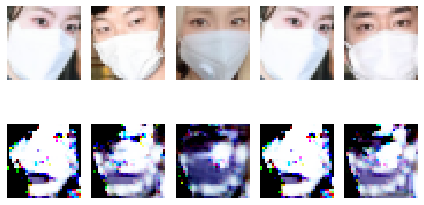

epoch = 4922/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4923/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4924/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4925/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4926/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4927/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4928/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4931/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


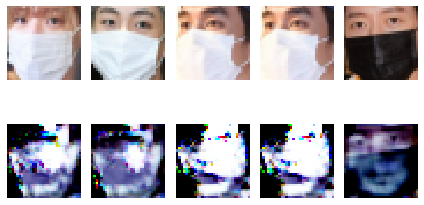

epoch = 4932/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4933/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4934/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4935/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4936/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4937/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4938/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4941/5000, d_loss=0.000, g_loss=0.000                                                                                                     


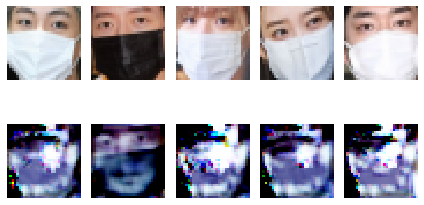

epoch = 4942/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4943/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4944/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 4945/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4946/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4947/5000, d_loss=0.001, g_loss=0.002                                                                                                                   
epoch = 4948/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4951/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


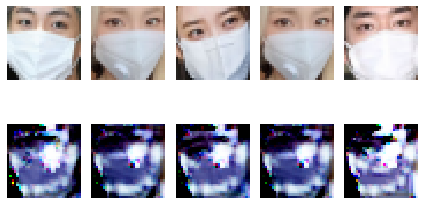

epoch = 4952/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4953/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4954/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4955/5000, d_loss=0.000, g_loss=0.001                                                                                                                   
epoch = 4956/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4957/5000, d_loss=0.002, g_loss=0.004                                                                                                                   
epoch = 4958/5000, d_loss=0.001, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4961/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


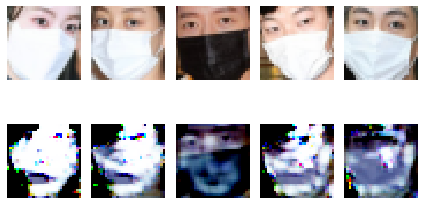

epoch = 4962/5000, d_loss=0.001, g_loss=0.001                                                                                                                   
epoch = 4963/5000, d_loss=0.002, g_loss=0.003                                                                                                                   
epoch = 4964/5000, d_loss=0.001, g_loss=0.000                                                                                                                   
epoch = 4965/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4966/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4967/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4968/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4971/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


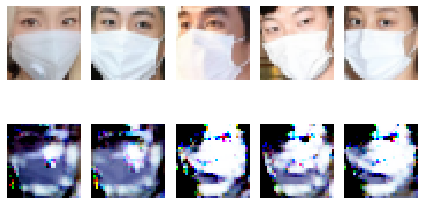

epoch = 4972/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4973/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4974/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4975/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4976/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4977/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4978/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4981/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


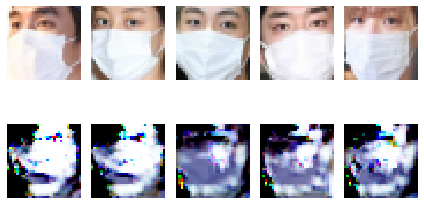

epoch = 4982/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4983/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4984/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4985/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4986/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4987/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4988/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 4991/5000, d_loss=0.000, g_loss=0.000                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


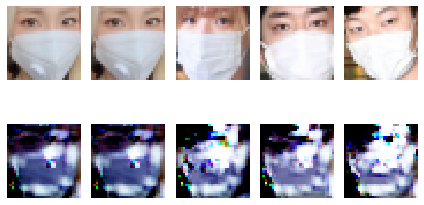

epoch = 4992/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4993/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4994/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4995/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4996/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4997/5000, d_loss=0.000, g_loss=0.000                                                                                                                   
epoch = 4998/5000, d_loss=0.000, g

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


epoch = 5001/5000, d_loss=0.000, g_loss=0.001                                                                                                     


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


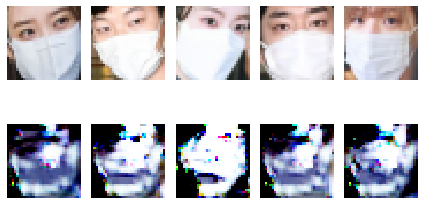

In [44]:
import tensorflow as tf

epochs = 5000
batch_size = 30
smooth = 0.1

real = np.ones((batch_size, 4, 4, 1))
real = real * (1 - smooth)
fake = np.zeros((batch_size, 4, 4, 1))

fake_labels = to_categorical(np.full((batch_size, 1), num_classes), num_classes=num_classes+1)

d_loss = []
d_g_loss = []

for e in range(epochs + 1):
    count = 0
    for i in range(len(X_train) // batch_size):
        
        # Train Discriminator weights
        discriminator.trainable = True
        
        # Real samples
        img_real = X_train[i*batch_size:(i+1)*batch_size]
        real_labels = y_train[i*batch_size:(i+1)*batch_size]
        
        d_loss_real = discriminator.train_on_batch(x=img_real, y=[real, real_labels])
        
        # Fake Samples
        masked_imgs = mask_randomly(img_real, real_labels)
        gen_imgs = generator.predict(masked_imgs)
        
        count += 1
        
        if e % 100 == 0:
            masked_img = gen_imgs[batch_size-1].reshape(32, 32, 3)
            masked_img = cv2.convertScaleAbs(masked_img, alpha=(255.0))
            cv2.imwrite('../CCGAN/result/mask{0}_{1}.jpg'.format(count, e), masked_img)
            
        
        d_loss_fake = discriminator.train_on_batch(x=gen_imgs, y=[fake, fake_labels])
         
        # Discriminator loss
        d_loss_batch = 0.5 * (d_loss_real[0] + d_loss_fake[0])
        
        # Train Generator weights
        discriminator.trainable = False

        d_g_loss_batch = d_g.train_on_batch(x=img_real, y=real)
   
        print(
            'epoch = %d/%d, batch = %d/%d, d_loss=%.3f, g_loss=%.3f' % (e + 1, epochs, i, len(X_train) // batch_size, d_loss_batch, d_g_loss_batch[0]),
            100*' ',
            end='\r'
        )
    
    d_loss.append(d_loss_batch)
    d_g_loss.append(d_g_loss_batch[0])
    print('epoch = %d/%d, d_loss=%.3f, g_loss=%.3f' % (e + 1, epochs, d_loss[-1], d_g_loss[-1]), 100*' ')

    if e % 10 == 0:            
        samples = 5
        idx = np.random.randint(0, X_train.shape[0], samples)
        masked_imgs = mask_randomly(X_train[idx], y_train[idx])
        x_fake = generator.predict(masked_imgs)
        

        for k in range(samples):
            # plot masked
            plt.subplot(2, 5, k+1)
            plt.axis("off")
            plt.imshow(masked_imgs[k].reshape(32, 32, 3))
            plt.xticks([])
            plt.yticks([])

            # plot recontructed
            plt.subplot(2, 5, k+6)
            plt.axis("off")
            plt.imshow(x_fake[k].reshape(32, 32, 3))
            plt.xticks([])
            plt.yticks([])

        plt.tight_layout()
        plt.show()

#### plt 때문에 파랗게 보이는 것! image save 하면 제대로 색깔이 보인다

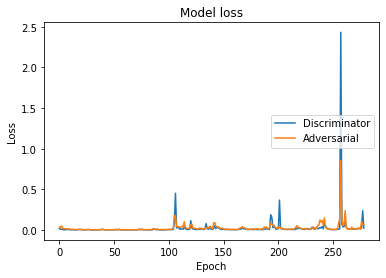

In [26]:
# plotting the metrics
plt.plot(d_loss)
plt.plot(d_g_loss)
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Discriminator', 'Adversarial'], loc='center right')
plt.show()